<h1> Amazon Apparel Recommendations </h1>



### [4.2] Data and Code:
https://drive.google.com/open?id=0BwNkduBnePt2VWhCYXhMV3p4dTg



### [4.3] Overview of the data

In [0]:
# !pip install tf-nightly-2.0-preview

In [1]:
#import all the necessary packages.

from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import warnings
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
import math
import time
import re
import os
import seaborn as sns
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity  
from sklearn.metrics import pairwise_distances
from matplotlib import gridspec
from scipy.sparse import hstack
import plotly
import plotly.figure_factory as ff
from plotly.graph_objs import Scatter, Layout

plotly.offline.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
# we have give a json file which consists of all information about
# the products
# loading the data using pandas' read_json file.
data = pd.read_json('/content/drive/My Drive/amazon_fashion/tops_fashion.json')


In [4]:
print ('Number of data points : ', data.shape[0], \
       'Number of features/variables:', data.shape[1])

Number of data points :  183138 Number of features/variables: 19


### Terminology:
What is a dataset? <br>
Rows and columns <br>
Data-point <br>
Feature/variable <br>







In [5]:
# each product/item has 19 features in the raw dataset.
data.columns # prints column-names or feature-names.

Index(['sku', 'asin', 'product_type_name', 'formatted_price', 'author',
       'color', 'brand', 'publisher', 'availability', 'reviews',
       'large_image_url', 'availability_type', 'small_image_url',
       'editorial_review', 'title', 'model', 'medium_image_url',
       'manufacturer', 'editorial_reivew'],
      dtype='object')

Of these 19 features, we will be using only 6 features in this workshop.
    1. asin  ( Amazon standard identification number)
    2. brand ( brand to which the product belongs to )
    3. color ( Color information of apparel, it can contain many colors as   a value ex: red and black stripes ) 
    4. product_type_name (type of the apperal, ex: SHIRT/TSHIRT )
    5. medium_image_url  ( url of the image )
    6. title (title of the product.)
    7. formatted_price (price of the product)

In [0]:
data = data[['asin', 'brand', 'color', 'medium_image_url', 'product_type_name', 'title', 'formatted_price']]

In [7]:
print ('Number of data points : ', data.shape[0], \
       'Number of features:', data.shape[1])
data.head() # prints the top rows in the table.

Number of data points :  183138 Number of features: 7


,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
0,B016I2TS4W,FNC7C,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,Minions Como Superheroes Ironman Long Sleeve R...,None
1,B01N49AI08,FIG Clothing,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,FIG Clothing Womens Izo Tunic,None
2,B01JDPCOHO,FIG Clothing,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,FIG Clothing Womens Won Top,None
3,B01N19U5H5,Focal18,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,Focal18 Sailor Collar Bubble Sleeve Blouse Shi...,None
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26


### [5.1] Missing data for various features.

####  Basic stats for the feature: product_type_name

In [8]:
# We have total 72 unique type of product_type_names
print(data['product_type_name'].describe())

# 91.62% (167794/183138) of the products are shirts,


count     183138
unique        72
top        SHIRT
freq      167794
Name: product_type_name, dtype: object


In [9]:
# names of different product types
print(data['product_type_name'].unique())

['SHIRT' 'SWEATER' 'APPAREL' 'OUTDOOR_RECREATION_PRODUCT'
 'BOOKS_1973_AND_LATER' 'PANTS' 'HAT' 'SPORTING_GOODS' 'DRESS' 'UNDERWEAR'
 'SKIRT' 'OUTERWEAR' 'BRA' 'ACCESSORY' 'ART_SUPPLIES' 'SLEEPWEAR'
 'ORCA_SHIRT' 'HANDBAG' 'PET_SUPPLIES' 'SHOES' 'KITCHEN' 'ADULT_COSTUME'
 'HOME_BED_AND_BATH' 'MISC_OTHER' 'BLAZER' 'HEALTH_PERSONAL_CARE'
 'TOYS_AND_GAMES' 'SWIMWEAR' 'CONSUMER_ELECTRONICS' 'SHORTS' 'HOME'
 'AUTO_PART' 'OFFICE_PRODUCTS' 'ETHNIC_WEAR' 'BEAUTY'
 'INSTRUMENT_PARTS_AND_ACCESSORIES' 'POWERSPORTS_PROTECTIVE_GEAR' 'SHIRTS'
 'ABIS_APPAREL' 'AUTO_ACCESSORY' 'NONAPPARELMISC' 'TOOLS' 'BABY_PRODUCT'
 'SOCKSHOSIERY' 'POWERSPORTS_RIDING_SHIRT' 'EYEWEAR' 'SUIT'
 'OUTDOOR_LIVING' 'POWERSPORTS_RIDING_JACKET' 'HARDWARE' 'SAFETY_SUPPLY'
 'ABIS_DVD' 'VIDEO_DVD' 'GOLF_CLUB' 'MUSIC_POPULAR_VINYL'
 'HOME_FURNITURE_AND_DECOR' 'TABLET_COMPUTER' 'GUILD_ACCESSORIES'
 'ABIS_SPORTS' 'ART_AND_CRAFT_SUPPLY' 'BAG' 'MECHANICAL_COMPONENTS'
 'SOUND_AND_RECORDING_EQUIPMENT' 'COMPUTER_COMPONENT' 'JEWELRY'
 'B

In [10]:
# find the 10 most frequent product_type_names.
product_type_count = Counter(list(data['product_type_name']))
product_type_count.most_common(10)

[('SHIRT', 167794),
 ('APPAREL', 3549),
 ('BOOKS_1973_AND_LATER', 3336),
 ('DRESS', 1584),
 ('SPORTING_GOODS', 1281),
 ('SWEATER', 837),
 ('OUTERWEAR', 796),
 ('OUTDOOR_RECREATION_PRODUCT', 729),
 ('ACCESSORY', 636),
 ('UNDERWEAR', 425)]

####  Basic stats for the feature: brand

In [11]:
# there are 10577 unique brands
print(data['brand'].describe())

# 183138 - 182987 = 151 missing values.

count     182987
unique     10577
top         Zago
freq         223
Name: brand, dtype: object


In [12]:
brand_count = Counter(list(data['brand']))
brand_count.most_common(10)

[('Zago', 223),
 ('XQS', 222),
 ('Yayun', 215),
 ('YUNY', 198),
 ('XiaoTianXin-women clothes', 193),
 ('Generic', 192),
 ('Boohoo', 190),
 ('Alion', 188),
 ('Abetteric', 187),
 ('TheMogan', 187)]

####  Basic stats for the feature: color

In [13]:

print(data['color'].describe())


# we have 7380 unique colors
# 7.2% of products are black in color
# 64956 of 183138 products have brand information. That's approx 35.4%.

count     64956
unique     7380
top       Black
freq      13207
Name: color, dtype: object


In [14]:
color_count = Counter(list(data['color']))
color_count.most_common(10)

[(None, 118182),
 ('Black', 13207),
 ('White', 8616),
 ('Blue', 3570),
 ('Red', 2289),
 ('Pink', 1842),
 ('Grey', 1499),
 ('*', 1388),
 ('Green', 1258),
 ('Multi', 1203)]

####  Basic stats for the feature: formatted_price

In [15]:
 
print(data['formatted_price'].describe())

# Only 28,395 (15.5% of whole data) products with price information

count      28395
unique      3135
top       $19.99
freq         945
Name: formatted_price, dtype: object


In [16]:
price_count = Counter(list(data['formatted_price']))
price_count.most_common(10)

[(None, 154743),
 ('$19.99', 945),
 ('$9.99', 749),
 ('$9.50', 601),
 ('$14.99', 472),
 ('$7.50', 463),
 ('$24.99', 414),
 ('$29.99', 370),
 ('$8.99', 343),
 ('$9.01', 336)]

#### Basic stats for the feature: title


In [17]:
print(data['title'].describe())

# All of the products have a title. 
# Titles are fairly descriptive of what the product is. 
# We use titles extensively in this workshop 
# as they are short and informative.


count                                                183138
unique                                               175985
top       Nakoda Cotton Self Print Straight Kurti For Women
freq                                                     77
Name: title, dtype: object


In [0]:
data.to_pickle('/content/drive/My Drive/amazon_fashion/pickels/180k_apparel_data')

   We save data files at every major step in our processing in "pickle" files. If you are stuck anywhere (or) if some code takes too long to run on your laptop, you may use the pickle files we give you to speed things up.

In [20]:
# consider products which have price information
# data['formatted_price'].isnull() => gives the information 
#about the dataframe row's which have null values price == None|Null
data = data.loc[~data['formatted_price'].isnull()]
print('Number of data points After eliminating price=NULL :', data.shape[0])

Number of data points After eliminating price=NULL : 28395


In [0]:
# consider products which have color information
# data['color'].isnull() => gives the information about the dataframe row's which have null values price == None|Null
data =data.loc[~data['color'].isnull()]
print('Number of data points After eliminating color=NULL :', data.shape[0])

Number of data points After eliminating color=NULL : 28385


#### We brought down the number of data points from 183K  to 28K.

We are processing only 28K points so that most of the workshop participants can run this code on thier laptops in a reasonable amount of time. <br> 

For those of you who have powerful computers and some time to spare, you are recommended to use all of the 183K images.


In [0]:
data.to_pickle('/content/drive/My Drive/amazon_fashion/pickels/28k_apparel_data')

In [0]:
# You can download all these 28k images using this code below.
# You do NOT need to run this code and hence it is commented.

'''

from PIL import Image
import requests
from io import BytesIO

for index, row in images.iterrows():
        url = row['large_image_url']
        response = requests.get(url)
        img = Image.open(BytesIO(response.content))
        img.save('/content/drive/My Drive/amazon_fashion/img'+row['asin']+'.jpeg')

'''


"\n\nfrom PIL import Image\nimport requests\nfrom io import BytesIO\n\nfor index, row in images.iterrows():\n        url = row['large_image_url']\n        response = requests.get(url)\n        img = Image.open(BytesIO(response.content))\n        img.save('/content/drive/My Drive/amazon_fashion/img'+row['asin']+'.jpeg')\n\n"

### [5.2] Remove near duplicate items

#### [5.2.1] Understand about duplicates.

In [0]:
# read data from pickle file from previous stage
data = pd.read_pickle('/content/drive/My Drive/amazon_fashion/pickels/28k_apparel_data')

# find number of products that have duplicate titles.
print(sum(data.duplicated('title')))
# we have 2325 products which have same title but different color


2325


#### These shirts are exactly same except in size (S, M,L,XL)

<table>
<tr> 
<td><img src="/content/drive/My Drive/amazon_fashion/dedupe/B00AQ4GMCK.jpeg",width=100,height=100> :B00AQ4GMCK</td>
<td><img src="dedupe/B00AQ4GMTS.jpeg",width=100,height=100> :B00AQ4GMTS</td>
</tr>
<tr> 
<td><img src="dedupe/B00AQ4GMLQ.jpeg",width=100,height=100> :B00AQ4GMLQ</td>
<td><img src="dedupe/B00AQ4GN3I.jpeg",width=100,height=100> :B00AQ4GN3I</td>
</tr>
</table>

#### These shirts exactly same except  in color

<table>
<tr> 
<td><img src="dedupe/B00G278GZ6.jpeg",width=100,height=100> :B00G278GZ6</td>
<td><img src="dedupe/B00G278W6O.jpeg",width=100,height=100> :B00G278W6O</td>
</tr>
<tr> 
<td><img src="dedupe/B00G278Z2A.jpeg",width=100,height=100> :B00G278Z2A</td>
<td><img src="dedupe/B00G2786X8.jpeg",width=100,height=100> :B00G2786X8</td>
</tr>
</table>

#### In our data there are many duplicate products like the above examples, we need to de-dupe them for better results.


#### [5.2.2] Remove duplicates : Part 1

In [0]:
# read data from pickle file from previous stage
data = pd.read_pickle('/content/drive/My Drive/amazon_fashion/pickels/28k_apparel_data')

In [0]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,Women's Unique 100% Cotton T - Special Olympic...,$9.99
11,B001LOUGE4,Fitness Etc.,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,Ladies Cotton Tank 2x1 Ribbed Tank Top,$11.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,FeatherLite Ladies' Moisture Free Mesh Sport S...,$20.54
21,B014ICEDNA,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,Supernatural Chibis Sam Dean And Castiel Short...,$7.50


In [0]:
# Remove All products with very few words in title
data_sorted = data[data['title'].apply(lambda x: len(x.split())>4)]
print("After removal of products with short description:", data_sorted.shape[0])

After removal of products with short description: 27949


In [0]:
# Sort the whole data based on title (alphabetical order of title) 
data_sorted.sort_values('title',inplace=True, ascending=False)
data_sorted.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
61973,B06Y1KZ2WB,Éclair,Black/Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,Éclair Women's Printed Thin Strap Blouse Black...,$24.99
133820,B010RV33VE,xiaoming,Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Womens Sleeveless Loose Long T-shirts...,$18.19
81461,B01DDSDLNS,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Women's White Long Sleeve Single Brea...,$21.58
75995,B00X5LYO9Y,xiaoming,Red Anchors,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Stripes Tank Patch/Bear Sleeve Anchor...,$15.91
151570,B00WPJG35K,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Sleeve Sheer Loose Tassel Kimono Woma...,$14.32


#### Some examples of dupliacte titles that differ only in the last few words.

<pre>
Titles 1:
16. woman's place is in the house and the senate shirts for Womens XXL White
17. woman's place is in the house and the senate shirts for Womens M Grey

Title 2:
25. tokidoki The Queen of Diamonds Women's Shirt X-Large
26. tokidoki The Queen of Diamonds Women's Shirt Small
27. tokidoki The Queen of Diamonds Women's Shirt Large

Title 3:
61. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
62. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
63. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
64. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
</pre>

In [0]:
indices = []
for i,row in data_sorted.iterrows():
    indices.append(i)

In [0]:
import itertools
stage1_dedupe_asins = []
i = 0
j = 0
num_data_points = data_sorted.shape[0]
while i < num_data_points and j < num_data_points:
    
    previous_i = i

    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    a = data['title'].loc[indices[i]].split()

    # search for the similar products sequentially 
    j = i+1
    while j < num_data_points:

        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'Small']
        b = data['title'].loc[indices[j]].split()

        # store the maximum length of two strings
        length = max(len(a), len(b))

        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0] == k[1]):
                count += 1

        # if the number of words in which both strings differ are > 2 , we are considering it as those two apperals are different
        # if the number of words in which both strings differ are < 2 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) > 2: # number of words in which both sensences differ
            # if both strings are differ by more than 2 words we include the 1st string index
            stage1_dedupe_asins.append(data_sorted['asin'].loc[indices[i]])


            # start searching for similar apperals corresponds 2nd string
            i = j
            break
        else:
            j += 1
    if previous_i == i:
        break

In [0]:
data = data.loc[data['asin'].isin(stage1_dedupe_asins)]

#### We removed  the dupliactes which differ only at the end.

In [0]:
print('Number of data points : ', data.shape[0])

Number of data points :  17592


In [0]:
data.to_pickle('/content/drive/My Drive/amazon_fashion/pickels/17k_apperal_data')

#### [5.2.3] Remove duplicates : Part 2

<pre>

In the previous cell, we sorted whole data in alphabetical order of  titles.Then, we removed titles which are adjacent and very similar title

But there are some products whose titles are not adjacent but very similar.

Examples:

Titles-1
86261.  UltraClub Women's Classic Wrinkle-Free Long Sleeve Oxford Shirt, Pink, XX-Large
115042. UltraClub Ladies Classic Wrinkle-Free Long-Sleeve Oxford Light Blue XXL

TItles-2
75004.  EVALY Women's Cool University Of UTAH 3/4 Sleeve Raglan Tee
109225. EVALY Women's Unique University Of UTAH 3/4 Sleeve Raglan Tees
120832. EVALY Women's New University Of UTAH 3/4-Sleeve Raglan Tshirt

</pre>

In [0]:
data = pd.read_pickle('/content/drive/My Drive/amazon_fashion/pickels/17k_apperal_data')

In [0]:
# This code snippet takes significant amount of time.
# O(n^2) time.
# Takes about an hour to run on a decent computer.

indices = []
for i,row in data.iterrows():
    indices.append(i)

stage2_dedupe_asins = []
while len(indices)!=0:
    i = indices.pop()
    stage2_dedupe_asins.append(data['asin'].loc[i])
    # consider the first apperal's title
    a = data['title'].loc[i].split()
    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    for j in indices:
        
        b = data['title'].loc[j].split()
        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
        
        length = max(len(a),len(b))
        
        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0]==k[1]):
                count += 1

        # if the number of words in which both strings differ are < 3 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) < 3:
            indices.remove(j)

In [0]:
# from whole previous products we will consider only 
# the products that are found in previous cell 
data = data.loc[data['asin'].isin(stage2_dedupe_asins)]

In [0]:
print('Number of data points after stage two of dedupe: ',data.shape[0])
# from 17k apperals we reduced to 16k apperals

In [0]:
data.to_pickle('/content/drive/My Drive/amazon_fashion/pickels/16k_apperal_data')
# Storing these products in a pickle file
# candidates who wants to download these files instead 
# of 180K they can download and use them from the Google Drive folder.

# 6. Text pre-processing

In [0]:
data = pd.read_pickle('/content/drive/My Drive/amazon_fashion/pickels/16k_apperal_data')

# NLTK download stop words. [RUN ONLY ONCE]
# goto Terminal (Linux/Mac) or Command-Prompt (Window) 
# In the temrinal, type these commands
# $python3
# $import nltk
# $nltk.download()

In [0]:
# we use the list of stop words that are downloaded from nltk lib.
stop_words = set(stopwords.words('english'))
print ('list of stop words:', stop_words)

def nlp_preprocessing(total_text, index, column):
    if type(total_text) is not int:
        string = ""
        for words in total_text.split():
            # remove the special chars in review like '"#$@!%^&*()_+-~?>< etc.
            word = ("".join(e for e in words if e.isalnum()))
            # Conver all letters to lower-case
            word = word.lower()
            # stop-word removal
            if not word in stop_words:
                string += word + " "
        data[column][index] = string

In [0]:
start_time = time.clock()
# we take each title and we text-preprocess it.
for index, row in data.iterrows():
    nlp_preprocessing(row['title'], index, 'title')
# we print the time it took to preprocess whole titles 
print(time.clock() - start_time, "seconds")

In [0]:
data.head()

In [0]:
data.to_pickle('/content/drive/My Drive/amazon_fashion/pickels/16k_apperal_data_preprocessed')

## Stemming 

In [0]:
from nltk.stem.porter import *
stemmer = PorterStemmer()
print(stemmer.stem('arguing'))
print(stemmer.stem('fishing'))


# We tried using stemming on our titles and it didnot work very well. 


# [8] Text based product similarity

In [21]:
data = pd.read_pickle('/content/drive/My Drive/amazon_fashion/pickels/16k_apperal_data_preprocessed')
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies long sleeve stain resistant...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens unique 100 cotton special olympics wor...,$9.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies moisture free mesh sport sh...,$20.54
27,B014ICEJ1Q,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,supernatural chibis sam dean castiel neck tshi...,$7.39
46,B01NACPBG2,Fifth Degree,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,fifth degree womens gold foil graphic tees jun...,$6.95


In [0]:
# Utility Functions which we will use through the rest of the workshop.

import PIL.Image
#Display an image
def display_img(url,ax,fig):
    # we get the url of the apparel and download it
    response = requests.get(url)
    img = PIL.Image.open(BytesIO(response.content))
    # we will display it in notebook 
    plt.imshow(img)
  
#plotting code to understand the algorithm's decision.
def plot_heatmap(keys, values, labels, url, text):
        # keys: list of words of recommended title
        # values: len(values) ==  len(keys), values(i) represents the occurence of the word keys(i)
        # labels: len(labels) == len(keys), the values of labels depends on the model we are using
                # if model == 'bag of words': labels(i) = values(i)
                # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
                # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))
        # url : apparel's url

        # we will devide the whole figure into two parts
        gs = gridspec.GridSpec(2, 2, width_ratios=[4,1], height_ratios=[4,1]) 
        fig = plt.figure(figsize=(25,3))
        
        # 1st, ploting heat map that represents the count of commonly ocurred words in title2
        ax = plt.subplot(gs[0])
        # it displays a cell in white color if the word is intersection(lis of words of title1 and list of words of title2), in black if not
        ax = sns.heatmap(np.array([values]), annot=np.array([labels]))
        ax.set_xticklabels(keys) # set that axis labels as the words of title
        ax.set_title(text) # apparel title
        
        # 2nd, plotting image of the the apparel
        ax = plt.subplot(gs[1])
        # we don't want any grid lines for image and no labels on x-axis and y-axis
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        
        # we call dispaly_img based with paramete url
        display_img(url, ax, fig)
        
        # displays combine figure ( heat map and image together)
        plt.show()
    
def plot_heatmap_image(doc_id, vec1, vec2, url, text, model):

    # doc_id : index of the title1
    # vec1 : input apparels's vector, it is of a dict type {word:count}
    # vec2 : recommended apparels's vector, it is of a dict type {word:count}
    # url : apparels image url
    # text: title of recomonded apparel (used to keep title of image)
    # model, it can be any of the models, 
        # 1. bag_of_words
        # 2. tfidf
        # 3. idf

    # we find the common words in both titles, because these only words contribute to the distance between two title vec's
    intersection = set(vec1.keys()) & set(vec2.keys()) 

    # we set the values of non intersecting words to zero, this is just to show the difference in heatmap
    for i in vec2:
        if i not in intersection:
            vec2[i]=0

    # for labeling heatmap, keys contains list of all words in title2
    keys = list(vec2.keys())
    #  if ith word in intersection(lis of words of title1 and list of words of title2): values(i)=count of that word in title2 else values(i)=0 
    values = [vec2[x] for x in vec2.keys()]
    
    # labels: len(labels) == len(keys), the values of labels depends on the model we are using
        # if model == 'bag of words': labels(i) = values(i)
        # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
        # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))

    if model == 'bag_of_words':
        labels = values
    elif model == 'tfidf':
        labels = []
        for x in vec2.keys():
            # tfidf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # tfidf_title_features[doc_id, index_of_word_in_corpus] will give the tfidf value of word in given document (doc_id)
            if x in  tfidf_title_vectorizer.vocabulary_:
                labels.append(tfidf_title_features[doc_id, tfidf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)
    elif model == 'idf':
        labels = []
        for x in vec2.keys():
            # idf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # idf_title_features[doc_id, index_of_word_in_corpus] will give the idf value of word in given document (doc_id)
            if x in  idf_title_vectorizer.vocabulary_:
                labels.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)

    plot_heatmap(keys, values, labels, url, text)


# this function gets a list of wrods along with the frequency of each 
# word given "text"
def text_to_vector(text):
    word = re.compile(r'\w+')
    words = word.findall(text)
    # words stores list of all words in given string, you can try 'words = text.split()' this will also gives same result
    return Counter(words) # Counter counts the occurence of each word in list, it returns dict type object {word1:count}



def get_result(doc_id, content_a, content_b, url, model):
    text1 = content_a
    text2 = content_b
    
    # vector1 = dict{word11:#count, word12:#count, etc.}
    vector1 = text_to_vector(text1)

    # vector1 = dict{word21:#count, word22:#count, etc.}
    vector2 = text_to_vector(text2)

    plot_heatmap_image(doc_id, vector1, vector2, url, text2, model)

## [8.2] Bag of Words (BoW) on product titles.

In [0]:
from sklearn.feature_extraction.text import CountVectorizer
title_vectorizer = CountVectorizer()
title_features   = title_vectorizer.fit_transform(data['title'])
title_features.get_shape() # get number of rows and columns in feature matrix.
# title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(corpus) returns 
# the a sparase matrix of dimensions #data_points * #words_in_corpus

# What is a sparse vector?

# title_features[doc_id, index_of_word_in_corpus] = number of times the word occured in that doc



In [0]:
def bag_of_words_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(title_features,title_features[doc_id])
    
    # np.argsort will return indices of the smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0,len(indices)):
        # we will pass 1. doc_id, 2. title1, 3. title2, url, model
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'bag_of_words')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print ('Brand:', data['brand'].loc[df_indices[i]])
        print ('Title:', data['title'].loc[df_indices[i]])
        print ('Euclidean similarity with the query image :', pdists[i])
        print('='*60)

#call the bag-of-words model for a product to get similar products.
bag_of_words_model(12566, 20) # change the index if you want to.
# In the output heat map each value represents the count value 
# of the label word, the color represents the intersection 
# with inputs title.

#try 12566
#try 931

## [8.5] TF-IDF based product similarity

In [0]:
tfidf_title_vectorizer = TfidfVectorizer(min_df = 0)
tfidf_title_features = tfidf_title_vectorizer.fit_transform(data['title'])
# tfidf_title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(courpus) returns the a sparase matrix of dimensions #data_points * #words_in_corpus
# tfidf_title_features[doc_id, index_of_word_in_corpus] = tfidf values of the word in given doc

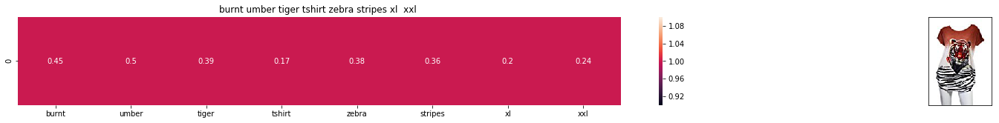

ASIN : B00JXQB5FQ
BRAND : Si Row
Eucliden distance from the given image : 0.0


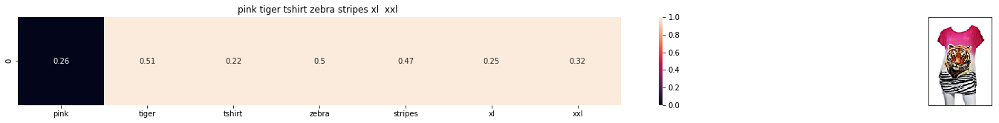

ASIN : B00JXQASS6
BRAND : Si Row
Eucliden distance from the given image : 0.753633191245


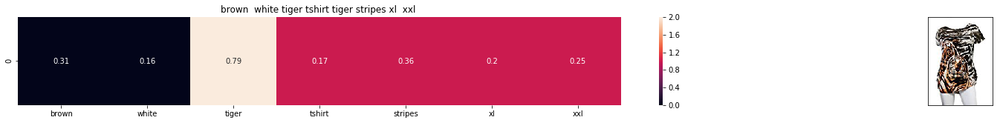

ASIN : B00JXQCWTO
BRAND : Si Row
Eucliden distance from the given image : 0.935764394377


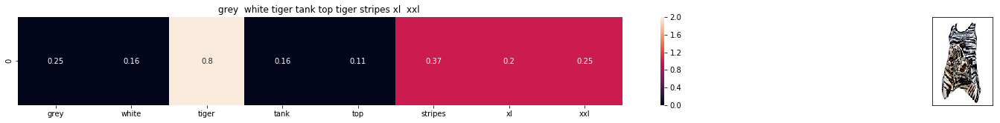

ASIN : B00JXQAFZ2
BRAND : Si Row
Eucliden distance from the given image : 0.95861535242


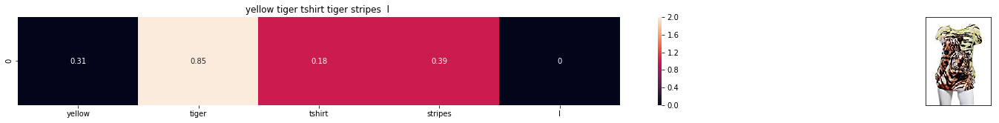

ASIN : B00JXQCUIC
BRAND : Si Row
Eucliden distance from the given image : 1.00007496145


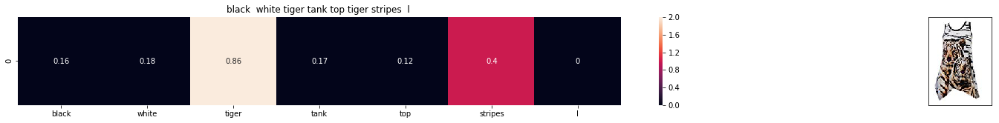

ASIN : B00JXQAO94
BRAND : Si Row
Eucliden distance from the given image : 1.02321555246


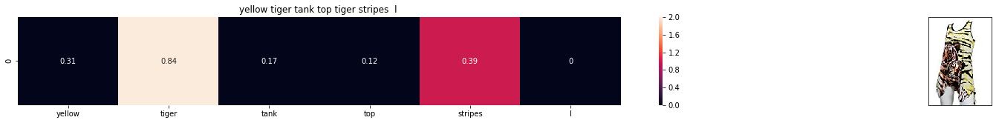

ASIN : B00JXQAUWA
BRAND : Si Row
Eucliden distance from the given image : 1.0319918463


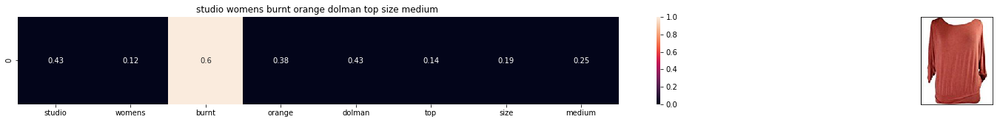

ASIN : B06XSCVFT5
BRAND : Studio M
Eucliden distance from the given image : 1.21068436704


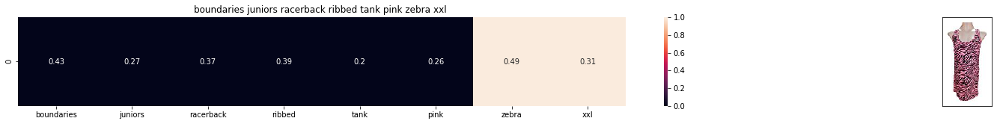

ASIN : B06Y2GTYPM
BRAND : No Boundaries
Eucliden distance from the given image : 1.21216838107


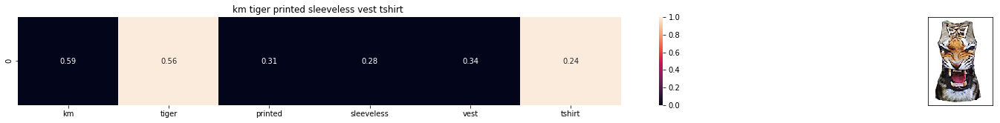

ASIN : B012VQLT6Y
BRAND : KM T-shirt
Eucliden distance from the given image : 1.21979064028


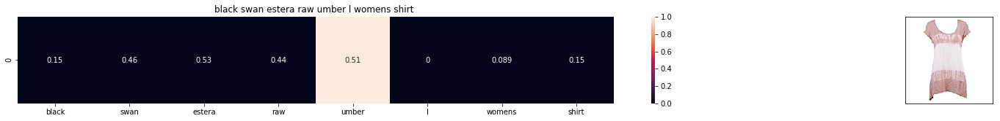

ASIN : B06Y1VN8WQ
BRAND : Black Swan
Eucliden distance from the given image : 1.220684966


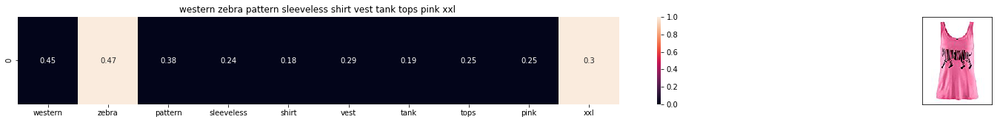

ASIN : B00Z6HEXWI
BRAND : Black Temptation
Eucliden distance from the given image : 1.22128139212


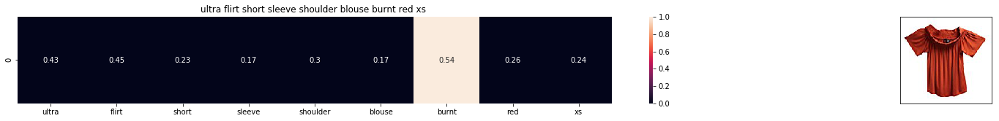

ASIN : B074TR12BH
BRAND : Ultra Flirt
Eucliden distance from the given image : 1.23133640946


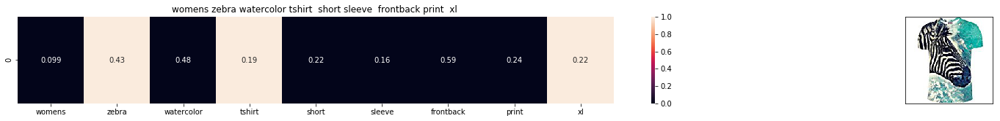

ASIN : B072R2JXKW
BRAND : WHAT ON EARTH
Eucliden distance from the given image : 1.23184519726


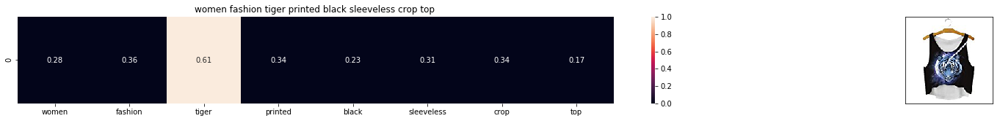

ASIN : B074T8ZYGX
BRAND : MKP Crop Top
Eucliden distance from the given image : 1.23406074574


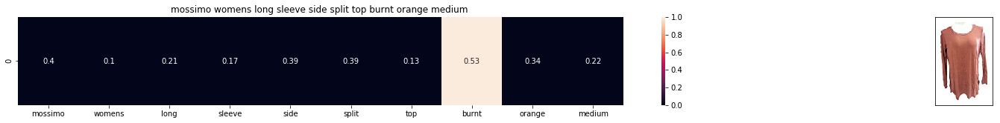

ASIN : B071ZDF6T2
BRAND : Mossimo
Eucliden distance from the given image : 1.23527855777


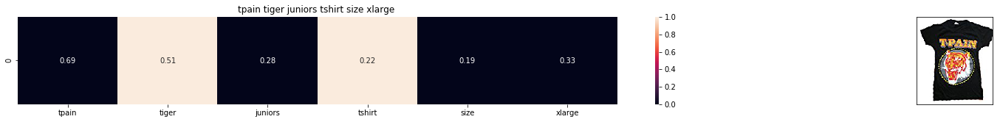

ASIN : B01K0H02OG
BRAND : Tultex
Eucliden distance from the given image : 1.23645729881


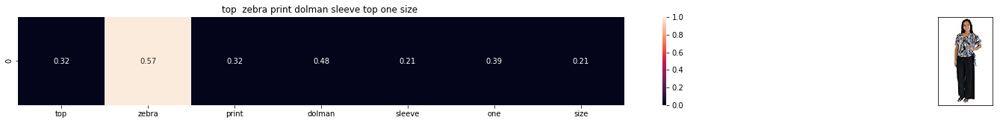

ASIN : B00H8A6ZLI
BRAND : Vivian's Fashions
Eucliden distance from the given image : 1.24996155053


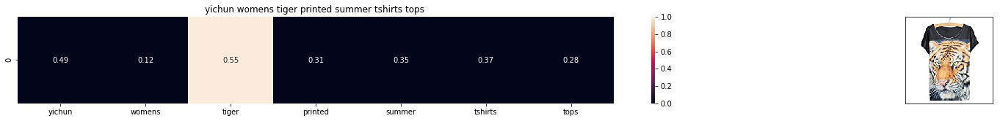

ASIN : B010NN9RXO
BRAND : YICHUN
Eucliden distance from the given image : 1.25354614209


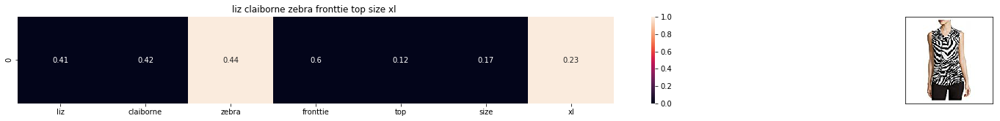

ASIN : B06XBY5QXL
BRAND : Liz Claiborne
Eucliden distance from the given image : 1.25388329384


In [0]:
def tfidf_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(tfidf_title_features,tfidf_title_features[doc_id])

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])

    for i in range(0,len(indices)):
        # we will pass 1. doc_id, 2. title1, 3. title2, url, model
        get_result(indices[i], data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'tfidf')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('BRAND :',data['brand'].loc[df_indices[i]])
        print ('Eucliden distance from the given image :', pdists[i])
        print('='*125)
tfidf_model(12566, 20)
# in the output heat map each value represents the tfidf values of the label word, the color represents the intersection with inputs title

## [8.5] IDF based product similarity

In [0]:
idf_title_vectorizer = CountVectorizer()
idf_title_features = idf_title_vectorizer.fit_transform(data['title'])

# idf_title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(courpus) returns the a sparase matrix of dimensions #data_points * #words_in_corpus
# idf_title_features[doc_id, index_of_word_in_corpus] = number of times the word occured in that doc

In [0]:
def n_containing(word):
    # return the number of documents which had the given word
    return sum(1 for blob in data['title'] if word in blob.split())

def idf(word):
    # idf = log(#number of docs / #number of docs which had the given word)
    return math.log(data.shape[0] / (n_containing(word)))

In [0]:
# we need to convert the values into float
idf_title_features  = idf_title_features.astype(np.float)

for i in idf_title_vectorizer.vocabulary_.keys():
    # for every word in whole corpus we will find its idf value
    idf_val = idf(i)
    
    # to calculate idf_title_features we need to replace the count values with the idf values of the word
    # idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0] will return all documents in which the word i present
    for j in idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0]:
        
        # we replace the count values of word i in document j with  idf_value of word i 
        # idf_title_features[doc_id, index_of_word_in_courpus] = idf value of word
        idf_title_features[j,idf_title_vectorizer.vocabulary_[i]] = idf_val
        

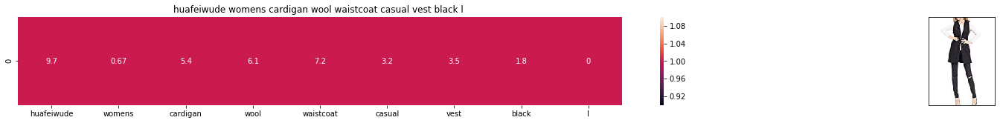

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from the given image : 0.0


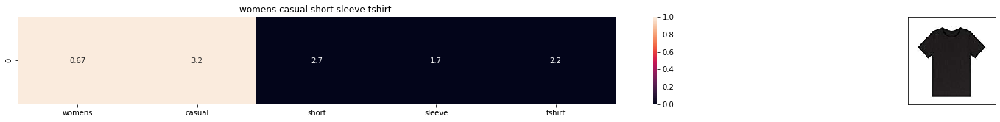

ASIN : B074T9KG9Q
Brand : Rain
euclidean distance from the given image : 15.615323652053057


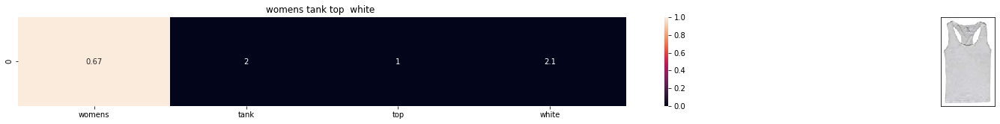

ASIN : B00JPOZ9GM
Brand : Sofra
euclidean distance from the given image : 15.744264266781588


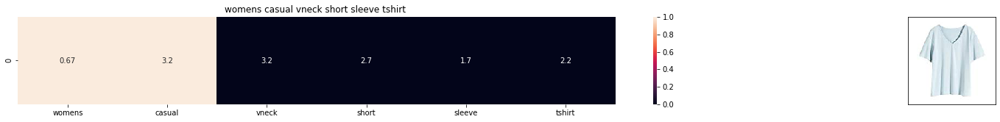

ASIN : B074V45DCX
Brand : Rain
euclidean distance from the given image : 15.945600577587768


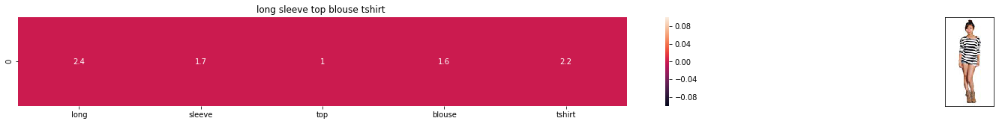

ASIN : B00KF2N5PU
Brand : Vietsbay
euclidean distance from the given image : 16.01194197210101


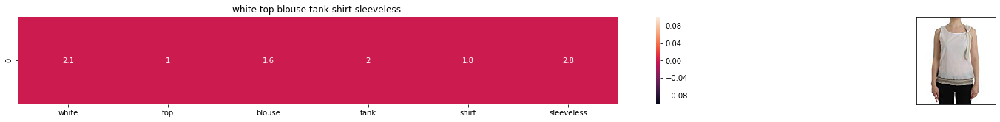

ASIN : B074G5G5RK
Brand : ERMANNO SCERVINO
euclidean distance from the given image : 16.193269507398313


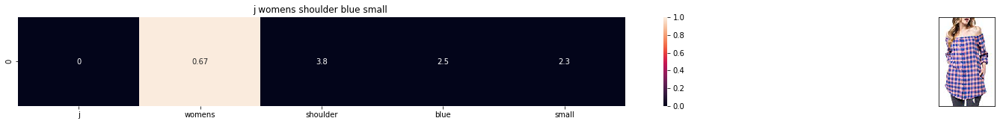

ASIN : B07583CQFT
Brand : Very J
euclidean distance from the given image : 16.2686385443419


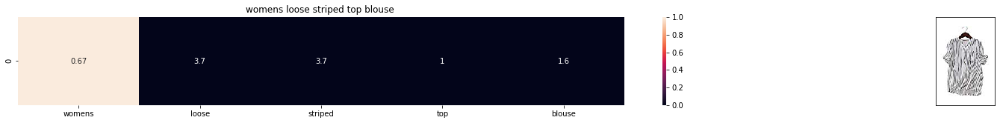

ASIN : B00ZZMYBRG
Brand : HP-LEISURE
euclidean distance from the given image : 16.426585216722245


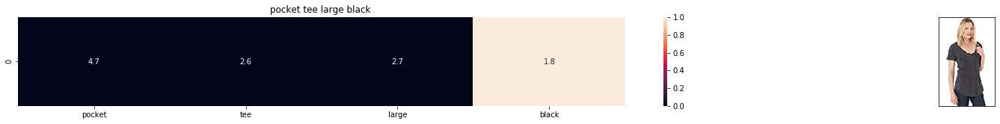

ASIN : B017I2YWUQ
Brand : Z SUPPLY
euclidean distance from the given image : 16.486585572396056


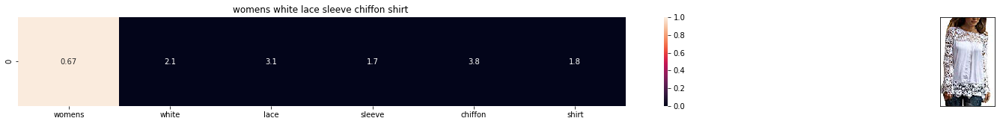

ASIN : B073JWSM1V
Brand : Fuming
euclidean distance from the given image : 16.5367556138437


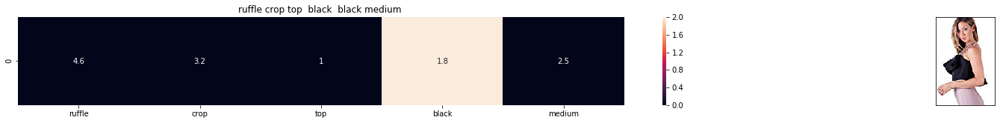

ASIN : B01HT0OL3K
Brand : Lushfox
euclidean distance from the given image : 16.564678175488137


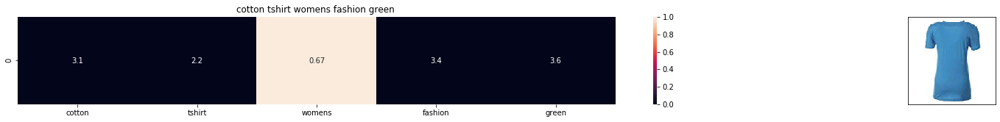

ASIN : B073GJGVBN
Brand : Ivan Levi
euclidean distance from the given image : 16.6575495972295


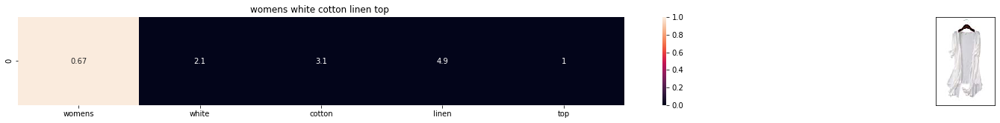

ASIN : B00ZZPR4Y0
Brand : HP-LEISURE
euclidean distance from the given image : 16.65800447522085


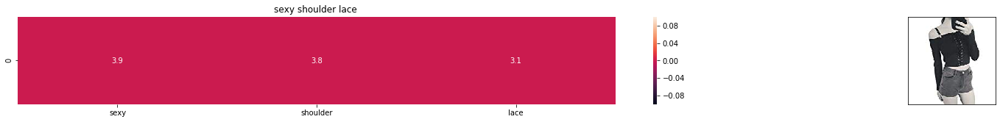

ASIN : B01JVWUB3S
Brand : bylexie
euclidean distance from the given image : 16.67188980155837


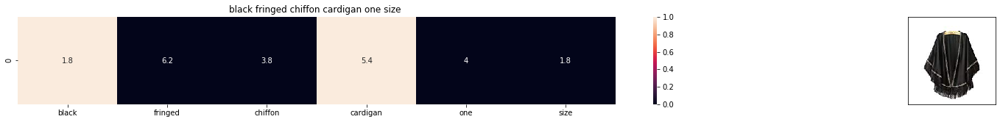

ASIN : B010AMAMLY
Brand : HP-LEISURE
euclidean distance from the given image : 16.68256175427422


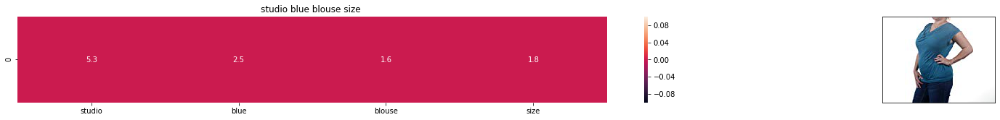

ASIN : B016P80OKQ
Brand : Studio M
euclidean distance from the given image : 16.692865428465016


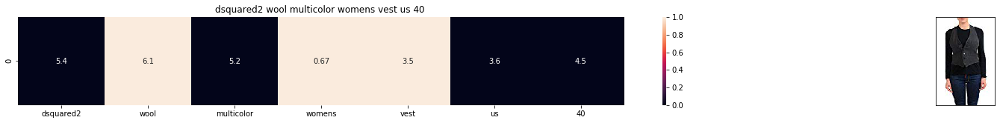

ASIN : B01N2MU4DR
Brand : DSQUARED2
euclidean distance from the given image : 16.69820390236253


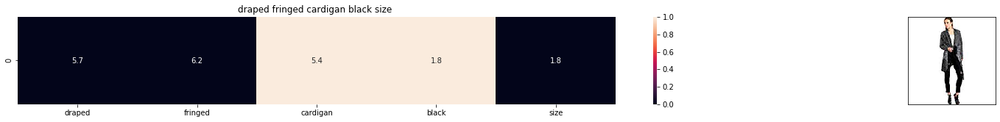

ASIN : B01CB33866
Brand : Flying Tomato
euclidean distance from the given image : 16.724506545515847


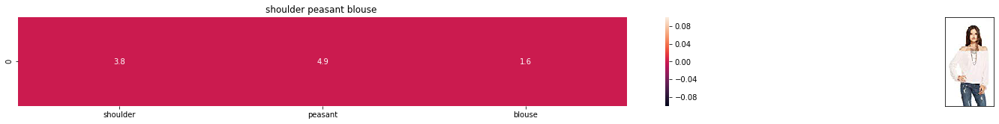

ASIN : B01E1QD5PK
Brand : CHASER
euclidean distance from the given image : 16.727657052754815


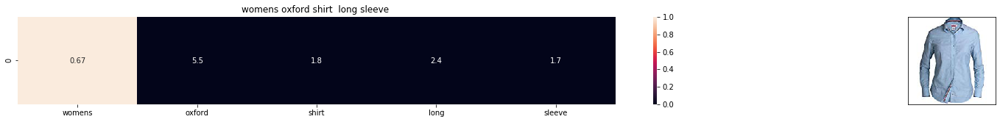

ASIN : B01577JZOC
Brand : Boast
euclidean distance from the given image : 16.750308337761325


In [26]:
def idf_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(idf_title_features,idf_title_features[doc_id])

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])

    for i in range(0,len(indices)):
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'idf')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print ('euclidean distance from the given image :', pdists[i])
        print('='*125)

        
        
idf_model(12566,20)
# in the output heat map each value represents the idf values of the label word, the color represents the intersection with inputs title

# [9] Text Semantics based product similarity

In [0]:

# credits: https://www.kaggle.com/c/word2vec-nlp-tutorial#part-2-word-vectors
# Custom Word2Vec using your own text data.
# Do NOT RUN this code.
# It is meant as a reference to build your own Word2Vec when you have 
# lots of data.

'''
# Set values for various parameters
num_features = 300    # Word vector dimensionality                      
min_word_count = 1    # Minimum word count                        
num_workers = 4       # Number of threads to run in parallel
context = 10          # Context window size                                                                                    
downsampling = 1e-3   # Downsample setting for frequent words

# Initialize and train the model (this will take some time)
from gensim.models import word2vec
print ("Training model...")
model = word2vec.Word2Vec(sen_corpus, workers=num_workers, \
            size=num_features, min_count = min_word_count, \
            window = context)
    
'''

In [0]:
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

# in this project we are using a pretrained model by google
# its 3.3G file, once you load this into your memory 
# it occupies ~9Gb, so please do this step only if you have >12G of ram
# we will provide a pickle file wich contains a dict , 
# and it contains all our courpus words as keys and  model[word] as values
# To use this code-snippet, download "GoogleNews-vectors-negative300.bin" 
# from https://drive.google.com/file/d/0B7XkCwpI5KDYNlNUTTlSS21pQmM/edit
# it's 1.9GB in size.

'''
model = KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)
'''

#if you do NOT have RAM >= 12GB, use the code below.
with open('/content/drive/My Drive/amazon_fashion/word2vec_model', 'rb') as handle:
    model = pickle.load(handle)


In [0]:
# Utility functions

def get_word_vec(sentence, doc_id, m_name):
    # sentence : title of the apparel
    # doc_id: document id in our corpus
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)
    vec = []
    for i in sentence.split():
        if i in vocab:
            if m_name == 'weighted' and i in  idf_title_vectorizer.vocabulary_:
                vec.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[i]] * model[i])
            elif m_name == 'avg':
                vec.append(model[i])
        else:
            # if the word in our courpus is not there in the google word2vec corpus, we are just ignoring it
            vec.append(np.zeros(shape=(300,)))
    # we will return a numpy array of shape (#number of words in title * 300 ) 300 = len(w2v_model[word])
    # each row represents the word2vec representation of each word (weighted/avg) in given sentance 
    return  np.array(vec)

def get_distance(vec1, vec2):
    # vec1 = np.array(#number_of_words_title1 * 300), each row is a vector of length 300 corresponds to each word in give title
    # vec2 = np.array(#number_of_words_title2 * 300), each row is a vector of length 300 corresponds to each word in give title
    
    final_dist = []
    # for each vector in vec1 we caluclate the distance(euclidean) to all vectors in vec2
    for i in vec1:
        dist = []
        for j in vec2:
            # np.linalg.norm(i-j) will result the euclidean distance between vectors i, j
            dist.append(np.linalg.norm(i-j))
        final_dist.append(np.array(dist))
    # final_dist = np.array(#number of words in title1 * #number of words in title2)
    # final_dist[i,j] = euclidean distance between vectors i, j
    return np.array(final_dist)


def heat_map_w2v(sentence1, sentence2, url, doc_id1, doc_id2, model):
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentence1, doc_id1, model)
    #s2_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentence2, doc_id2, model)

    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)

    
    
    # devide whole figure into 2 parts 1st part displays heatmap 2nd part displays image of apparel
    gs = gridspec.GridSpec(2, 2, width_ratios=[4,1],height_ratios=[2,1]) 
    fig = plt.figure(figsize=(15,15))
    
    ax = plt.subplot(gs[0])
    # ploting the heap map based on the pairwise distances
    ax = sns.heatmap(np.round(s1_s2_dist,4), annot=True)
    # set the x axis labels as recommended apparels title
    ax.set_xticklabels(sentence2.split())
    # set the y axis labels as input apparels title
    ax.set_yticklabels(sentence1.split())
    # set title as recommended apparels title
    ax.set_title(sentence2)
    
    ax = plt.subplot(gs[1])
    # we remove all grids and axis labels for image
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    display_img(url, ax, fig)
    
    plt.show()

In [0]:
# vocab = stores all the words that are there in google w2v model
# vocab = model.wv.vocab.keys() # if you are using Google word2Vec

vocab = model.keys()
# this function will add the vectors of each word and returns the avg vector of given sentance
def build_avg_vec(sentence, num_features, doc_id, m_name):
    # sentace: its title of the apparel
    # num_features: the lenght of word2vec vector, its values = 300
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)

    featureVec = np.zeros((num_features,), dtype="float32")
    # we will intialize a vector of size 300 with all zeros
    # we add each word2vec(wordi) to this fetureVec
    nwords = 0
    
    for word in sentence.split():
        nwords += 1
        if word in vocab:
            if m_name == 'weighted' and word in  idf_title_vectorizer.vocabulary_:
                featureVec = np.add(featureVec, idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[word]] * model[word])
            elif m_name == 'avg':
                featureVec = np.add(featureVec, model[word])
    if(nwords>0):
        featureVec = np.divide(featureVec, nwords)
    # returns the avg vector of given sentance, its of shape (1, 300)
    return featureVec

### [9.2] Average Word2Vec product similarity.

In [0]:
doc_id = 0
w2v_title = []
# for every title we build a avg vector representation
for i in data['title']:
    w2v_title.append(build_avg_vec(i, 300, doc_id,'avg'))
    doc_id += 1

# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
w2v_title = np.array(w2v_title)


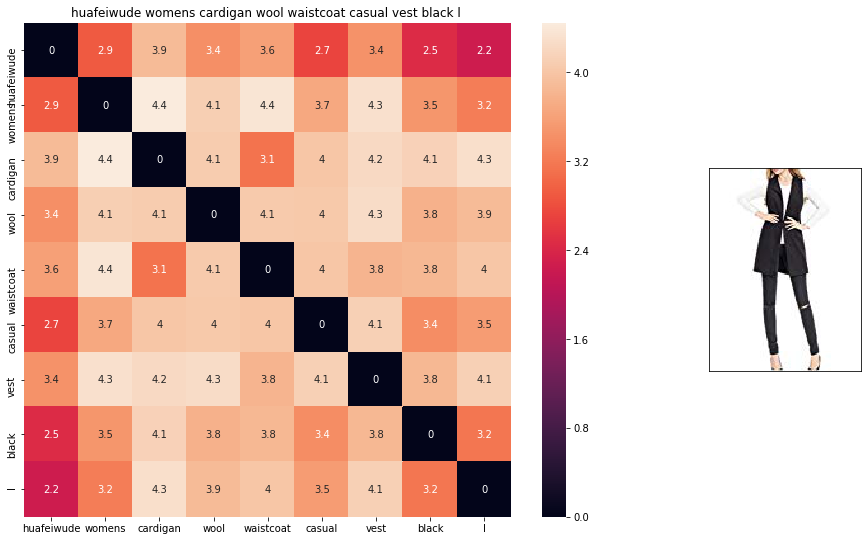

ASIN : B01MT96PXZ
BRAND : Huafeiwude
euclidean distance from given input image : 0.0


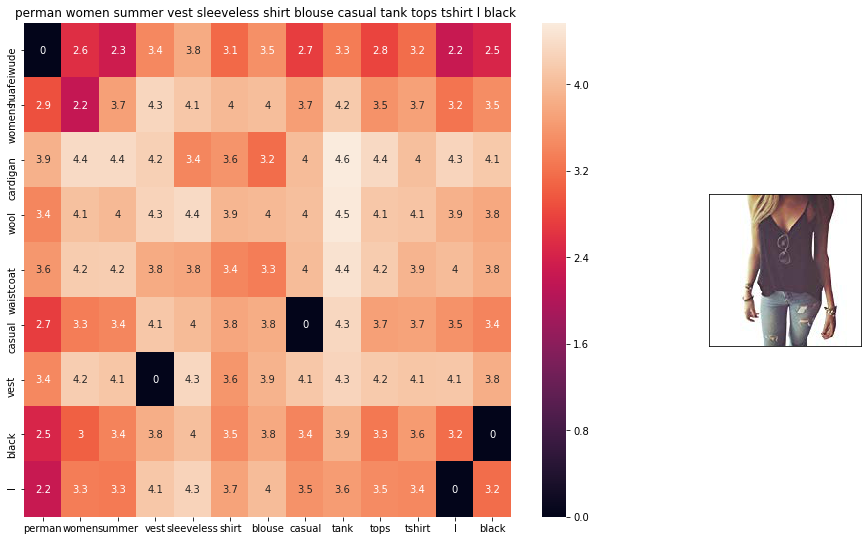

ASIN : B01F852VDK
BRAND : Perman
euclidean distance from given input image : 0.8539957


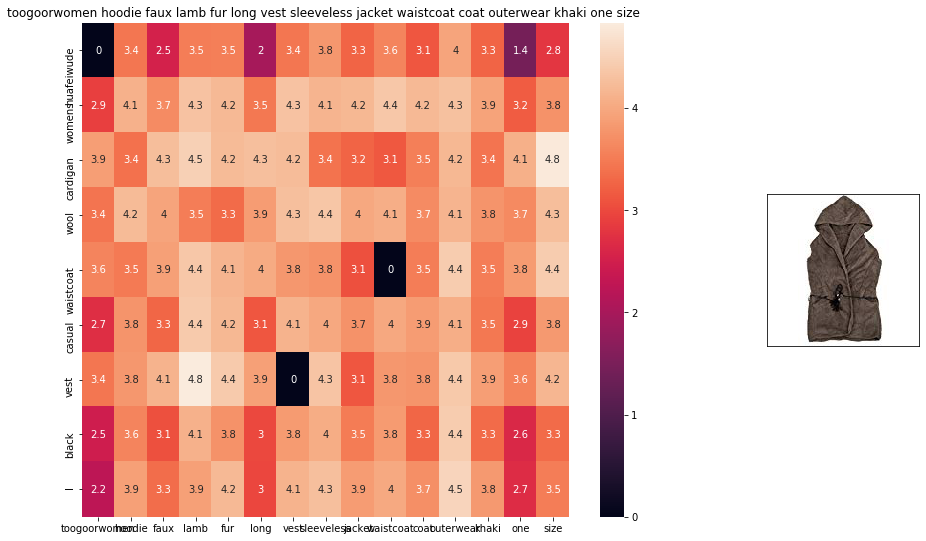

ASIN : B00R10GCHC
BRAND : TOOGOO(R)
euclidean distance from given input image : 0.8619427


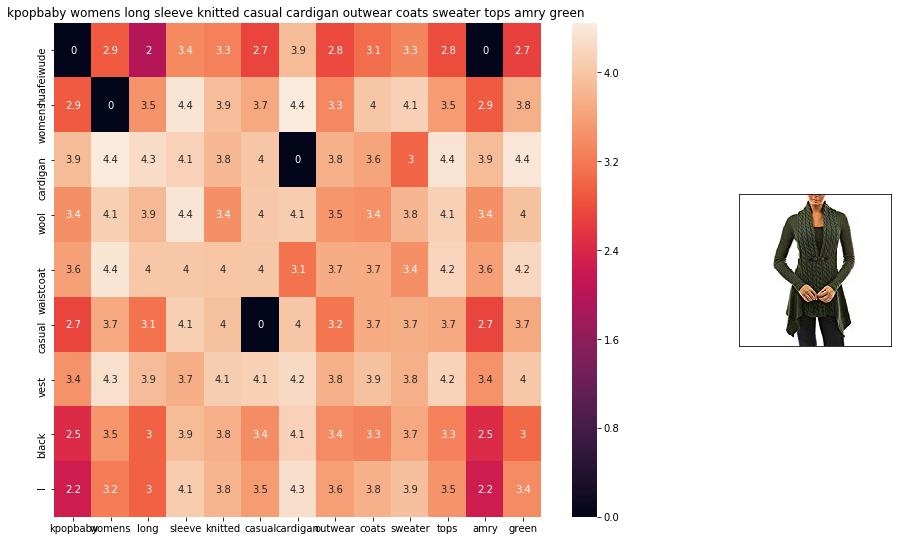

ASIN : B074LD7G7K
BRAND : KpopBaby
euclidean distance from given input image : 0.87473196


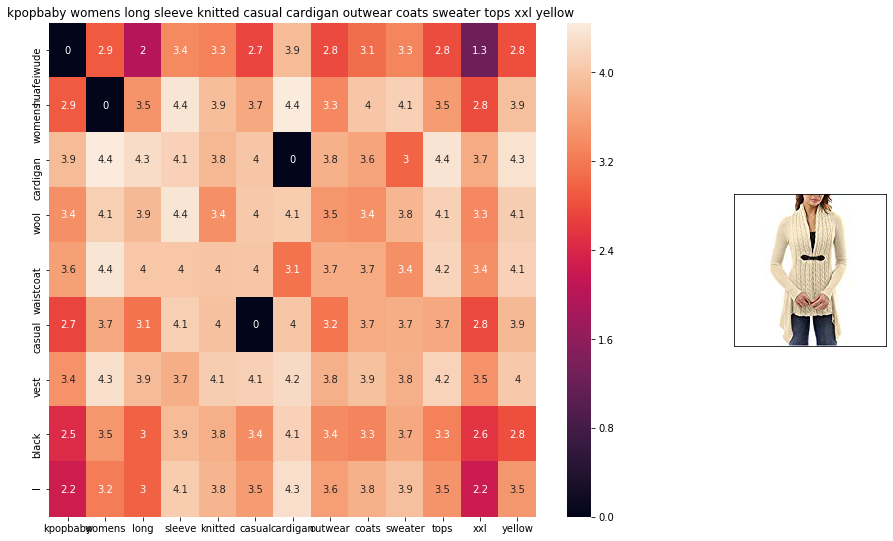

ASIN : B074LCPJJZ
BRAND : KpopBaby
euclidean distance from given input image : 0.88326466


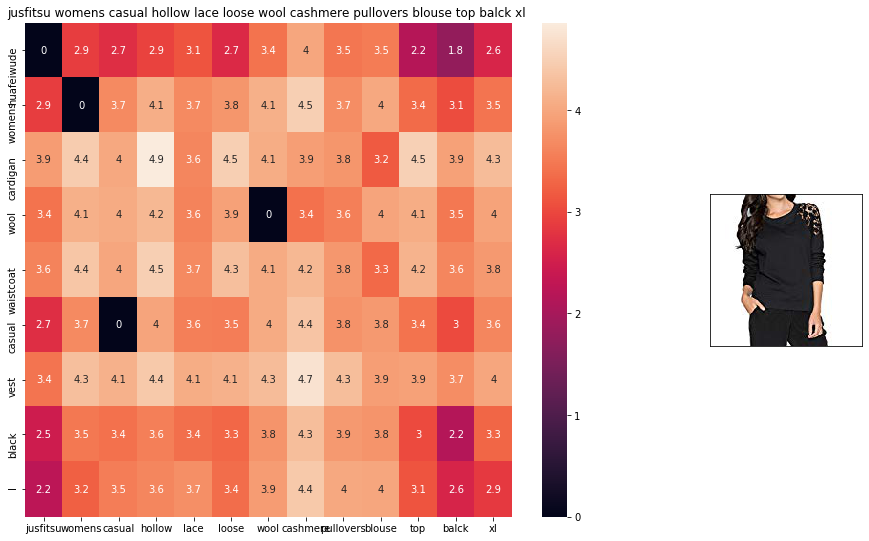

ASIN : B01N96GX38
BRAND : Jusfitsu
euclidean distance from given input image : 0.8868851


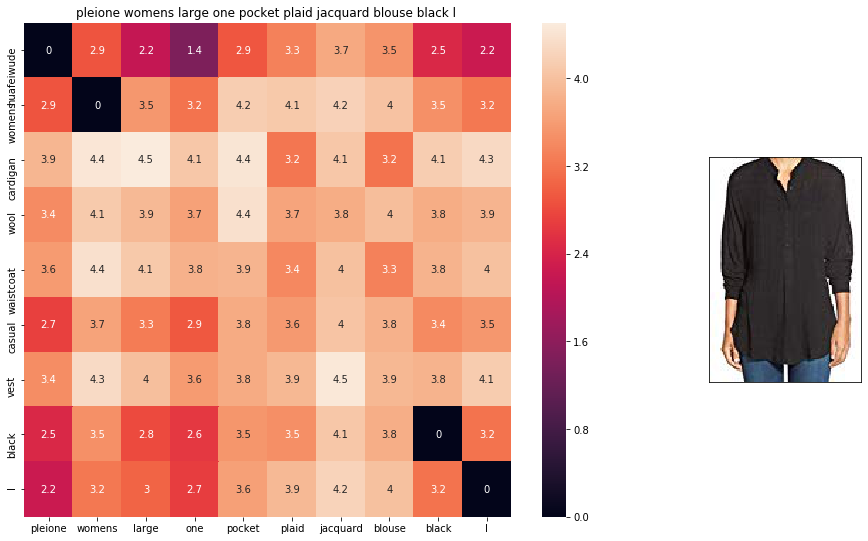

ASIN : B06XGQ9CSM
BRAND : Pleione
euclidean distance from given input image : 0.8881678


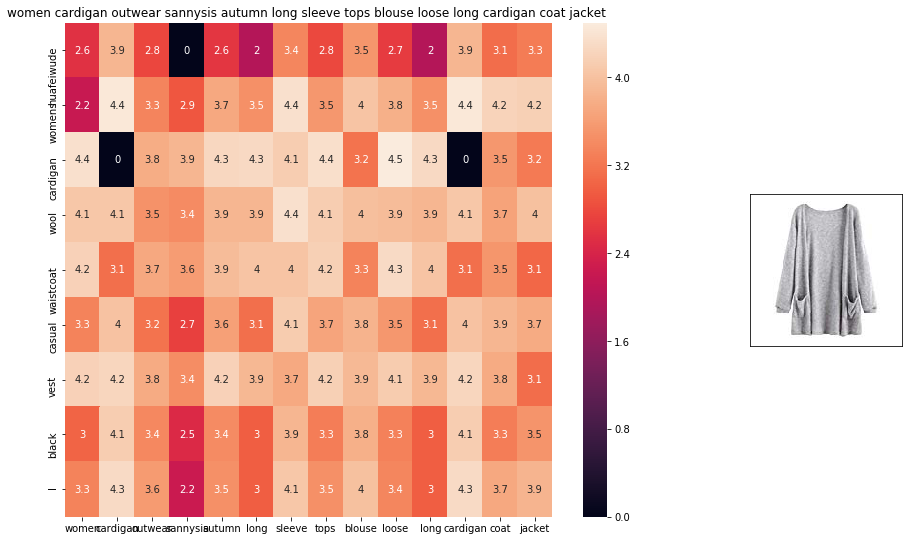

ASIN : B07473KFK1
BRAND : Sannysis
euclidean distance from given input image : 0.89271647


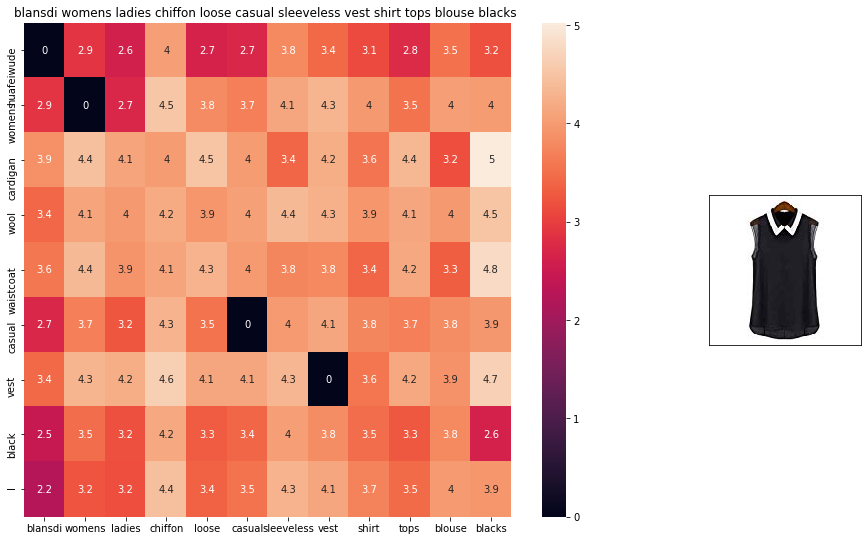

ASIN : B01B3Y99XA
BRAND : Blansdi
euclidean distance from given input image : 0.8936688


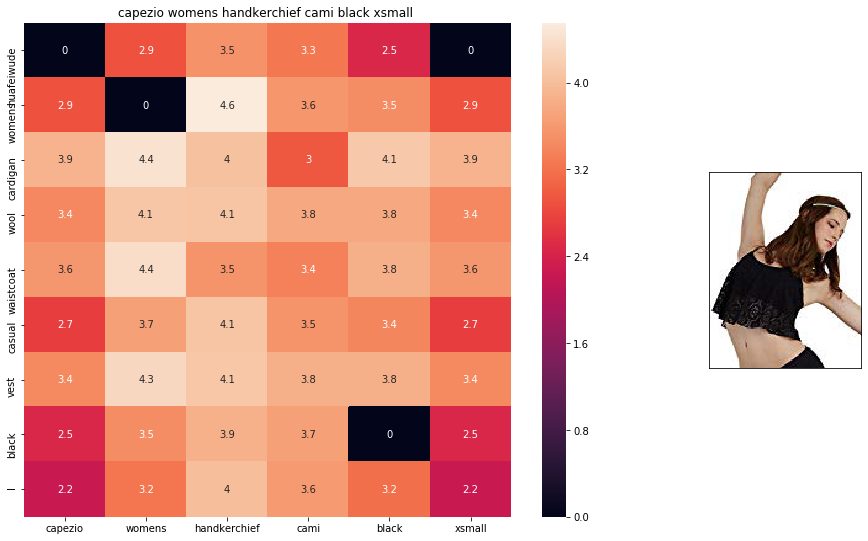

ASIN : B00ZIY47WA
BRAND : Capezio
euclidean distance from given input image : 0.89525115


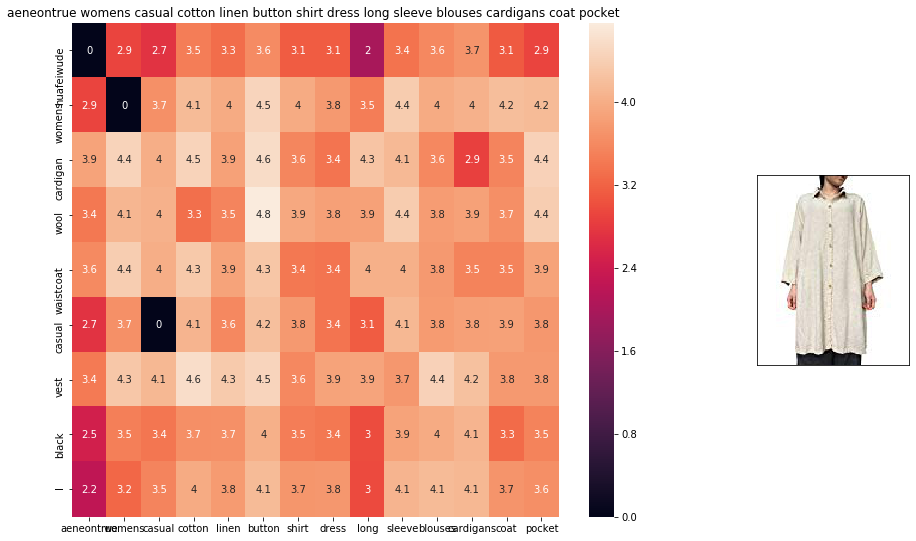

ASIN : B074V1K5QJ
BRAND : Aeneontrue
euclidean distance from given input image : 0.9028107


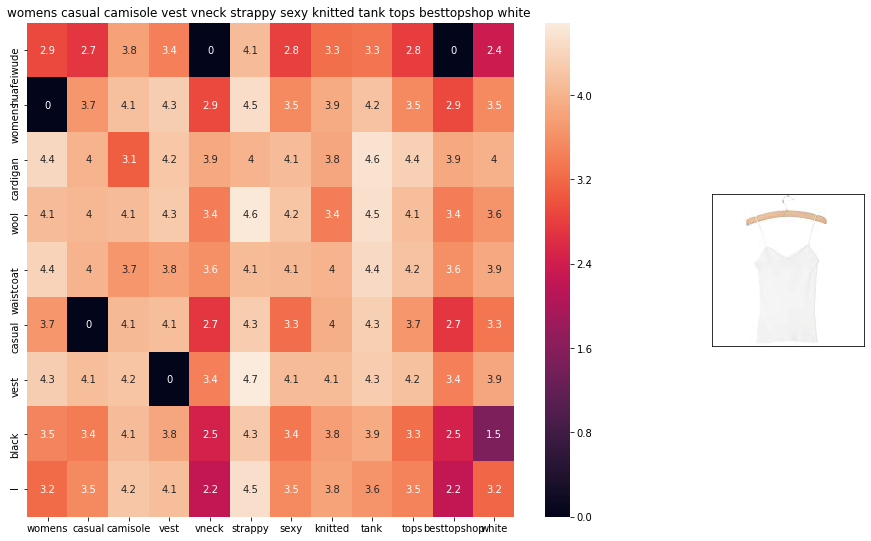

ASIN : B071XV9DKH
BRAND : Best Music Posters
euclidean distance from given input image : 0.9065367


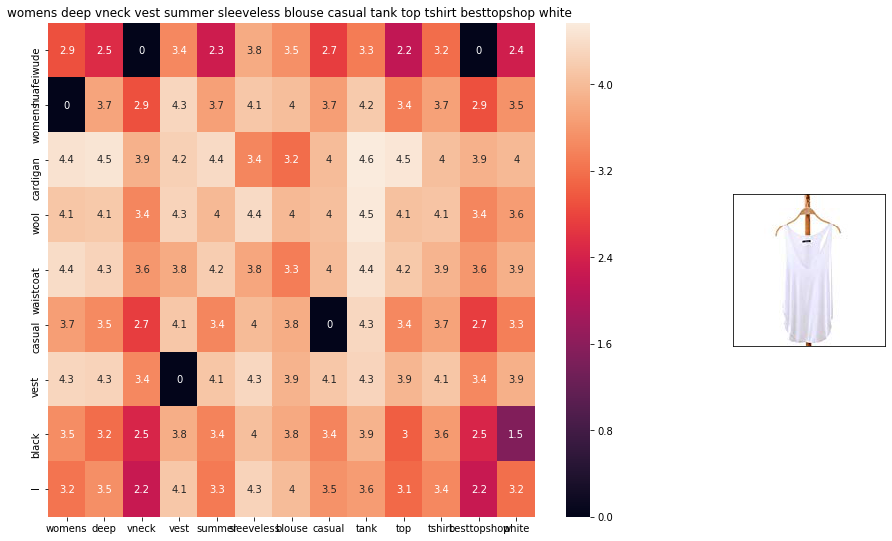

ASIN : B071Y6W6D8
BRAND : Best Music Posters
euclidean distance from given input image : 0.9093141


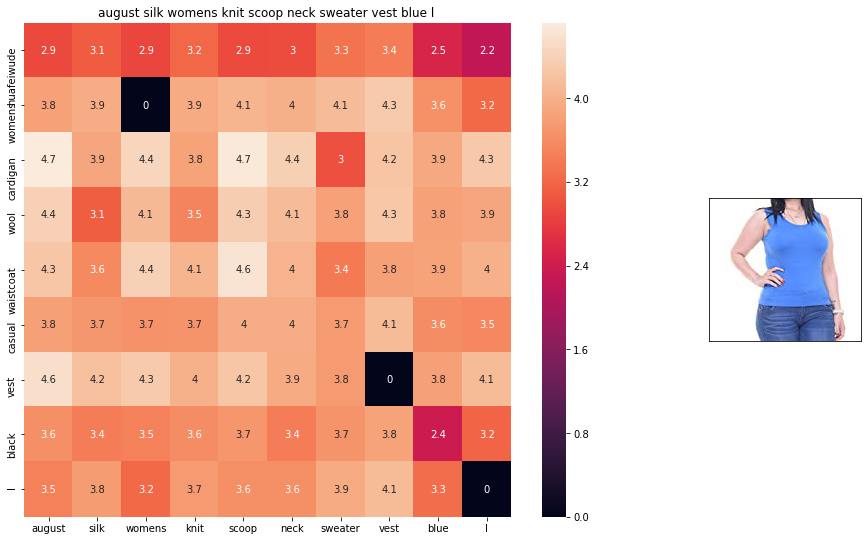

ASIN : B06X6N47HY
BRAND : August Silk
euclidean distance from given input image : 0.9097892


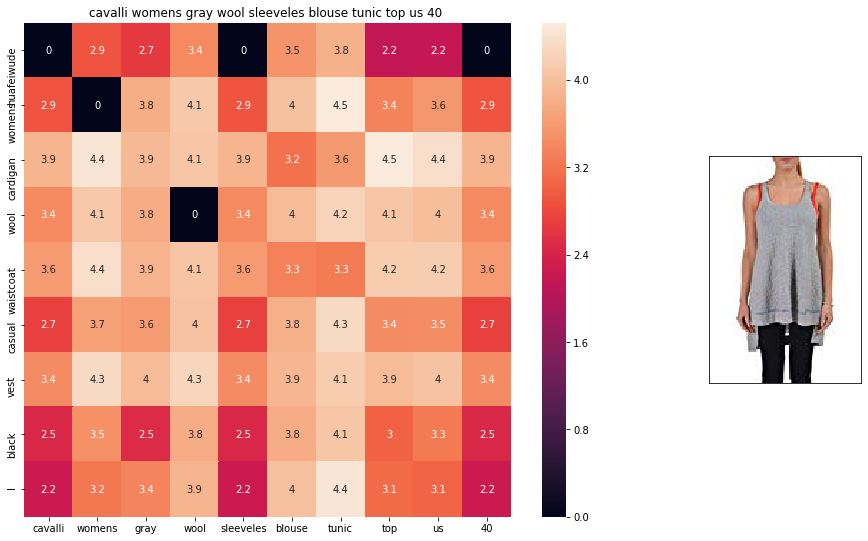

ASIN : B0175AT71K
BRAND : Just Cavalli
euclidean distance from given input image : 0.9117741


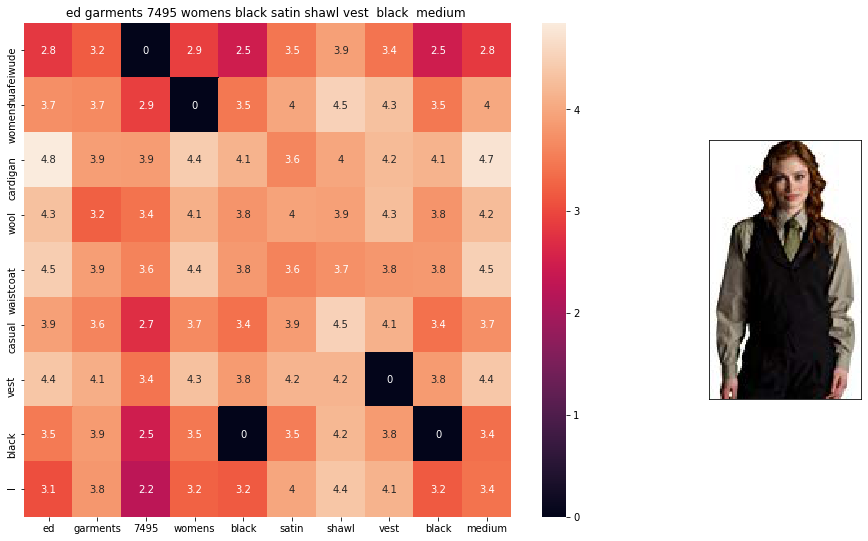

ASIN : B007X49OCG
BRAND : Edwards Garment
euclidean distance from given input image : 0.91356814


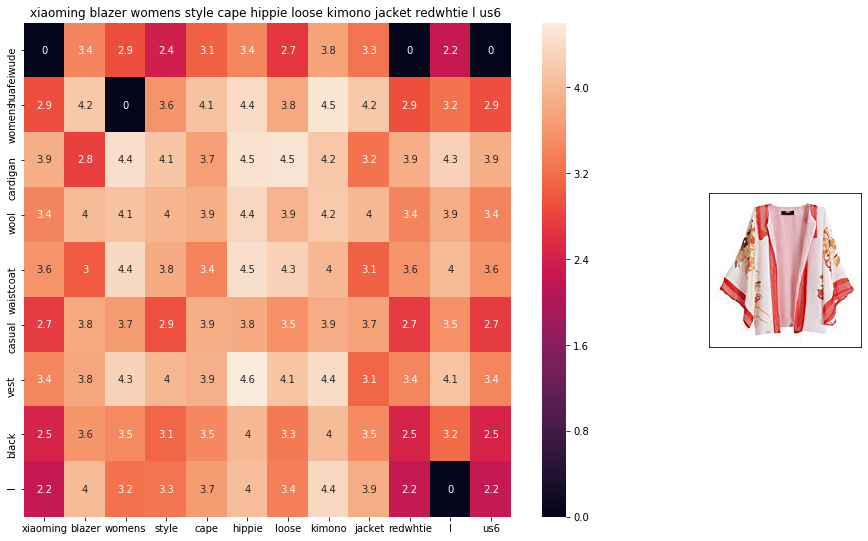

ASIN : B00WPK4T4G
BRAND : xiaoming
euclidean distance from given input image : 0.9149437


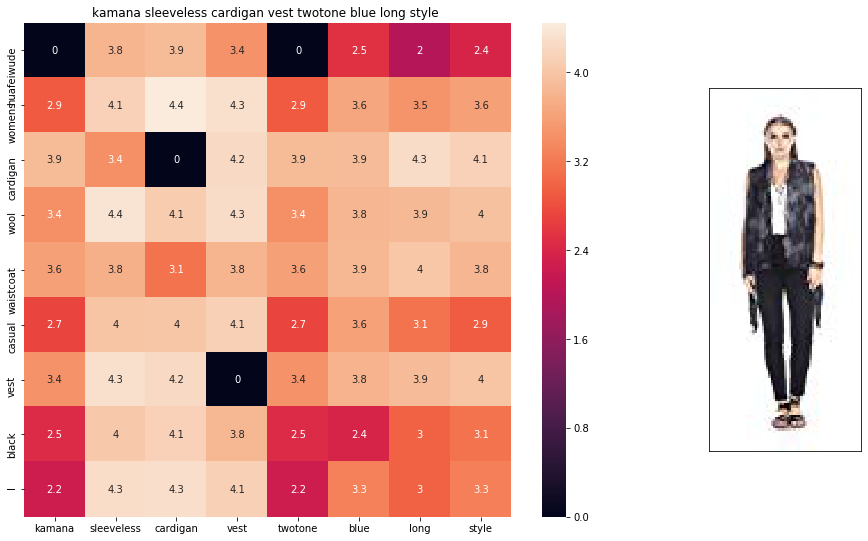

ASIN : B0751686K7
BRAND : Kamana
euclidean distance from given input image : 0.917094


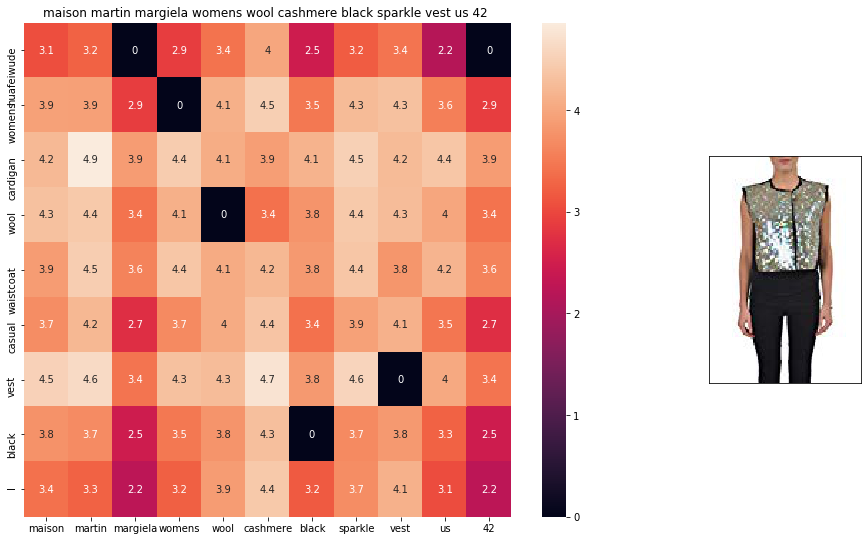

ASIN : B0175G7C20
BRAND : Maison Martin Margiela
euclidean distance from given input image : 0.9177549


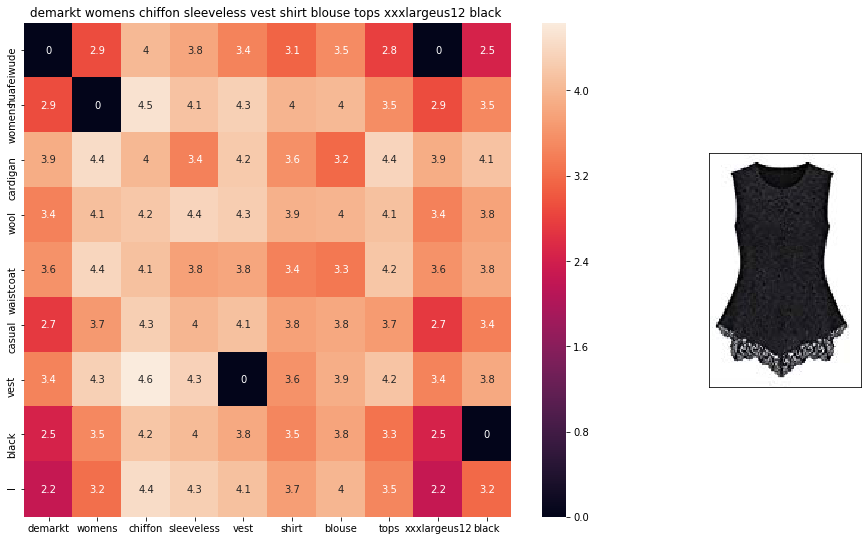

ASIN : B00JKCQZJE
BRAND : Demarkt
euclidean distance from given input image : 0.917883


In [0]:
def avg_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # dist(x, y) = sqrt(dot(x, x) - 2 * dot(x, y) + dot(y, y))
    pairwise_dist = pairwise_distances(w2v_title, w2v_title[doc_id].reshape(1,-1))

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0, len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'avg')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('BRAND :',data['brand'].loc[df_indices[i]])
        print ('euclidean distance from given input image :', pdists[i])
        print('='*125)

        
avg_w2v_model(12566, 20)
# in the give heat map, each cell contains the euclidean distance between words i, j

### [9.4]  IDF weighted Word2Vec for product similarity

In [0]:
doc_id = 0
w2v_title_weight = []
# for every title we build a weighted vector representation
for i in data['title']:
    w2v_title_weight.append(build_avg_vec(i, 300, doc_id,'weighted'))
    doc_id += 1
# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
w2v_title_weight = np.array(w2v_title_weight)

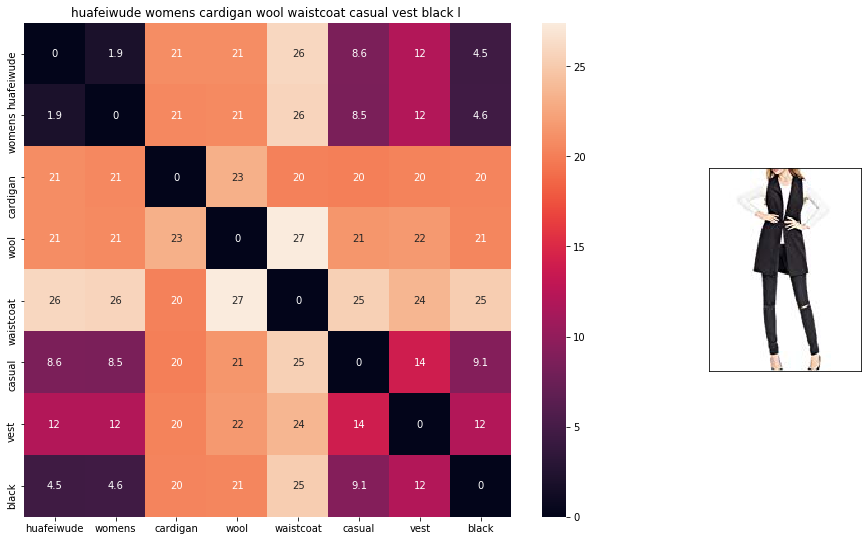

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 0.0


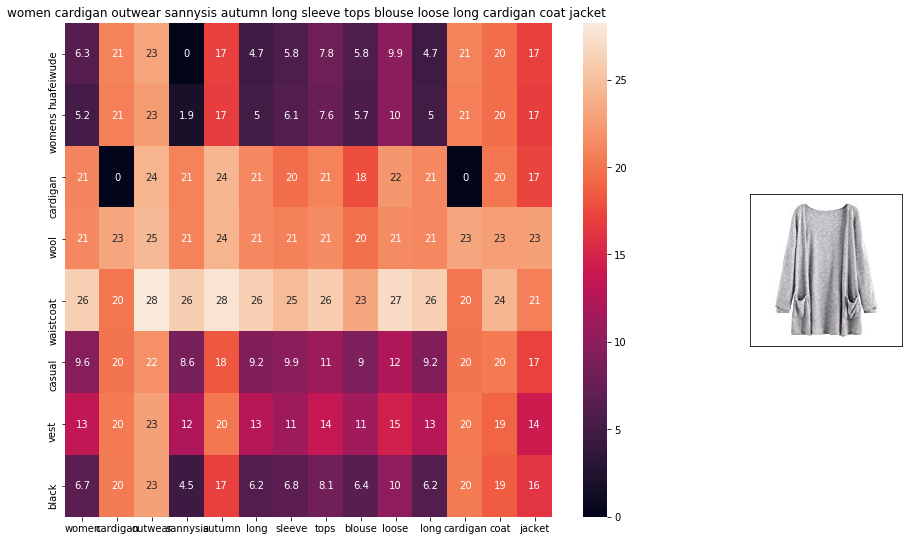

ASIN : B07473KFK1
Brand : Sannysis
euclidean distance from input : 3.7969613


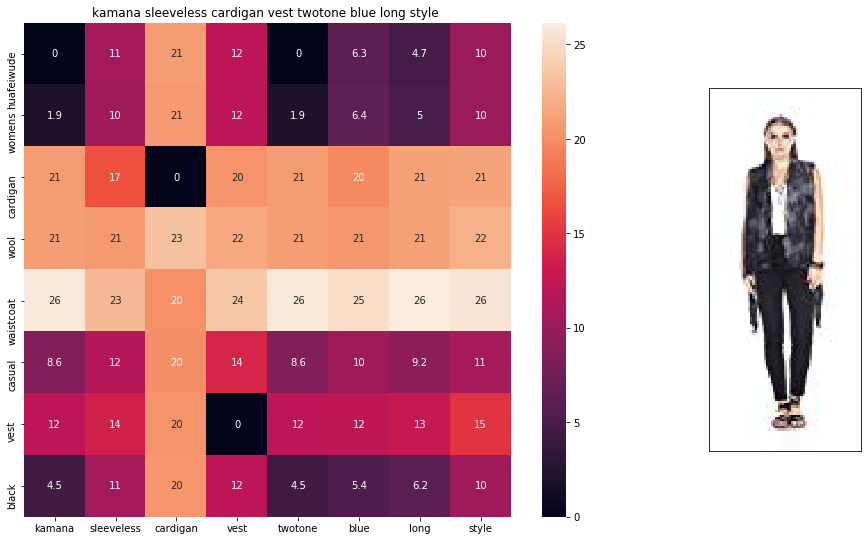

ASIN : B0751686K7
Brand : Kamana
euclidean distance from input : 3.9051597


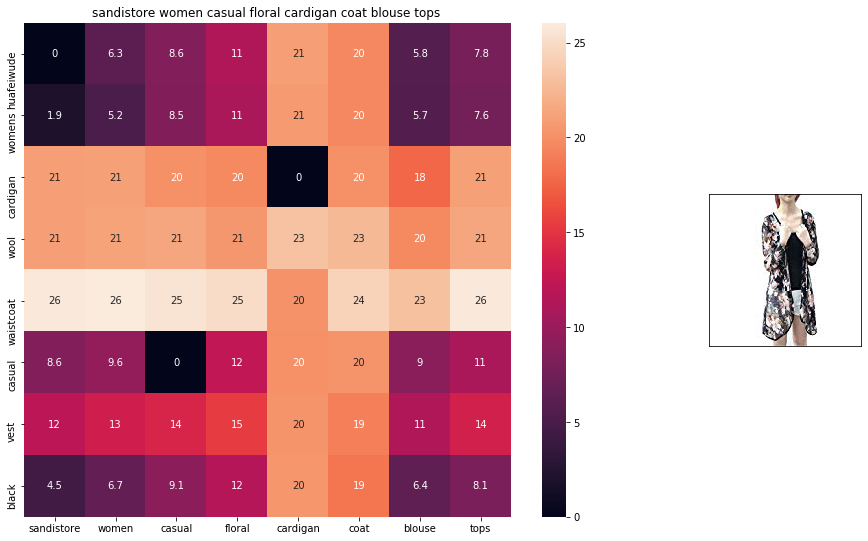

ASIN : B01AVX8IOU
Brand : Sandistore
euclidean distance from input : 3.9728305


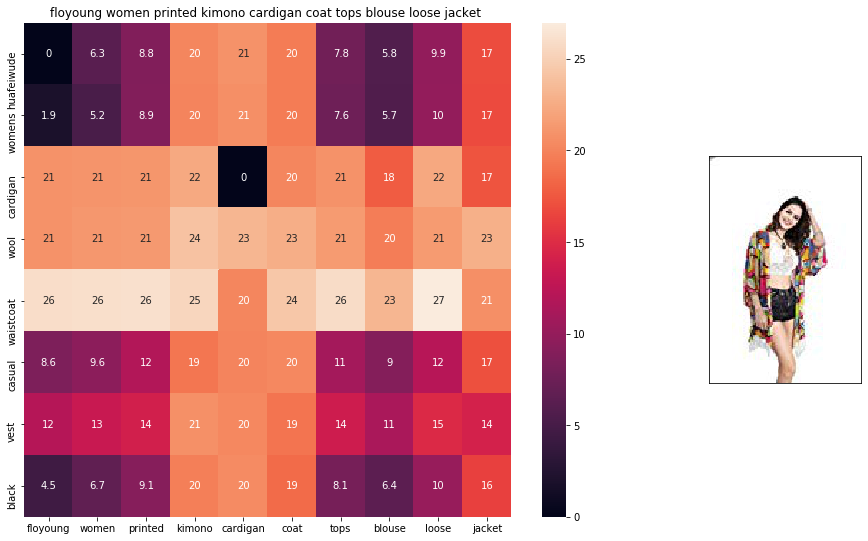

ASIN : B01D6EUG3W
Brand : FloYoung
euclidean distance from input : 3.9933598


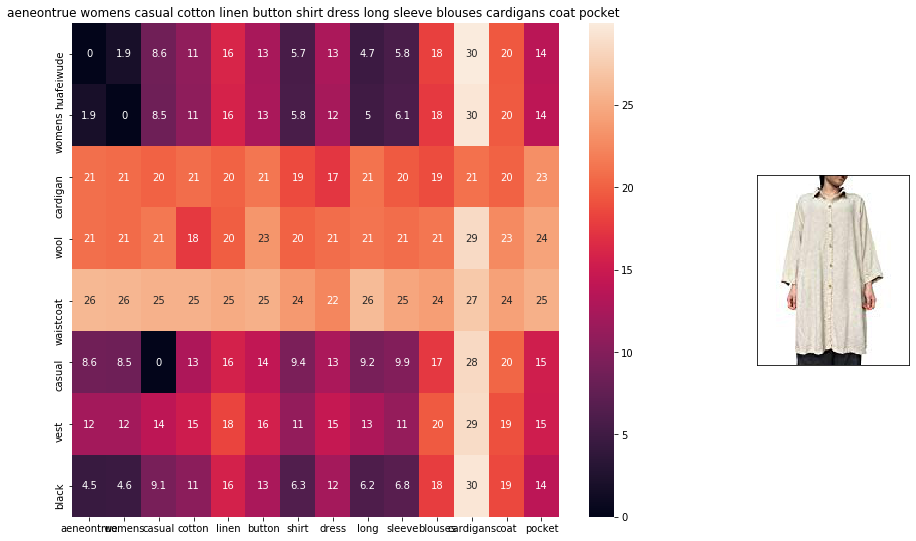

ASIN : B074V1K5QJ
Brand : Aeneontrue
euclidean distance from input : 4.0558114


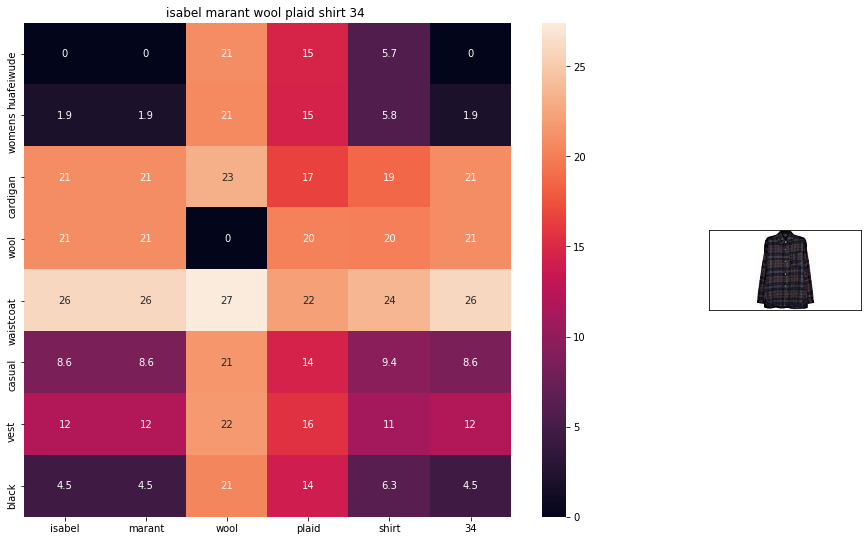

ASIN : B074NBDL2W
Brand : Isabel Marant
euclidean distance from input : 4.211965


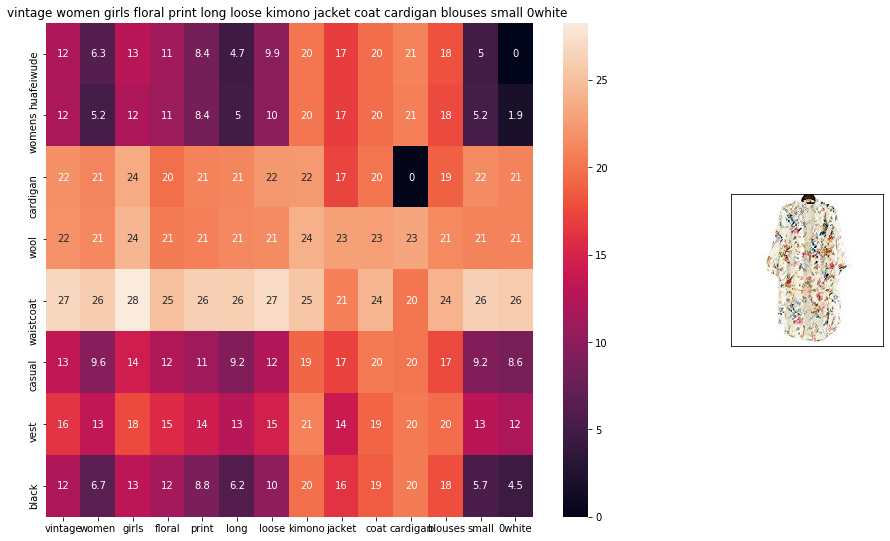

ASIN : B07375JCKD
Brand : ACEFAST INC
euclidean distance from input : 4.2146835


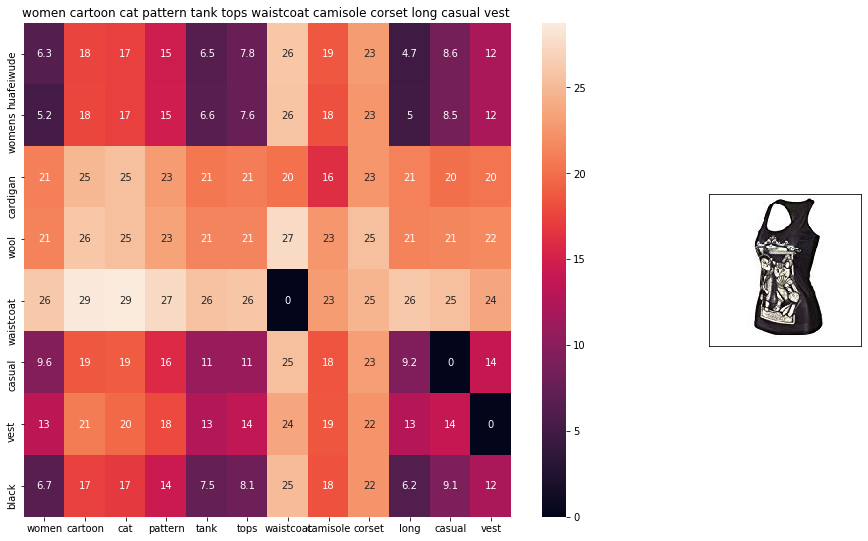

ASIN : B011R13YBM
Brand : Huayang
euclidean distance from input : 4.2270885


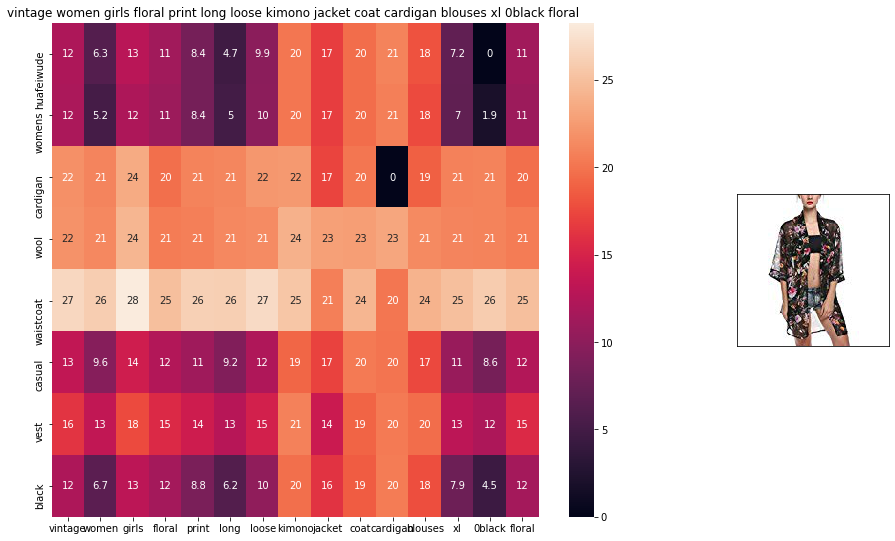

ASIN : B073PNYB2S
Brand : ACEFAST INC
euclidean distance from input : 4.2848


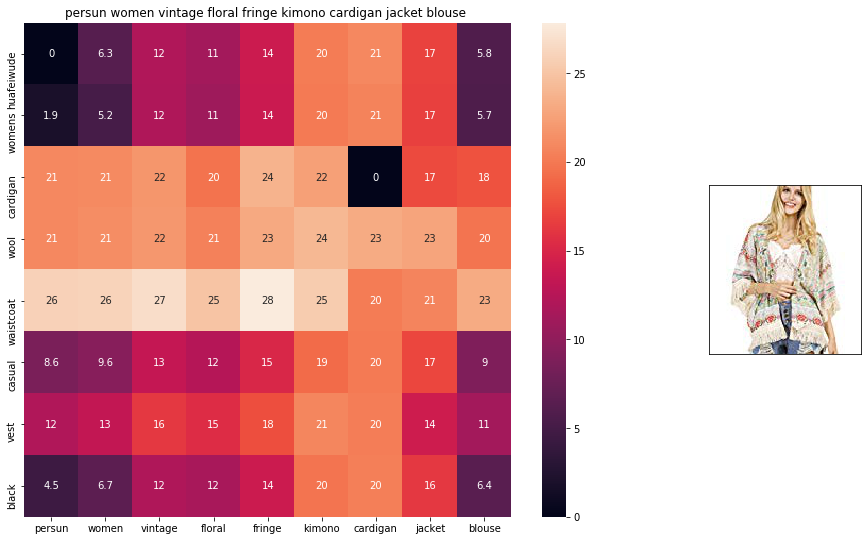

ASIN : B00Y26RSRQ
Brand : Persun
euclidean distance from input : 4.2976522


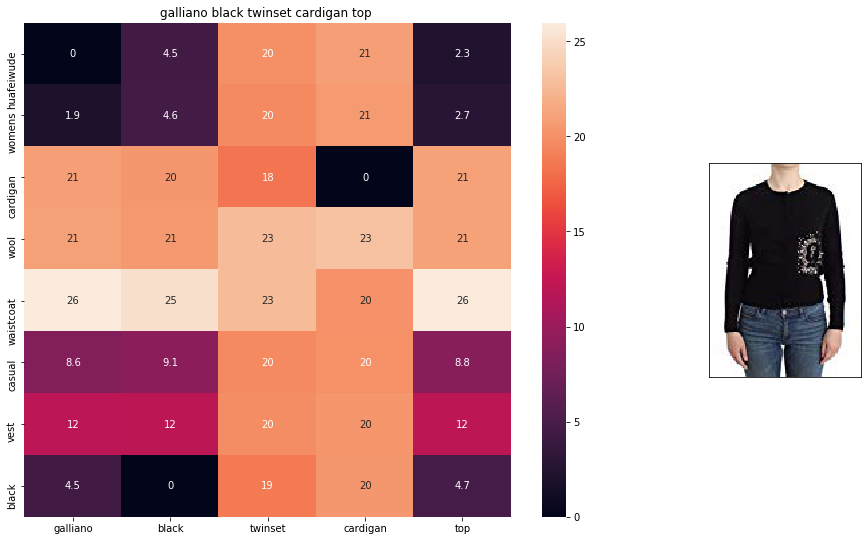

ASIN : B074G57HQJ
Brand : Galliano
euclidean distance from input : 4.3163776


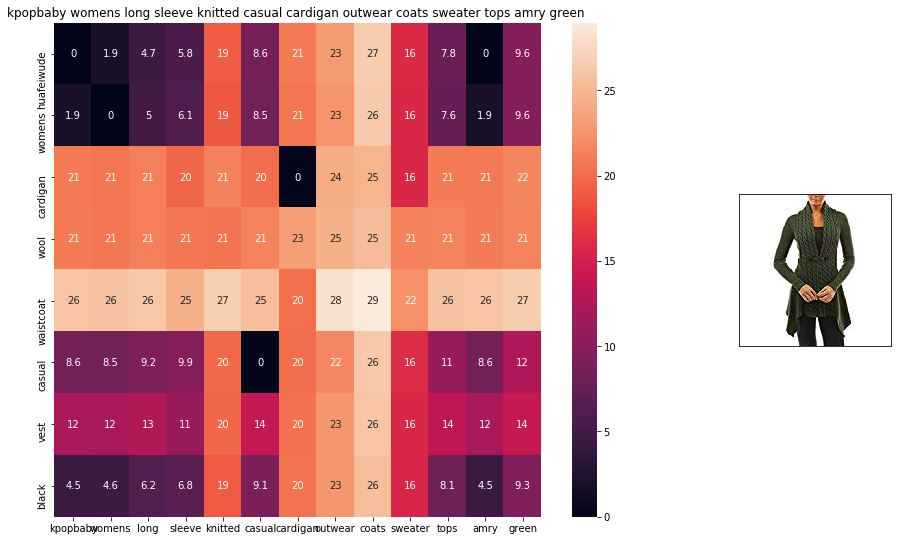

ASIN : B074LD7G7K
Brand : KpopBaby
euclidean distance from input : 4.35567


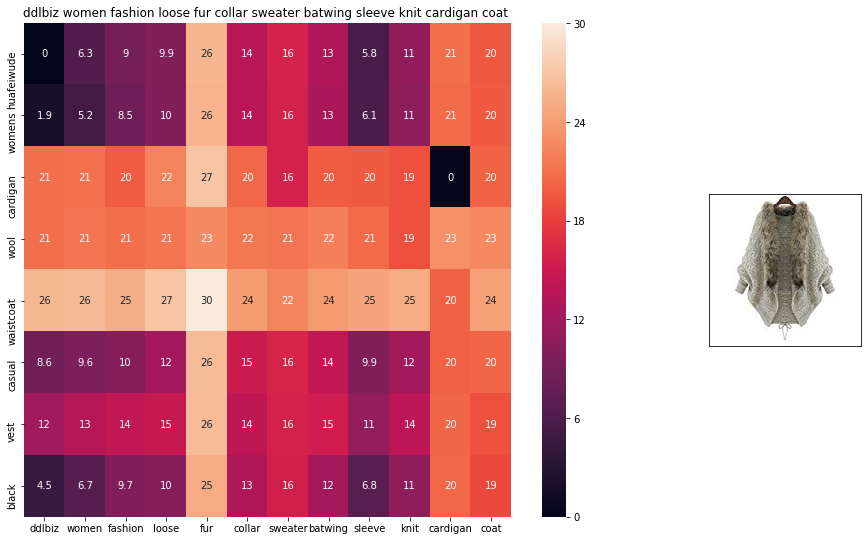

ASIN : B01MY76AQJ
Brand : DDLBiz
euclidean distance from input : 4.408304


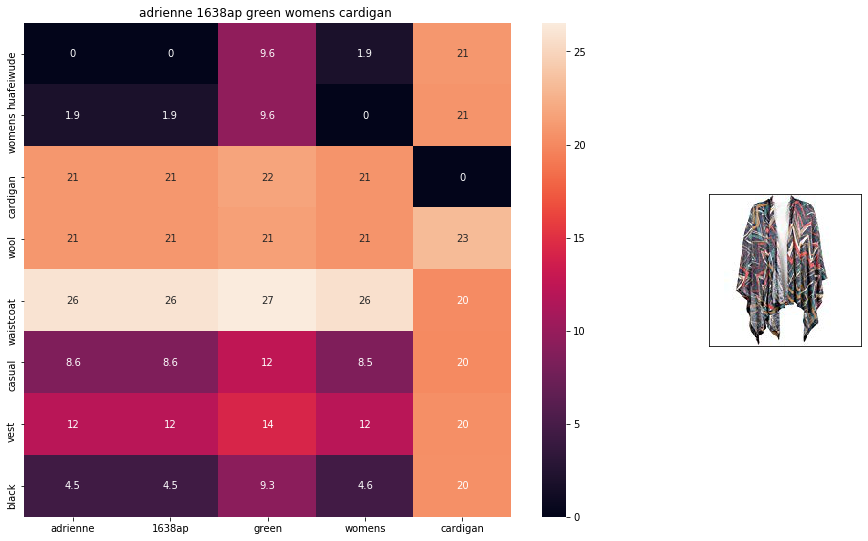

ASIN : B00O1HWO5W
Brand : Liuqiuhu
euclidean distance from input : 4.422664


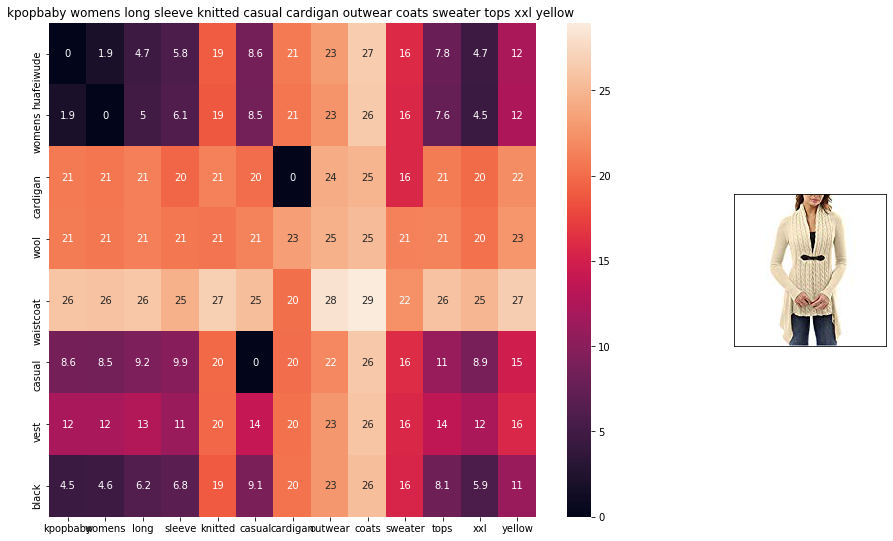

ASIN : B074LCPJJZ
Brand : KpopBaby
euclidean distance from input : 4.499772


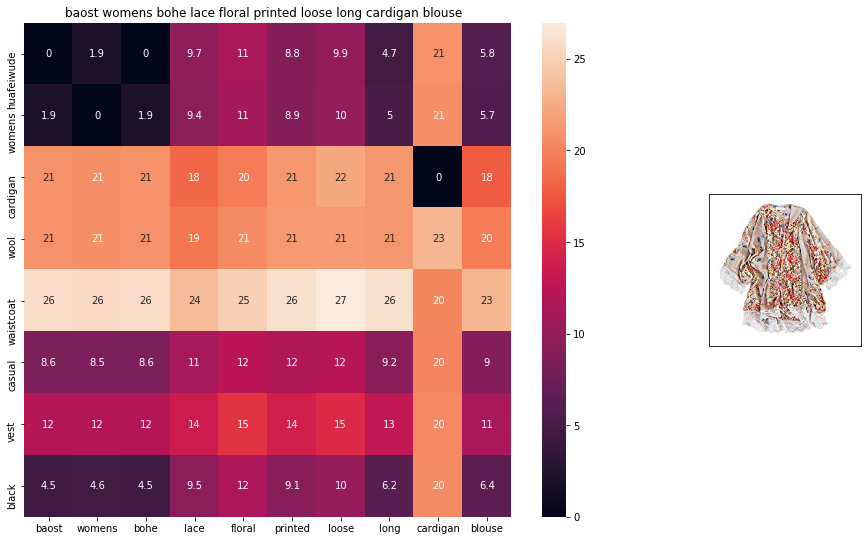

ASIN : B01GTA9352
Brand : Baost
euclidean distance from input : 4.5200267


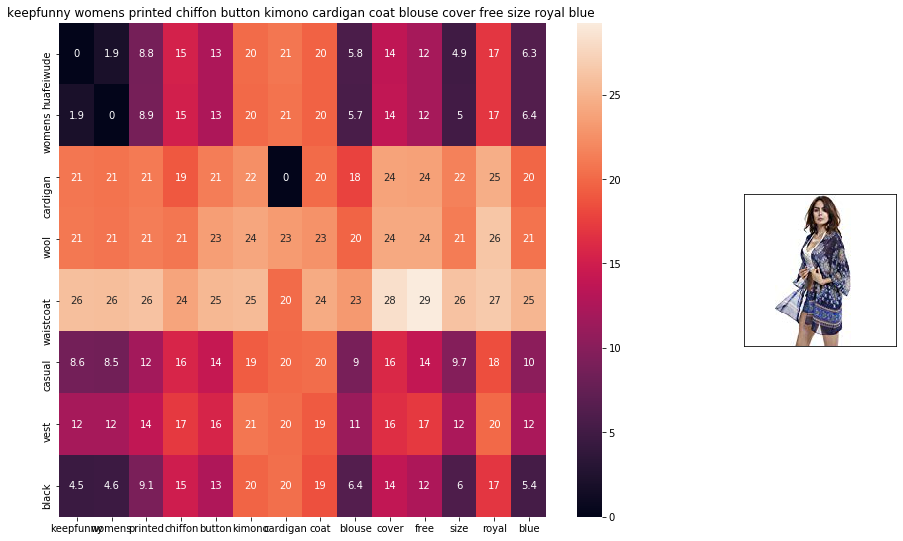

ASIN : B01IV2EEAK
Brand : KEEPFUNNY
euclidean distance from input : 4.5225873


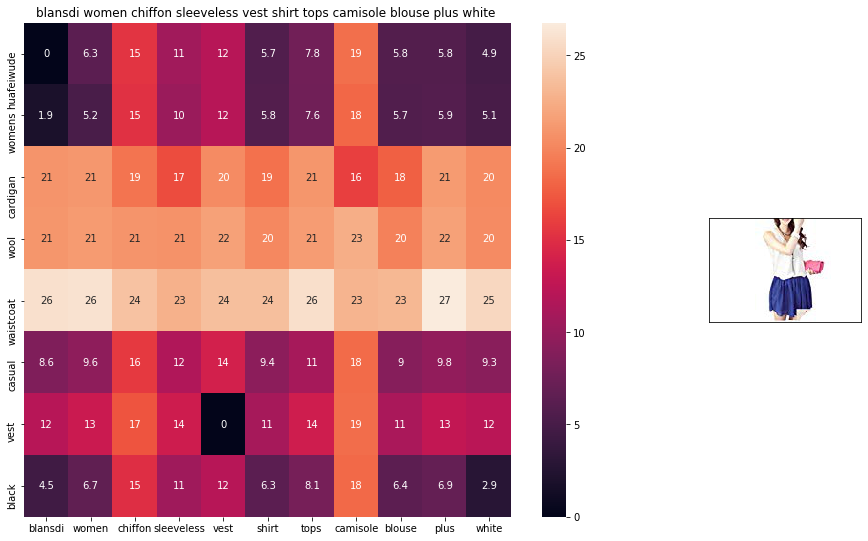

ASIN : B01AYVHQE2
Brand : Blansdi
euclidean distance from input : 4.534905


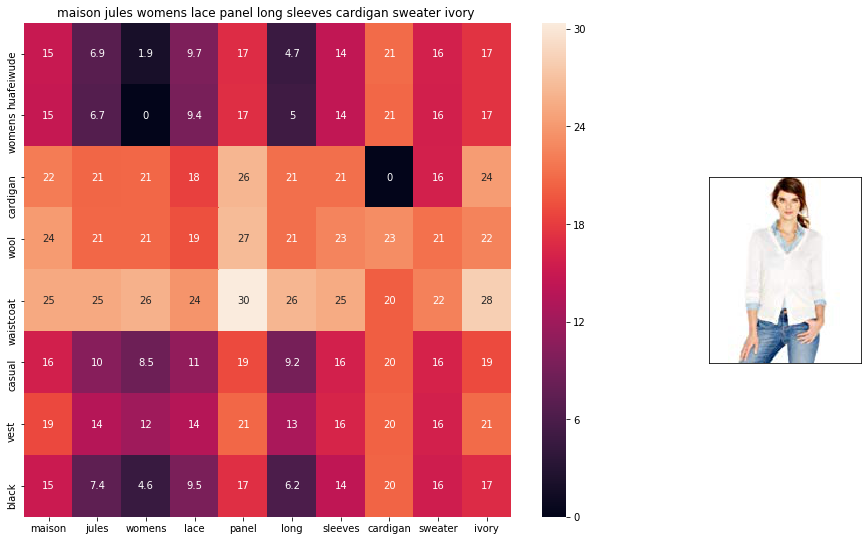

ASIN : B01DOKN4WS
Brand : Maison Jules
euclidean distance from input : 4.535721


In [31]:
def weighted_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0, len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

weighted_w2v_model(12566, 20)
#931
#12566
# in the give heat map, each cell contains the euclidean distance between words i, j

### [9.6] Weighted similarity using brand and color.

In [0]:
# some of the brand values are empty. 
# Need to replace Null with string "NULL"
data['brand'].fillna(value="Not given", inplace=True )

# replace spaces with hypen
brands = [x.replace(" ", "-") for x in data['brand'].values]
types = [x.replace(" ", "-") for x in data['product_type_name'].values]
colors = [x.replace(" ", "-") for x in data['color'].values]

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(brands)

type_vectorizer = CountVectorizer()
type_features = type_vectorizer.fit_transform(types)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(colors)

extra_features = hstack((brand_features, type_features, color_features)).tocsr()

In [0]:
import plotly.io as pio
pio.renderers.default = "colab"

In [0]:
import plotly 

def heat_map_w2v_brand(sentance1, sentance2, url, doc_id1, doc_id2, df_id1, df_id2, model):
    
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # df_id1: index of document1 in the data frame
    # df_id2: index of document2 in the data frame
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentance1, doc_id1, model)
    #s2_vec = np.array(#number_of_words_title2 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentance2, doc_id2, model)
    
    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)
   
    data_matrix = [['Asin','Brand', 'Color', 'Product type'],
               [data['asin'].loc[df_id1],brands[doc_id1], colors[doc_id1], types[doc_id1]], # input apparel's features
               [data['asin'].loc[df_id2],brands[doc_id2], colors[doc_id2], types[doc_id2]]] # recommonded apparel's features
    
    colorscale = [[0, '#1d004d'],[.5, '#f2e5ff'],[1, '#f2e5d1']] # to color the headings of each column 
    
    # we create a table with the data_matrix
    table = ff.create_table(data_matrix, index=True, colorscale=colorscale)

    
    # plot it with plotly
    plotly.offline.iplot(table, filename='simple_table')

        
    # devide whole figure space into 25 * 1:10 grids
    gs = gridspec.GridSpec(25, 15)
    fig = plt.figure(figsize=(25,5))
    
    # in first 25*10 grids we plot heatmap
    ax1 = plt.subplot(gs[:, :-5])
    # ploting the heap map based on the pairwise distances
    ax1 = sns.heatmap(np.round(s1_s2_dist,6), annot=True)
    # set the x axis labels as recommended apparels title
    ax1.set_xticklabels(sentance2.split())
    # set the y axis labels as input apparels title
    ax1.set_yticklabels(sentance1.split())
    # set title as recommended apparels title
    ax1.set_title(sentance2)

    # in last 25 * 10:15 grids we display image
    ax2 = plt.subplot(gs[:, 10:16])
    # we dont display grid lins and axis labels to images
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    
    # pass the url it display it
    display_img(url, ax2, fig)
    
    plt.show()

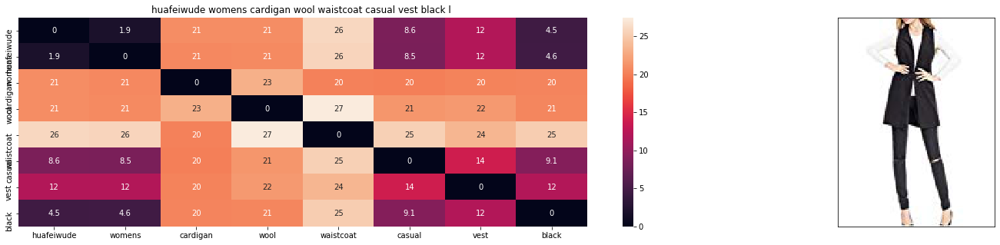

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 0.0


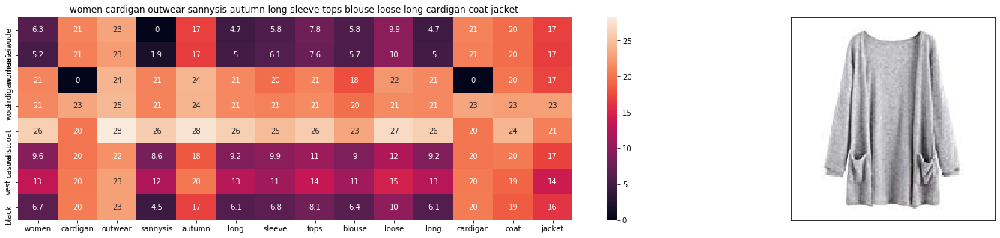

ASIN : B07473KFK1
Brand : Sannysis
euclidean distance from input : 2.8984806060791017


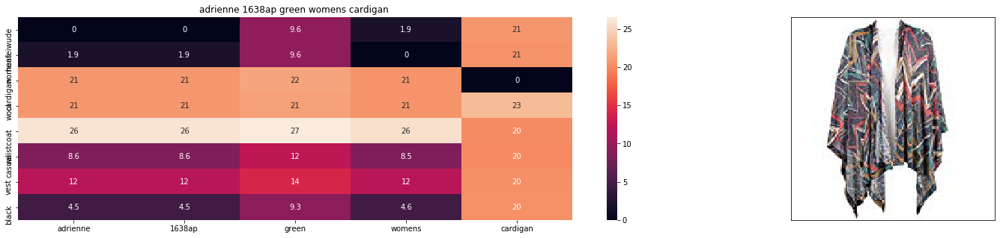

ASIN : B00O1HWO5W
Brand : Liuqiuhu
euclidean distance from input : 2.9184389116186766


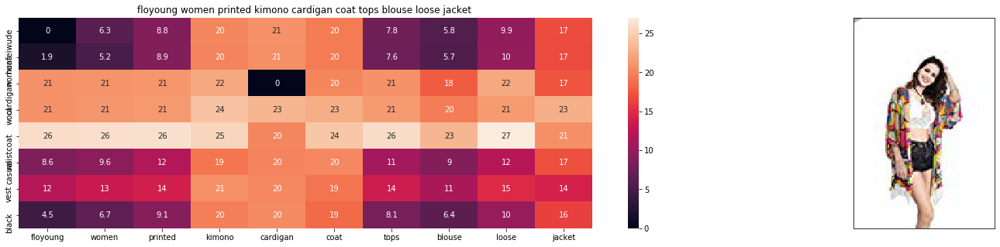

ASIN : B01D6EUG3W
Brand : FloYoung
euclidean distance from input : 2.9966798782348634


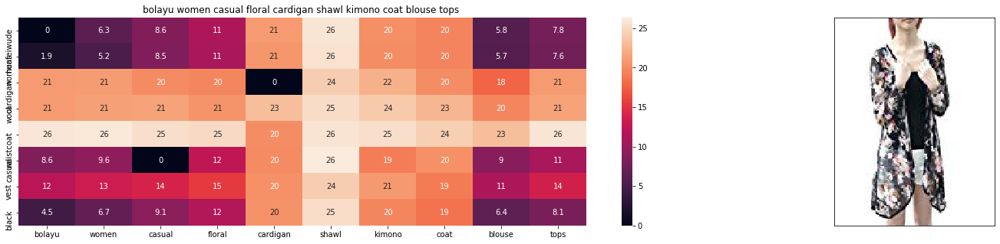

ASIN : B01F6UHWEU
Brand : Bolayu
euclidean distance from input : 3.0006389619726805


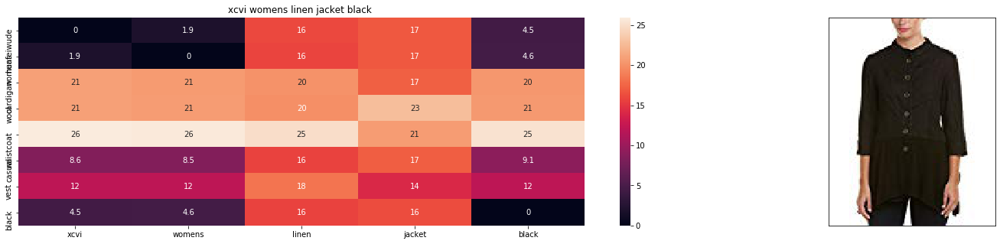

ASIN : B01M31Q4Z0
Brand : XCVI
euclidean distance from input : 3.0484086992163326


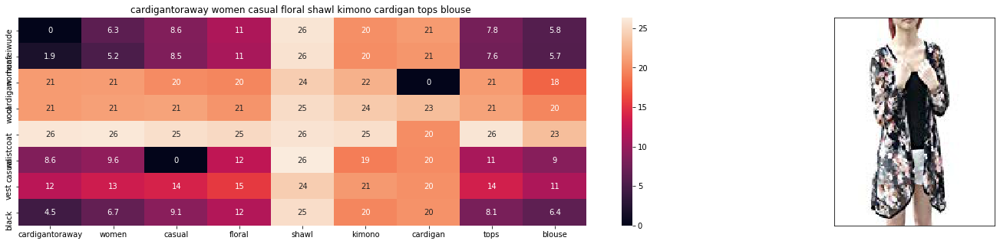

ASIN : B01CZMPCY4
Brand : Toraway
euclidean distance from input : 3.050865936459985


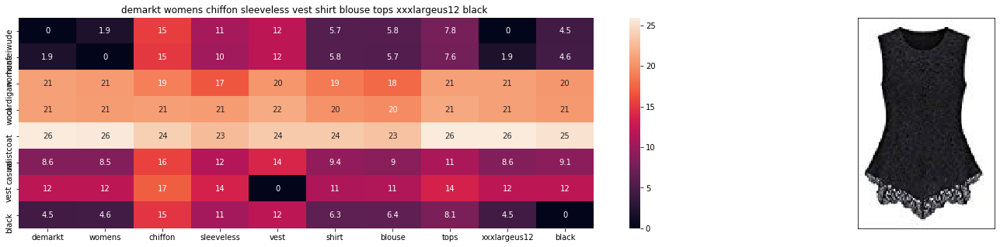

ASIN : B00JKCQZJE
Brand : Demarkt
euclidean distance from input : 3.081585693540063


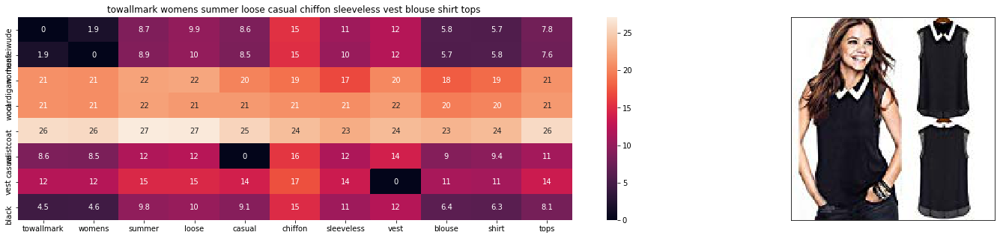

ASIN : B00QGEJ3MA
Brand : Towallmark
euclidean distance from input : 3.0982917787451414


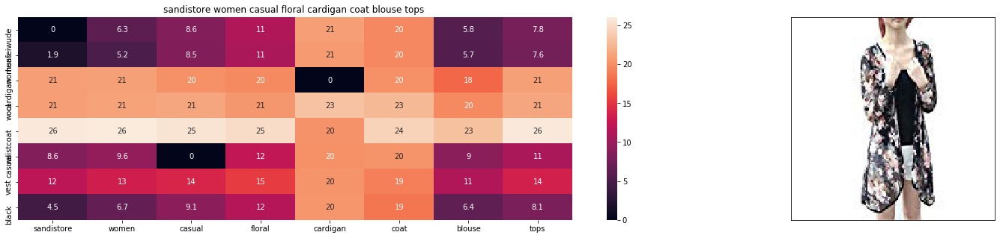

ASIN : B01AVX8IOU
Brand : Sandistore
euclidean distance from input : 3.1044492795824143


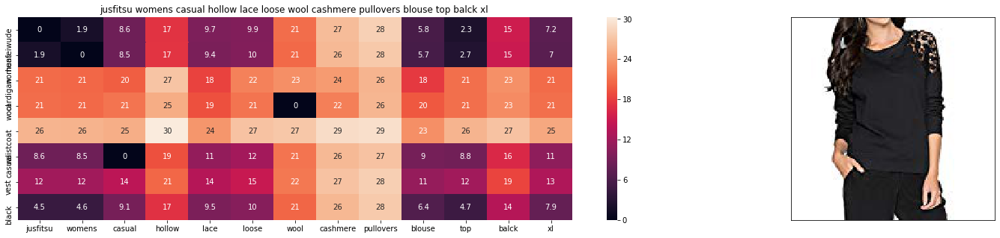

ASIN : B01N96GX38
Brand : Jusfitsu
euclidean distance from input : 3.1124135972876217


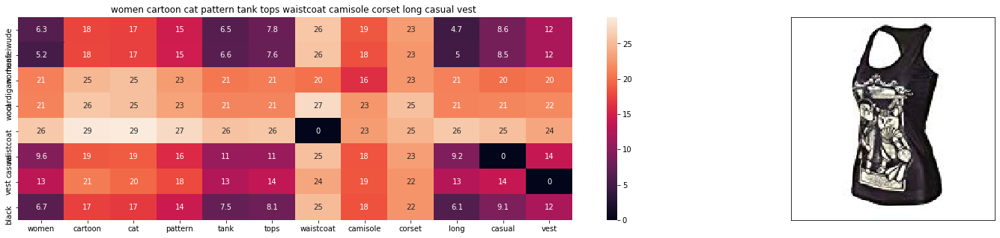

ASIN : B011R13YBM
Brand : Huayang
euclidean distance from input : 3.1135442733764647


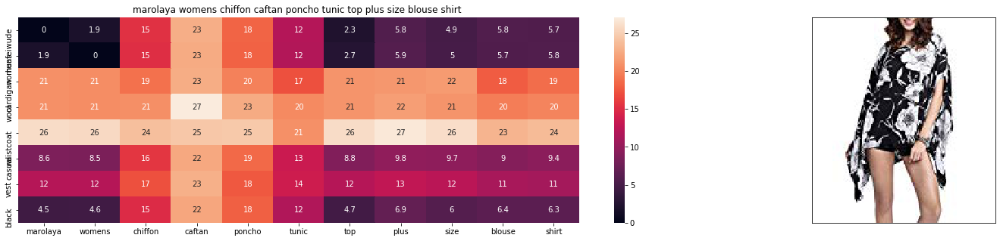

ASIN : B01CE40UW2
Brand : Marolaya
euclidean distance from input : 3.126744651975122


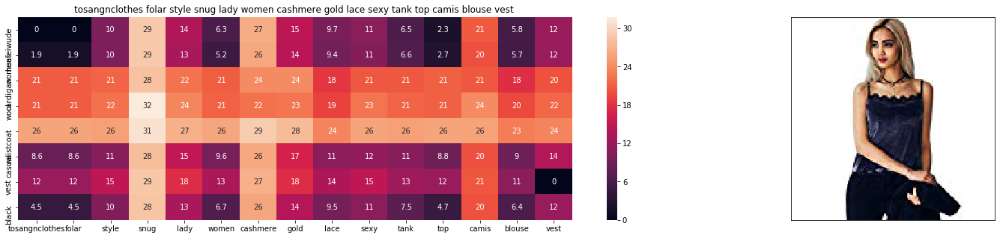

ASIN : B06XFRDH4J
Brand : Tosangn_Clothes
euclidean distance from input : 3.1292724611181884


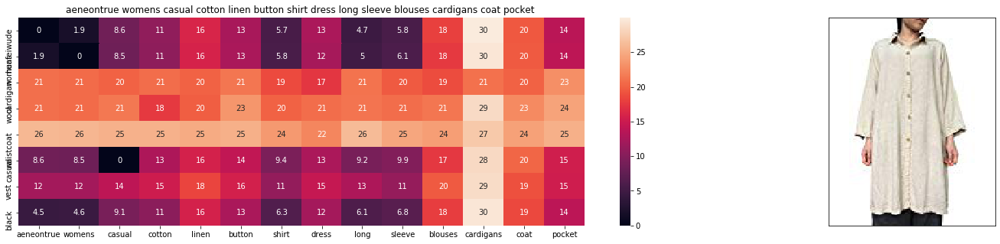

ASIN : B074V1K5QJ
Brand : Aeneontrue
euclidean distance from input : 3.1459396436571216


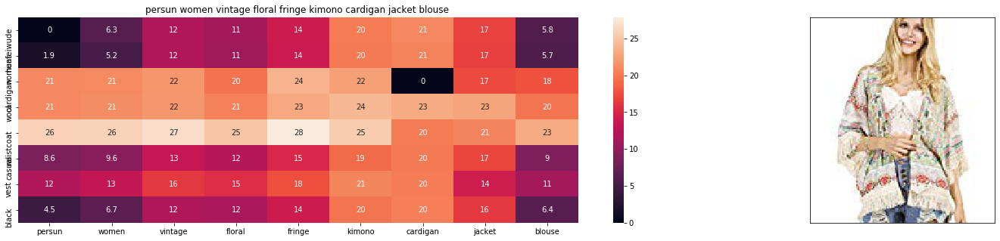

ASIN : B00Y26RSRQ
Brand : Persun
euclidean distance from input : 3.1488262176513673


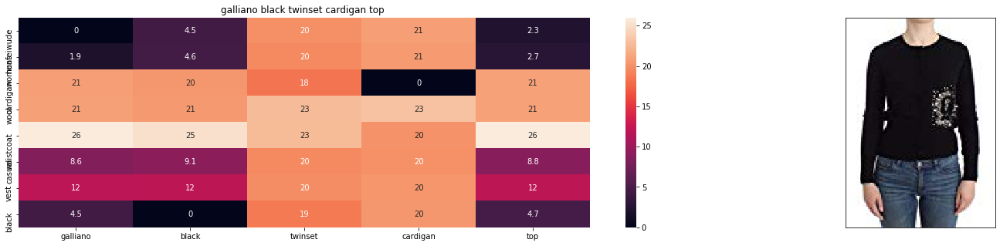

ASIN : B074G57HQJ
Brand : Galliano
euclidean distance from input : 3.158188819885254


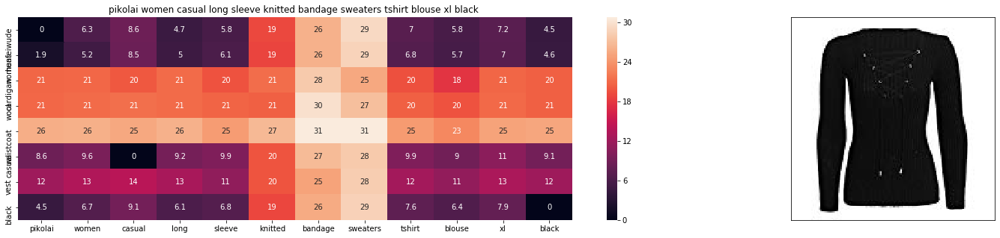

ASIN : B01LZ2B1HT
Brand : Pikolai
euclidean distance from input : 3.159334373654809


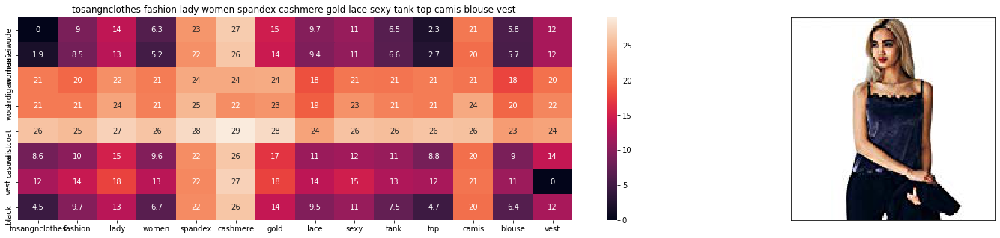

ASIN : B06XFFQLPL
Brand : Tosangn_Clothes
euclidean distance from input : 3.1688568117041256


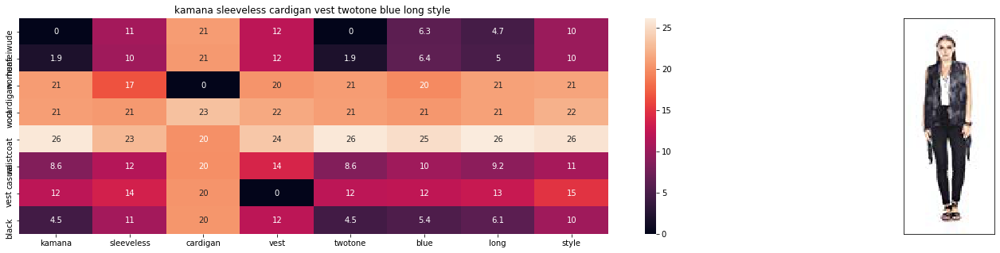

ASIN : B0751686K7
Brand : Kamana
euclidean distance from input : 3.177324751152331


In [35]:
def idf_w2v_brand(doc_id, w1, w2, num_results):
    # doc_id: apparel's id in given corpus
    # w1: weight for  w2v features
    # w2: weight for brand and color features

    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    idf_w2v_dist  = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))
    ex_feat_dist = pairwise_distances(extra_features, extra_features[doc_id])
    pairwise_dist   = (w1 * idf_w2v_dist +  w2 * ex_feat_dist)/float(w1 + w2)

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    

    for i in range(0, len(indices)):
        heat_map_w2v_brand(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i],df_indices[0], df_indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

idf_w2v_brand(12566, 5, 5, 20)
# in the give heat map, each cell contains the euclidean distance between words i, j

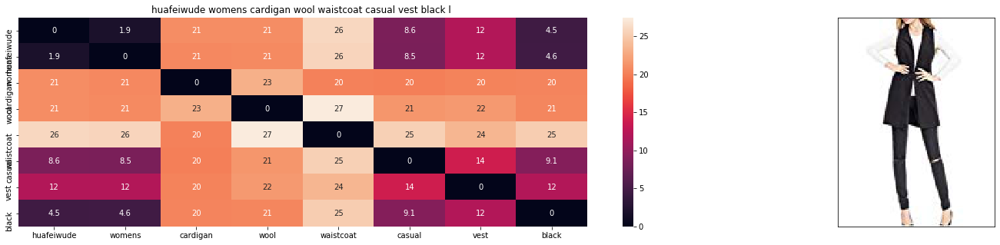

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 0.0


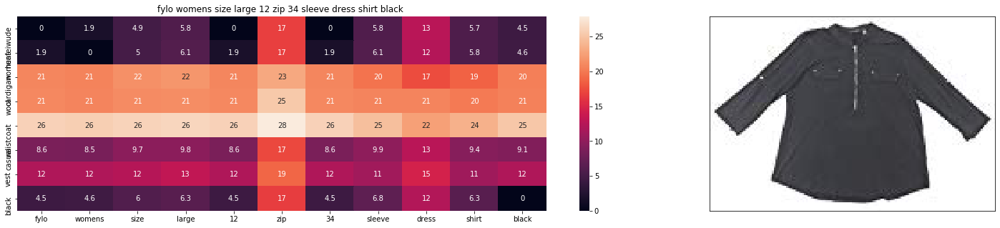

ASIN : B0718Y9J4M
Brand : f
euclidean distance from input : 1.4440810463645242


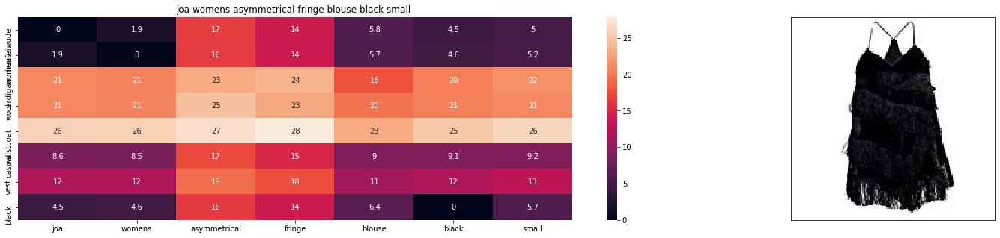

ASIN : B0721ZGF6S
Brand : J.O.A.
euclidean distance from input : 1.4896895321932706


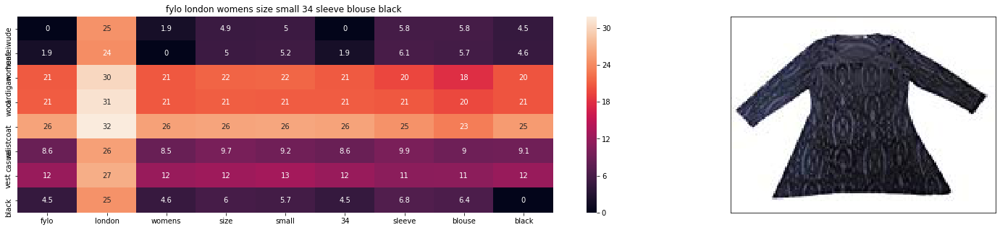

ASIN : B073HJRP1D
Brand : f
euclidean distance from input : 1.4966244784268465


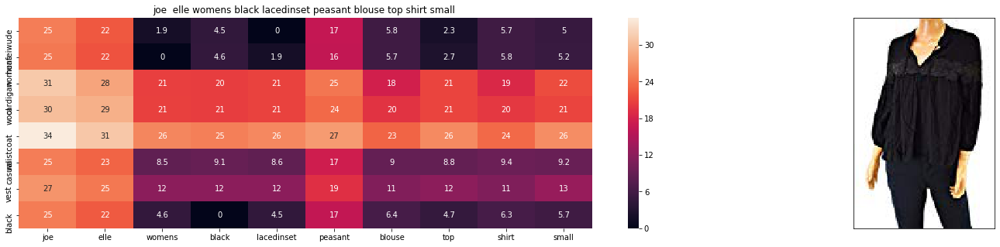

ASIN : B073GDVFT2
Brand : J&E
euclidean distance from input : 1.5201109452681107


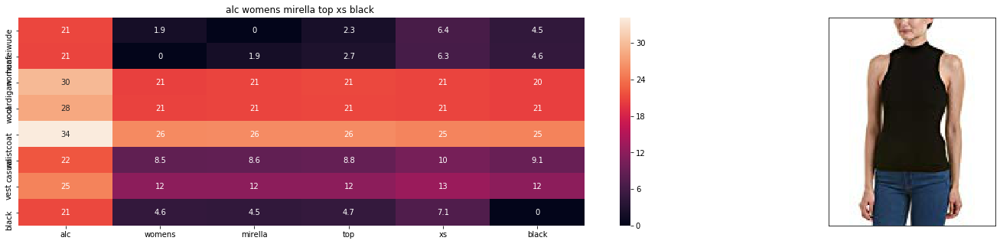

ASIN : B072N8CS7N
Brand : A.L.C.
euclidean distance from input : 1.6151734092018821


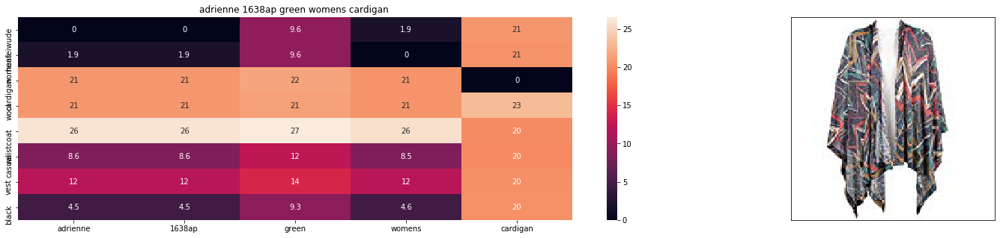

ASIN : B00O1HWO5W
Brand : Liuqiuhu
euclidean distance from input : 1.6877090804177464


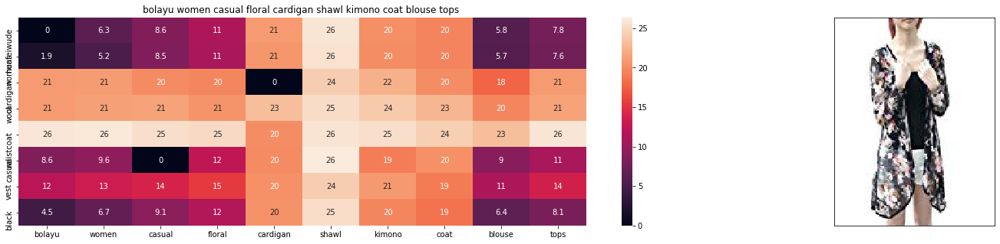

ASIN : B01F6UHWEU
Brand : Bolayu
euclidean distance from input : 1.7026545441184742


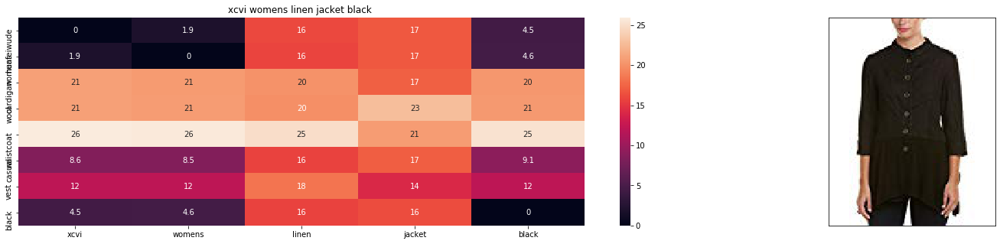

ASIN : B01M31Q4Z0
Brand : XCVI
euclidean distance from input : 1.7113399508900473


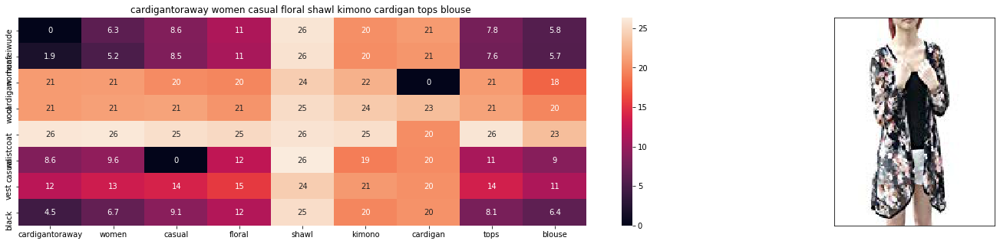

ASIN : B01CZMPCY4
Brand : Toraway
euclidean distance from input : 1.7117867212979843


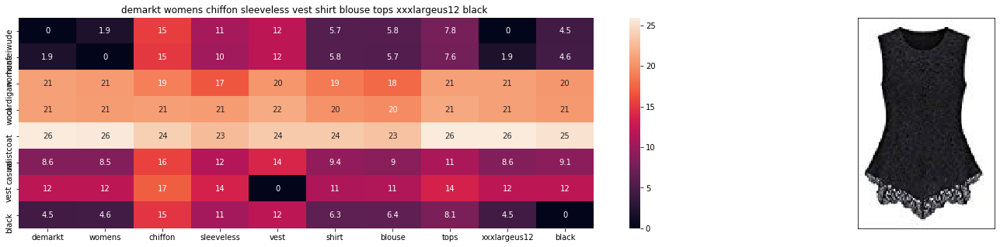

ASIN : B00JKCQZJE
Brand : Demarkt
euclidean distance from input : 1.7173721316761803


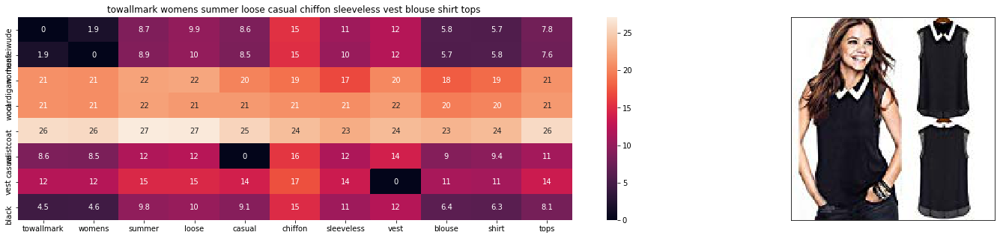

ASIN : B00QGEJ3MA
Brand : Towallmark
euclidean distance from input : 1.7204096017134671


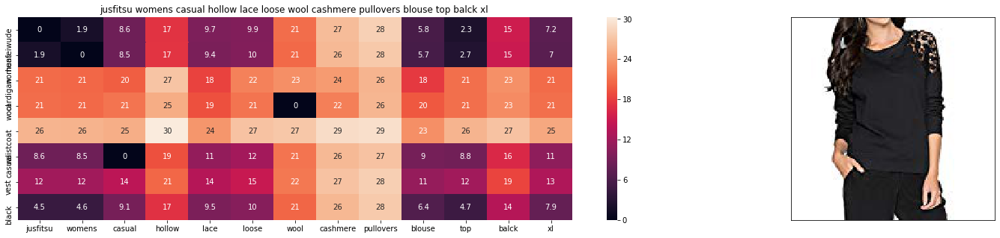

ASIN : B01N96GX38
Brand : Jusfitsu
euclidean distance from input : 1.7229772050848273


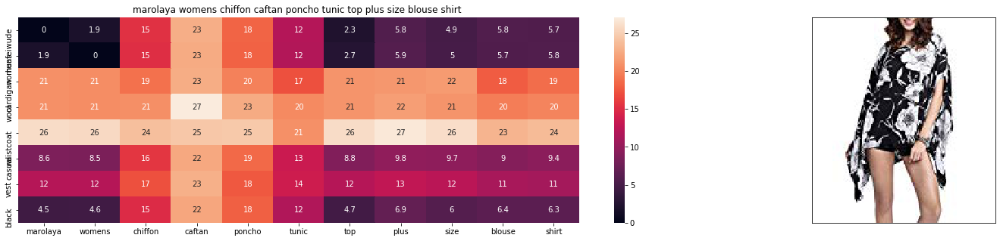

ASIN : B01CE40UW2
Brand : Marolaya
euclidean distance from input : 1.7255828513916454


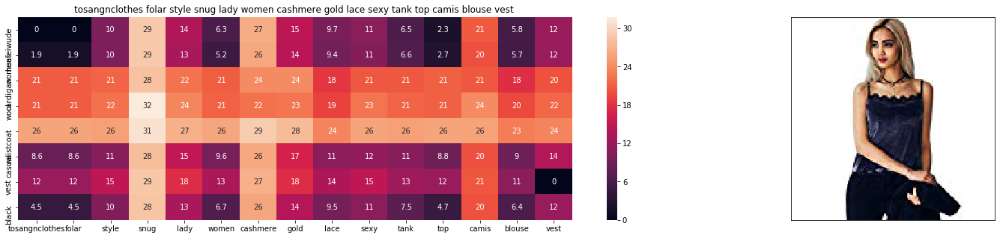

ASIN : B06XFRDH4J
Brand : Tosangn_Clothes
euclidean distance from input : 1.726042453054021


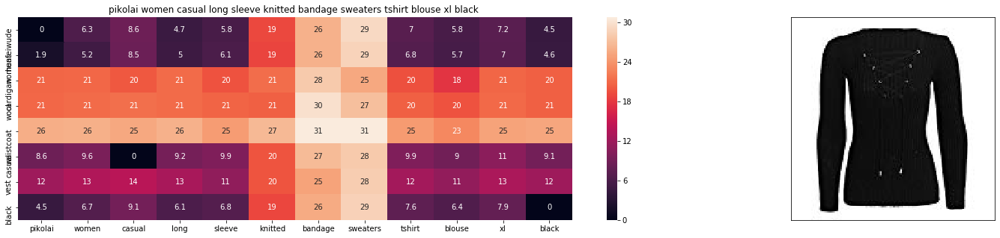

ASIN : B01LZ2B1HT
Brand : Pikolai
euclidean distance from input : 1.7315082553334067


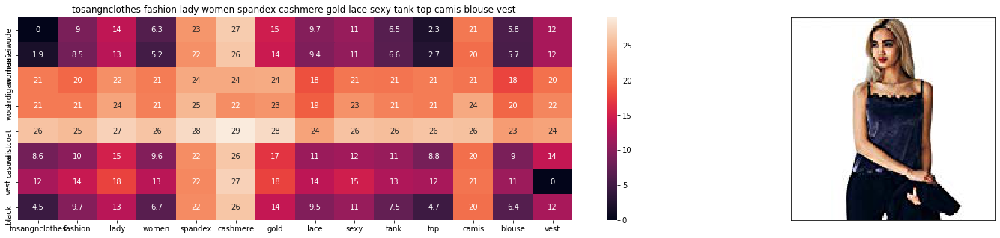

ASIN : B06XFFQLPL
Brand : Tosangn_Clothes
euclidean distance from input : 1.7332396077060097


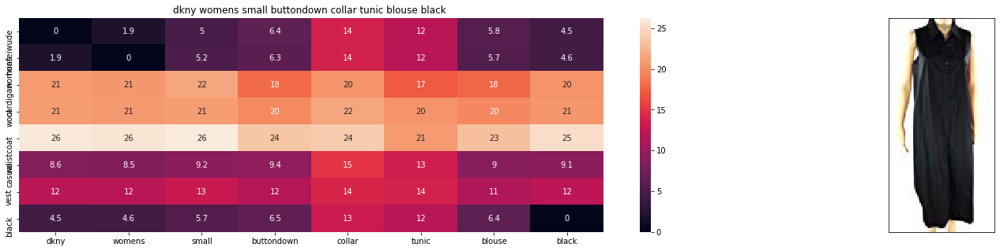

ASIN : B0716YWPN1
Brand : DKNY
euclidean distance from input : 1.7351465748690957


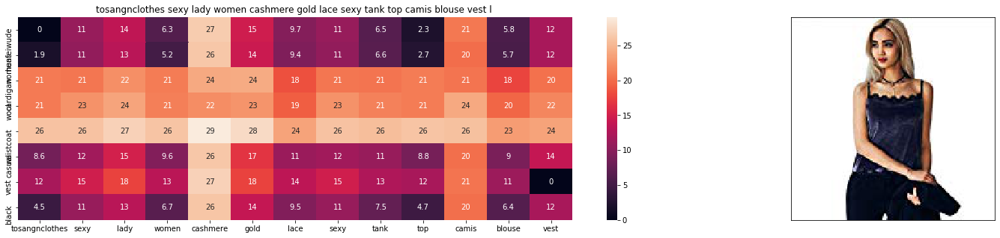

ASIN : B06XFWSQS1
Brand : Tosangn_Clothes
euclidean distance from input : 1.7366255329989786


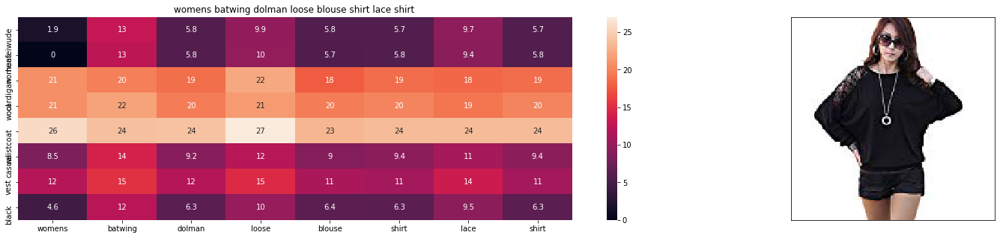

ASIN : B00OUENQ1W
Brand : Huawen
euclidean distance from input : 1.740802002281649


In [36]:
# brand and color weight =50
# title vector weight = 5

idf_w2v_brand(12566, 5, 50, 20)

# [10.2] Keras and Tensorflow to extract features

In [0]:
# !pip install tf-nightly-2.0-preview

In [0]:
import numpy as np
from tensorflow.python.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dropout, Flatten, Dense
from tensorflow.python.keras import applications
from sklearn.metrics import pairwise_distances
import matplotlib.pyplot as plt
import requests
from PIL import Image
import pandas as pd
import pickle

In [41]:
# https://gist.github.com/fchollet/f35fbc80e066a49d65f1688a7e99f069
# Code reference: https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html



# This code takes 40 minutes to run on a modern GPU (graphics card) 
# like Nvidia  1050.
# GPU (NVidia 1050): 0.175 seconds per image

# This codse takes 160 minutes to run on a high end i7 CPU
# CPU (i7): 0.615 seconds per image.

#Do NOT run this code unless you want to wait a few hours for it to generate output

# each image is converted into 25088 length dense-vector

'''

# dimensions of our images.
img_width, img_height = 224, 224

top_model_weights_path = '/content/drive/My Drive/amazon_fashion/bottleneck_fc_model2.h5'
train_data_dir = '/content/drive/My Drive/amazon_fashion/16k_images/'
nb_train_samples = 16042
epochs = 50
batch_size = 1


def save_bottlebeck_features():
    
    #Function to compute VGG-16 CNN for image feature extraction.
    
    asins = []
    datagen = ImageDataGenerator(rescale=1. / 255)
    
    # build the VGG16 network
    model = applications.VGG16(include_top=False, weights='imagenet')
    generator = datagen.flow_from_directory(
        train_data_dir,
        target_size=(img_width, img_height),
        batch_size=batch_size,
        class_mode=None,
        shuffle=False)

    for i in generator.filenames:
        asins.append(i[2:-5])

    bottleneck_features_train = model.predict_generator(generator, nb_train_samples // batch_size)
    bottleneck_features_train = bottleneck_features_train.reshape((16042,25088))
    
    np.save(open('/content/drive/My Drive/amazon_fashion/16k_data_cnn_features2.npy', 'wb'), bottleneck_features_train)
    np.save(open('/content/drive/My Drive/amazon_fashion/16k_data_cnn_feature_asins2.npy', 'wb'), np.array(asins))
    

save_bottlebeck_features()

'''



"\n\n# dimensions of our images.\nimg_width, img_height = 224, 224\n\ntop_model_weights_path = '/content/drive/My Drive/amazon_fashion/bottleneck_fc_model2.h5'\ntrain_data_dir = '/content/drive/My Drive/amazon_fashion/16k_images/'\nnb_train_samples = 16042\nepochs = 50\nbatch_size = 1\n\n\ndef save_bottlebeck_features():\n    \n    #Function to compute VGG-16 CNN for image feature extraction.\n    \n    asins = []\n    datagen = ImageDataGenerator(rescale=1. / 255)\n    \n    # build the VGG16 network\n    model = applications.VGG16(include_top=False, weights='imagenet')\n    generator = datagen.flow_from_directory(\n        train_data_dir,\n        target_size=(img_width, img_height),\n        batch_size=batch_size,\n        class_mode=None,\n        shuffle=False)\n\n    for i in generator.filenames:\n        asins.append(i[2:-5])\n\n    bottleneck_features_train = model.predict_generator(generator, nb_train_samples // batch_size)\n    bottleneck_features_train = bottleneck_features_

# [10.3] Visual features based product similarity.

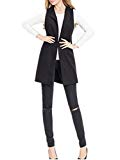

Product Title:  huafeiwude womens cardigan wool waistcoat casual vest black l 
Euclidean Distance from input image: 7.3253113e-06
Amazon Url: www.amzon.com/dp/B01MT96PXZ


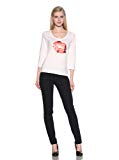

Product Title:  michael simon womens 34 sleeve scoop neck kiss top white us 
Euclidean Distance from input image: 36.25709
Amazon Url: www.amzon.com/dp/B005DGABOQ


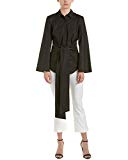

Product Title:  cmeo womens collective fiction open back tie shirt black 
Euclidean Distance from input image: 39.656044
Amazon Url: www.amzon.com/dp/B071GTYV9W


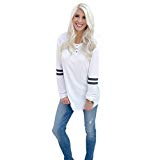

Product Title:  perman womens long sleeve round neck splice shirt blouse tops pullover xl white 
Euclidean Distance from input image: 40.512398
Amazon Url: www.amzon.com/dp/B01LZEZIA6


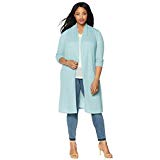

Product Title:  g giuliana rib knit boyfriend cardigan 522292 aqua ivory xs 
Euclidean Distance from input image: 40.889053
Amazon Url: www.amzon.com/dp/B0759YFWTC


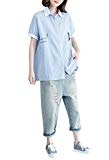

Product Title:  bandi das womens oversized cotton button shirt lapel blue stripe cat embroidery 
Euclidean Distance from input image: 40.917774
Amazon Url: www.amzon.com/dp/B074X1S79C


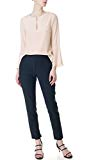

Product Title:  tibi womens silk split neck belle top sz 10 apricot 270026e 
Euclidean Distance from input image: 41.016262
Amazon Url: www.amzon.com/dp/B01N6SX0RP


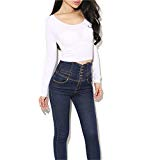

Product Title:  womens sexy bare midriff tops breathable oneck long sleeve slim tshirt 
Euclidean Distance from input image: 41.035725
Amazon Url: www.amzon.com/dp/B01MRGT3EF


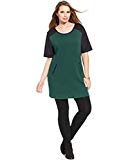

Product Title:  styleco women zippered color blocked tunic plus size 1x teal quarry 
Euclidean Distance from input image: 41.426403
Amazon Url: www.amzon.com/dp/B014WYUDM4


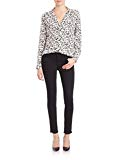

Product Title:  equipment adalyn leopard print silk shirt blouse bright whitexs 
Euclidean Distance from input image: 41.4628
Amazon Url: www.amzon.com/dp/B01N4T6Q9Z


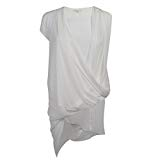

Product Title:  gold hawk womens asymmetrical silk tank white large 
Euclidean Distance from input image: 41.50517
Amazon Url: www.amzon.com/dp/B01MY7BA8I


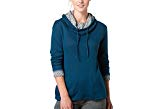

Product Title:  toad  co womens profundo pullover blue abyss xsmall 
Euclidean Distance from input image: 41.766125
Amazon Url: www.amzon.com/dp/B018B5QQV2


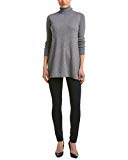

Product Title:  magaschoni womens cashmere tunic 
Euclidean Distance from input image: 41.810955
Amazon Url: www.amzon.com/dp/B01MY1ZZUS


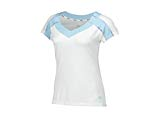

Product Title:  womens flirty cap sleeve top white xsmall 
Euclidean Distance from input image: 41.851746
Amazon Url: www.amzon.com/dp/B00U7PRVEG


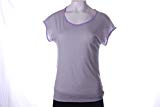

Product Title:  jenni short sleeve top bright lilac 
Euclidean Distance from input image: 41.882786
Amazon Url: www.amzon.com/dp/B01HFP47A6


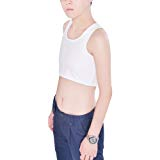

Product Title:  les lesbian tomboy short vest chest binder tops white 
Euclidean Distance from input image: 41.91472
Amazon Url: www.amzon.com/dp/B00F37JG64


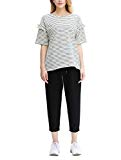

Product Title:  latorila short sleeve striped shirt women cotton crewneck casual tops black white 
Euclidean Distance from input image: 41.934067
Amazon Url: www.amzon.com/dp/B072XCRH81


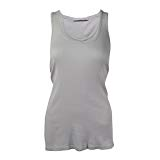

Product Title:  skin womens ribbed reactive tank moon light 2 
Euclidean Distance from input image: 41.961205
Amazon Url: www.amzon.com/dp/B072N8Y6SX


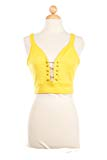

Product Title:  bangbangusa women bustier metal criss cross open back crop top 
Euclidean Distance from input image: 42.00415
Amazon Url: www.amzon.com/dp/B06XV37BS4


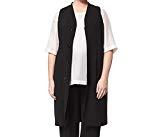

Product Title:  marina rinaldi womens ginseng button front vest 22w  31 black 
Euclidean Distance from input image: 42.040543
Amazon Url: www.amzon.com/dp/B0749RZFYC


In [42]:
#load the features and corresponding ASINS info.
bottleneck_features_train = np.load('/content/drive/My Drive/amazon_fashion/16k_data_cnn_features.npy')
asins = np.load('/content/drive/My Drive/amazon_fashion/16k_data_cnn_feature_asins.npy')
asins = list(asins)

# load the original 16K dataset
data = pd.read_pickle('/content/drive/My Drive/amazon_fashion/pickels/16k_apperal_data_preprocessed')
df_asins = list(data['asin'])


from IPython.display import display, Image, SVG, Math, YouTubeVideo


#get similar products using CNN features (VGG-16)
def get_similar_products_cnn(doc_id, num_results):
    doc_id = asins.index(df_asins[doc_id])
    pairwise_dist = pairwise_distances(bottleneck_features_train, bottleneck_features_train[doc_id].reshape(1,-1))

    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    for i in range(len(indices)):
        rows = data[['medium_image_url','title']].loc[data['asin']==asins[indices[i]]]
        for indx, row in rows.iterrows():
            display(Image(url=row['medium_image_url'], embed=True))
            print('Product Title: ', row['title'])
            print('Euclidean Distance from input image:', pdists[i])
            print('Amazon Url: www.amzon.com/dp/'+ asins[indices[i]])

get_similar_products_cnn(12566, 20)


### IDF w2v feature + Extra feature + Image feature

In [43]:
data.shape

(16434, 7)

In [44]:
len(asins)

16042

In [45]:
len(bottleneck_features_train)

16042

In [46]:
asins_in_df = list(data['asin'])
len(asins_in_df)

16434

In [47]:
asins_in_img = asins
len(asins_in_img)

16042

In [48]:
asins_intersection = set(asins_in_df) & set(asins_in_img)
len(asins_intersection)

16034

In [0]:
# we have image feature of size 16042 and all other features of size 16434. we need to balance it.
data2 = data.loc[data['asin'].isin(asins_intersection)]


In [50]:
data2.shape

(16034, 7)

In [0]:
img_vectors = [i for i in bottleneck_features_train]

In [52]:
len(img_vectors)

16042

In [0]:
img_df = pd.DataFrame({'asin':asins,'img_vector':img_vectors})


In [54]:
img_df.shape

(16042, 2)

In [55]:
final_image_vectors = img_df['img_vector'].loc[img_df['asin'].isin(asins_intersection)]
final_image_vectors = list(final_image_vectors)
len(final_image_vectors)

16034

In [0]:
# some of the brand values are empty. 
# Need to replace Null with string "NULL"
data2['brand'].fillna(value="Not given", inplace=True )

# replace spaces with hypen
brands = [x.replace(" ", "-") for x in data2['brand'].values]
types = [x.replace(" ", "-") for x in data2['product_type_name'].values]
colors = [x.replace(" ", "-") for x in data2['color'].values]

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(brands)

type_vectorizer = CountVectorizer()
type_features = type_vectorizer.fit_transform(types)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(colors)

extra_features2 = hstack((brand_features, type_features, color_features)).tocsr()

In [57]:
extra_features2.shape

(16034, 5733)

In [0]:
doc_id = 0
w2v_title_weight2 = []
# for every title we build a weighted vector representation
for i in data2['title']:
    w2v_title_weight2.append(build_avg_vec(i, 300, doc_id,'weighted'))
    doc_id += 1
# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
w2v_title_weight2 = np.array(w2v_title_weight2)

In [59]:
len(w2v_title_weight2)

16034

In [0]:
def idf_w2v_brand_img(doc_id, num_results, w1, w2,w3):
    # doc_id: apparel's id in given corpus
    # w1: weight for  w2v features
    # w2: weight for brand and color features

    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    idf_w2v_dist  = pairwise_distances(w2v_title_weight2, w2v_title_weight2[doc_id].reshape(1,-1))
    ex_feat_dist = pairwise_distances(extra_features2, extra_features2[doc_id])
    bottleneck_features_train_dist = pairwise_distances(final_image_vectors, final_image_vectors[doc_id].reshape(1, -1))

    


    pairwise_dist   = (w1 * idf_w2v_dist +  w2 * ex_feat_dist + w3 * bottleneck_features_train_dist)/float(w1 + w2 +w3)

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    

    for i in range(0, len(indices)):
        heat_map_w2v_brand(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i],df_indices[0], df_indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)


# in the give heat map, each cell contains the euclidean distance between words i, j

### Same Weightage to all features

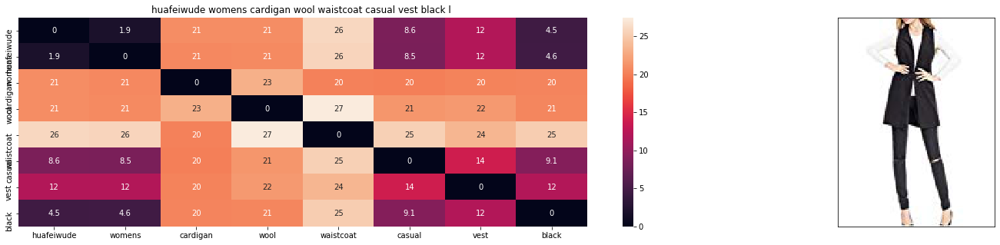

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 1.7995072994381189e-06


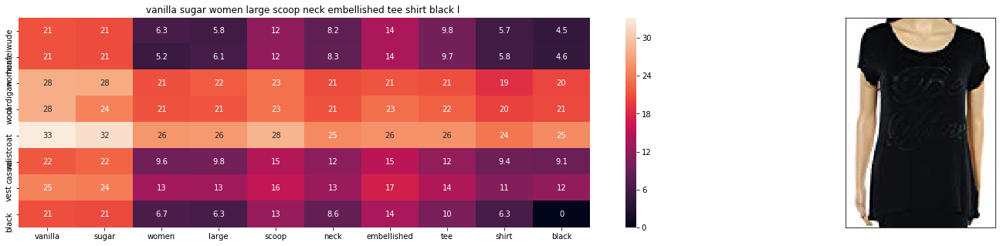

ASIN : B074MJVH4S
Brand : Vanilla Sugar
euclidean distance from input : 0.9618688466971276


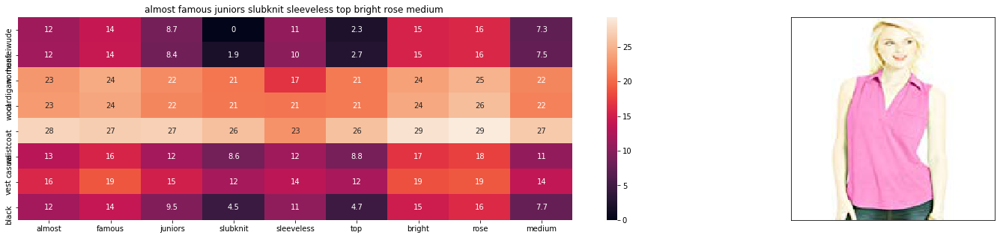

ASIN : B01CO4GLPM
Brand : Almost Famous
euclidean distance from input : 16.86815737399696


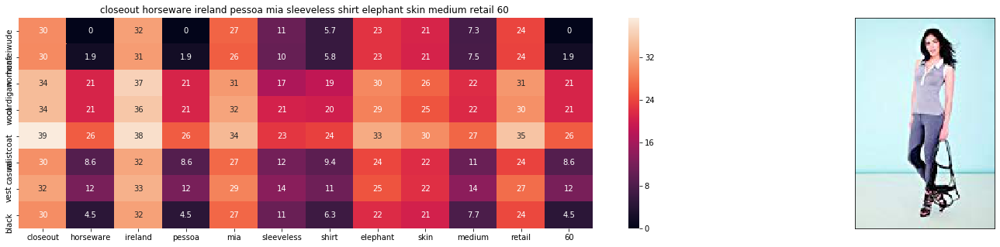

ASIN : B00D46ZH50
Brand : Pessoa by Horseware
euclidean distance from input : 16.938008793751674


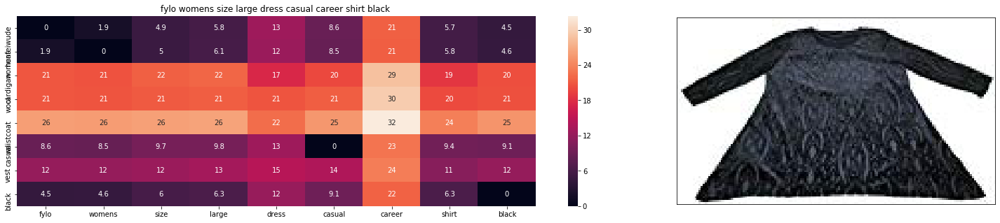

ASIN : B06XQ89MB3
Brand : Fylo
euclidean distance from input : 17.080081992332087


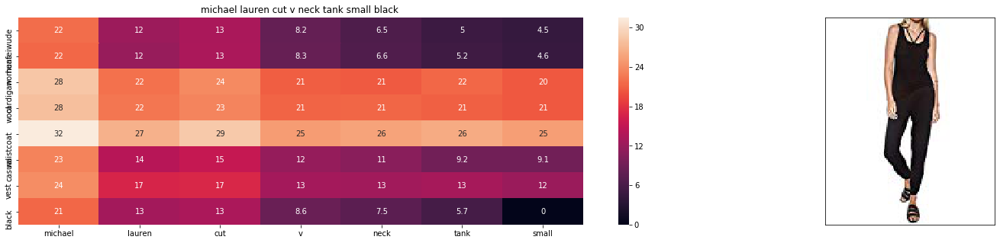

ASIN : B074W37H4P
Brand : Michael Lauren
euclidean distance from input : 17.091535409532504


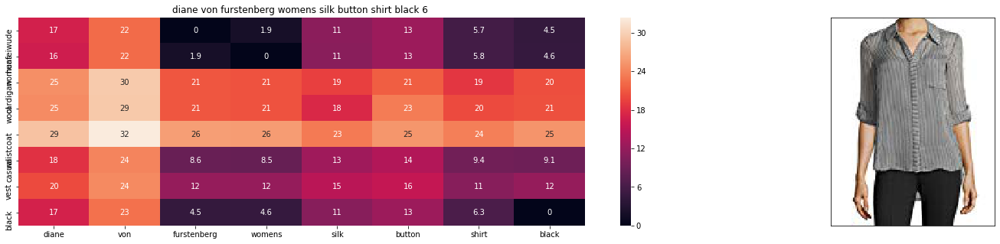

ASIN : B074NBGLK7
Brand : Diane von Furstenberg
euclidean distance from input : 17.16724586510908


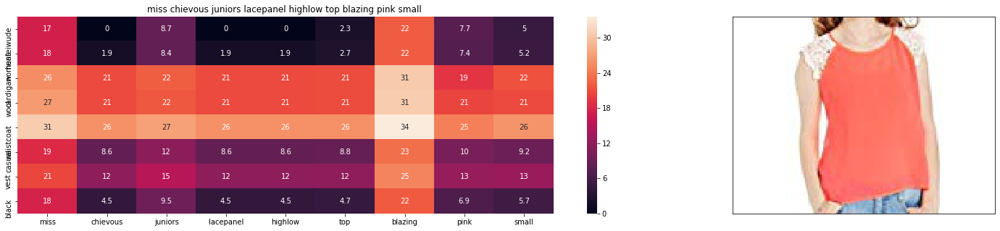

ASIN : B01JKT0QQO
Brand : Miss Chievous
euclidean distance from input : 17.250626945736524


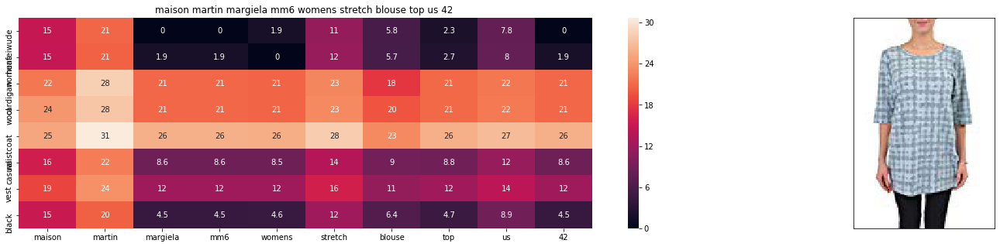

ASIN : B0175E4K2C
Brand : Maison Martin Margiela
euclidean distance from input : 17.428103653830803


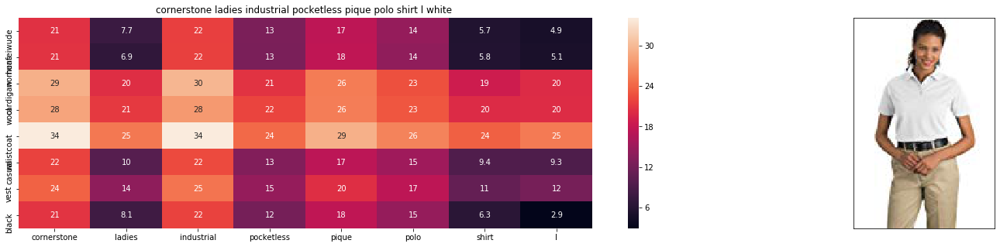

ASIN : B016WMNL0K
Brand : Cornerstone
euclidean distance from input : 17.43996598776209


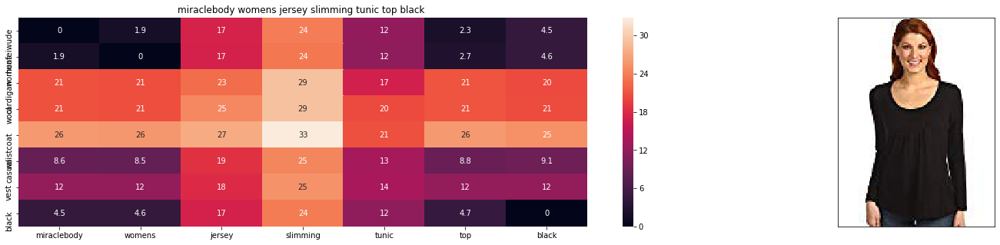

ASIN : B0059GPDDE
Brand : Miraclebody by Miraclesuit
euclidean distance from input : 17.459413751207308


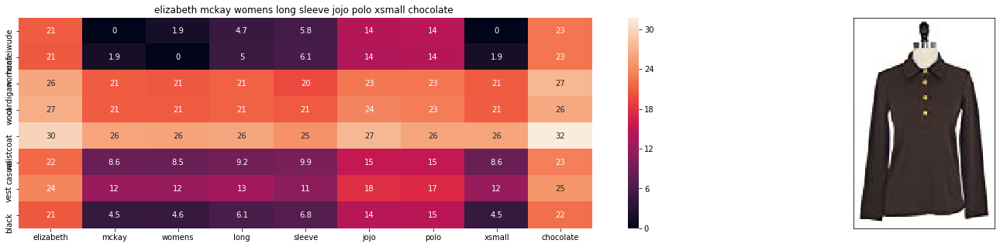

ASIN : B0184ROIQ2
Brand : Elizabeth McKay
euclidean distance from input : 17.462601902515836


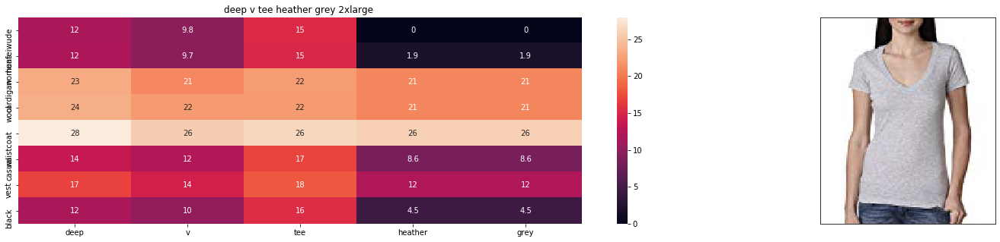

ASIN : B0085EX12M
Brand : Next Level Apparel
euclidean distance from input : 17.520796076697625


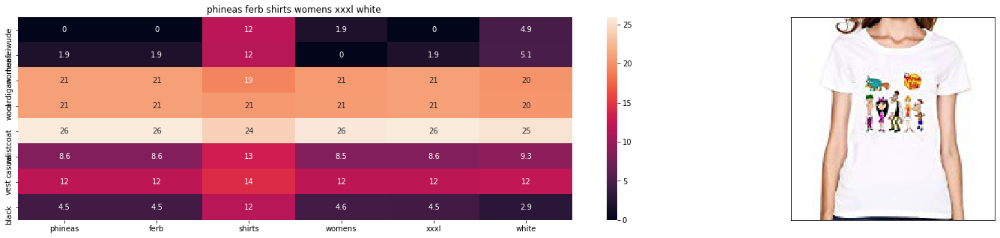

ASIN : B01KFGSUVE
Brand : MajinaHerrera
euclidean distance from input : 17.58120095176612


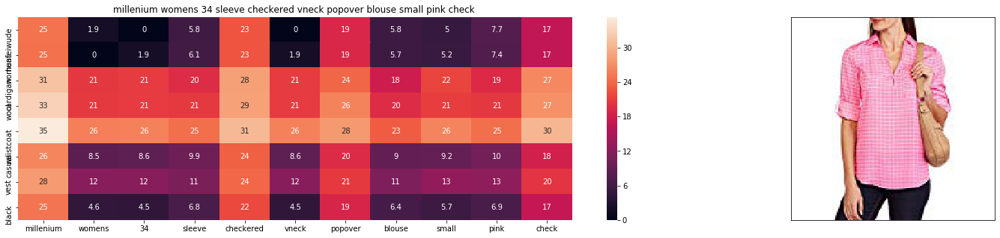

ASIN : B01N56V2HS
Brand : Millenium
euclidean distance from input : 17.628458023312206


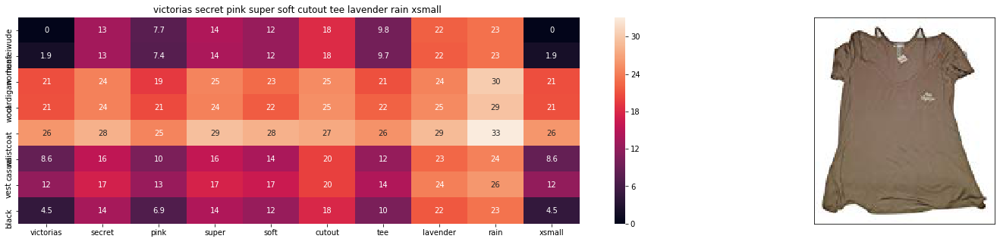

ASIN : B071HD2LDB
Brand : V.Secret
euclidean distance from input : 17.628831354777017


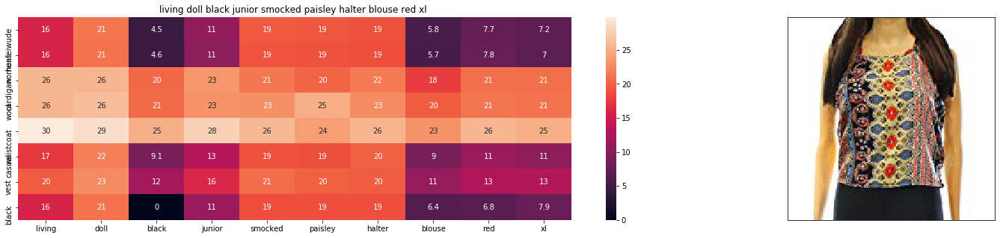

ASIN : B06Y5BJ1X5
Brand : Living Doll
euclidean distance from input : 17.64120394883945


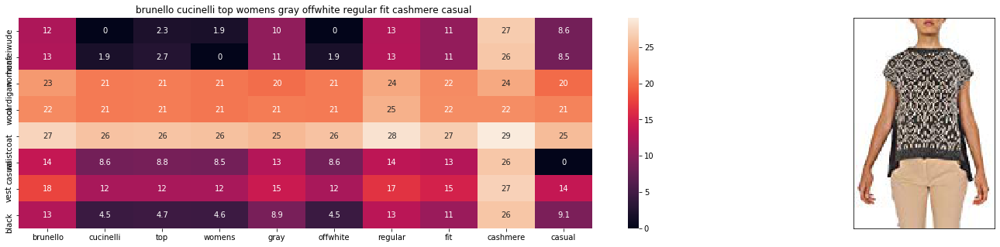

ASIN : B074Z714C3
Brand : Brunello Cucinelli
euclidean distance from input : 17.6624647778695


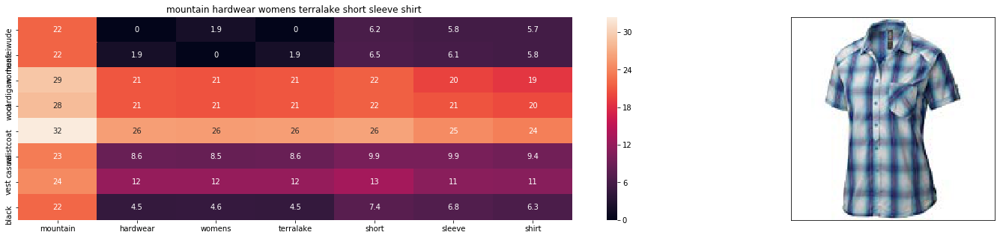

ASIN : B00L1R7D06
Brand : Mountain Hardwear
euclidean distance from input : 17.678859789232686


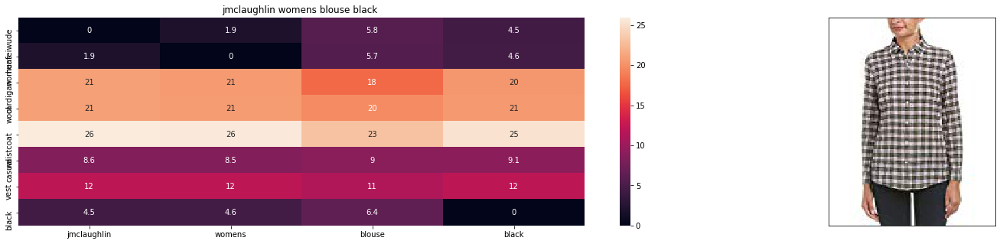

ASIN : B074KN55WS
Brand : J. McLaughlin
euclidean distance from input : 17.707089712310985


In [64]:
idf_w2v_brand_img(12566, 20, 5, 5,5)

### Given more weightage to idfw2v feature  
### W(idfw2v) > W(extra) = W(Image)

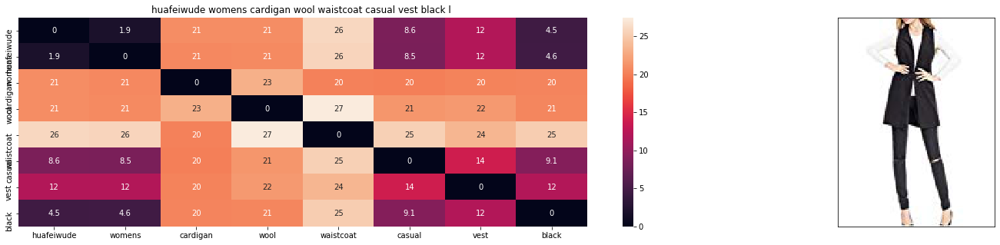

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 3.030222918217381e-07


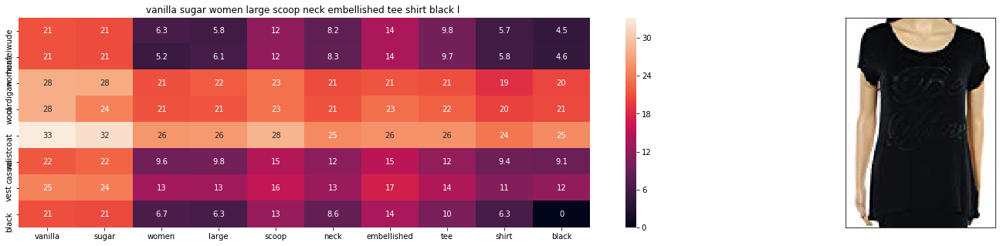

ASIN : B074MJVH4S
Brand : Vanilla Sugar
euclidean distance from input : 0.5237376432091851


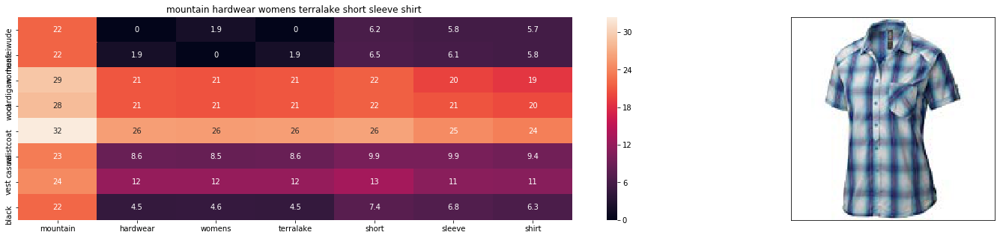

ASIN : B00L1R7D06
Brand : Mountain Hardwear
euclidean distance from input : 2.9645240599182374


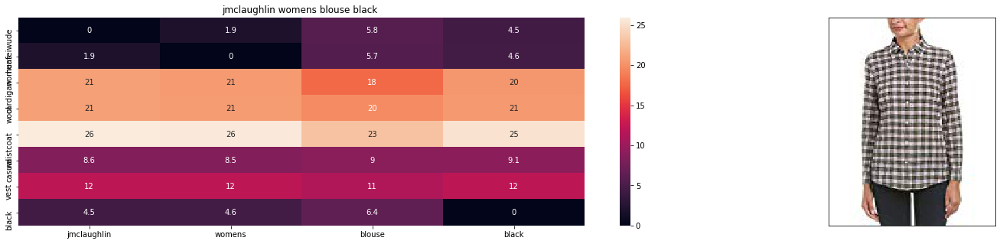

ASIN : B074KN55WS
Brand : J. McLaughlin
euclidean distance from input : 2.973740903882377


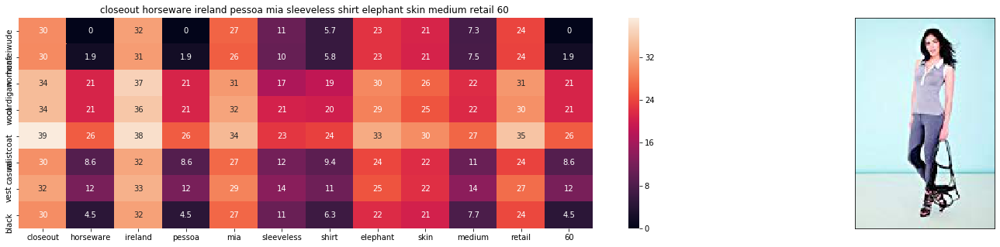

ASIN : B00D46ZH50
Brand : Pessoa by Horseware
euclidean distance from input : 3.003475746936314


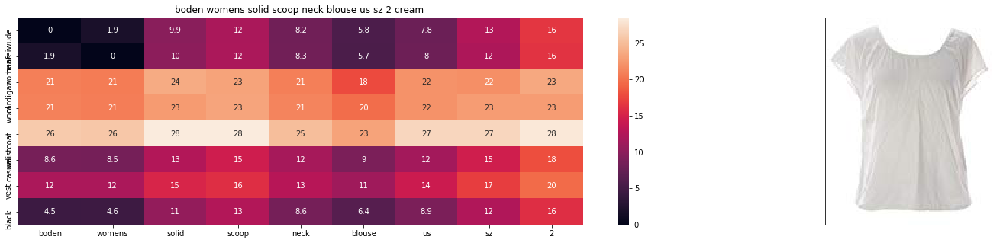

ASIN : B01H62TRVW
Brand : BODEN
euclidean distance from input : 3.019219335745431


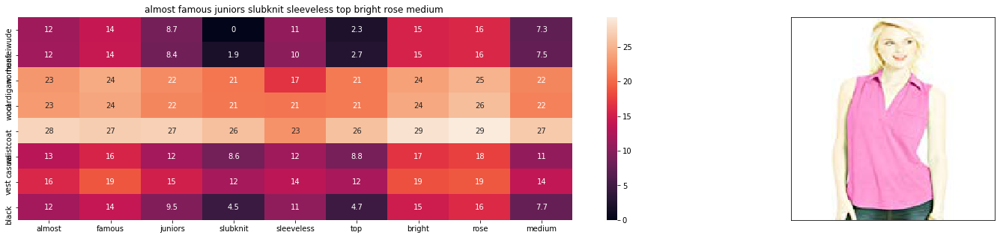

ASIN : B01CO4GLPM
Brand : Almost Famous
euclidean distance from input : 3.0315649488125227


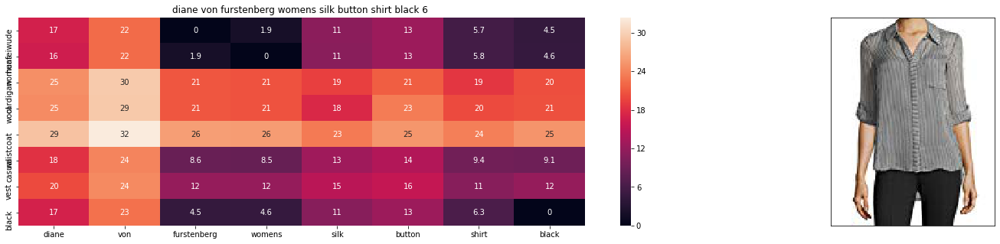

ASIN : B074NBGLK7
Brand : Diane von Furstenberg
euclidean distance from input : 3.0416819254958822


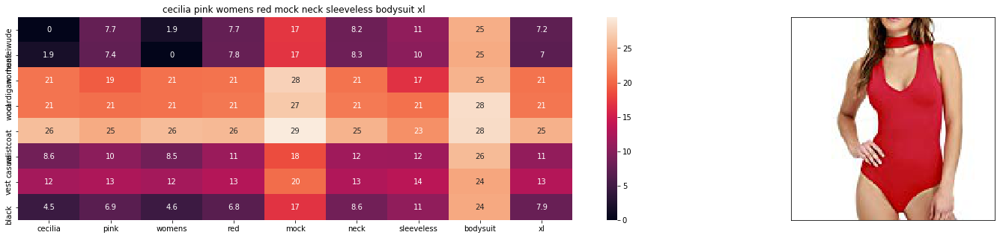

ASIN : B01H4NKEWE
Brand : Cecilia Pink
euclidean distance from input : 3.0589391106106367


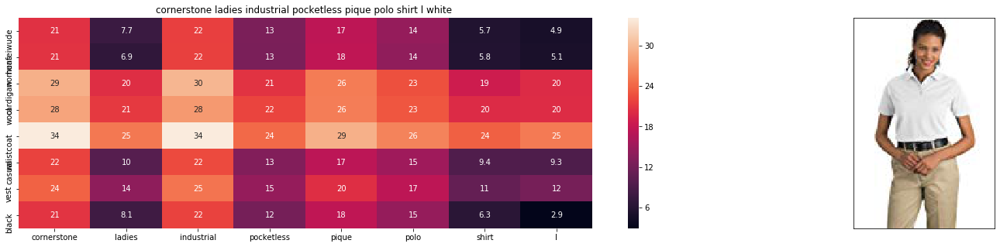

ASIN : B016WMNL0K
Brand : Cornerstone
euclidean distance from input : 3.0871352792713833


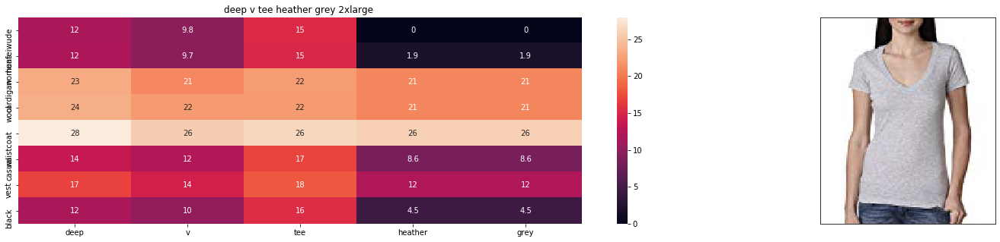

ASIN : B0085EX12M
Brand : Next Level Apparel
euclidean distance from input : 3.100606960760639


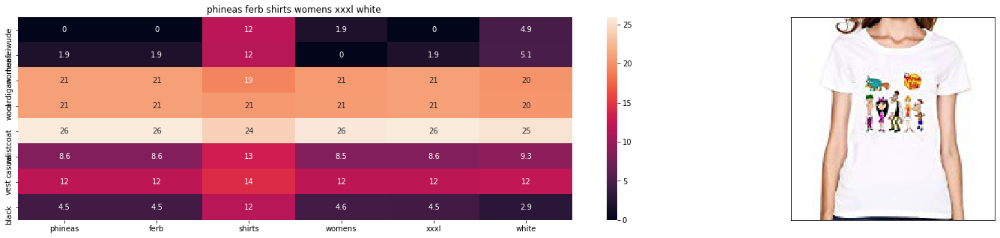

ASIN : B01KFGSUVE
Brand : MajinaHerrera
euclidean distance from input : 3.1106744399387223


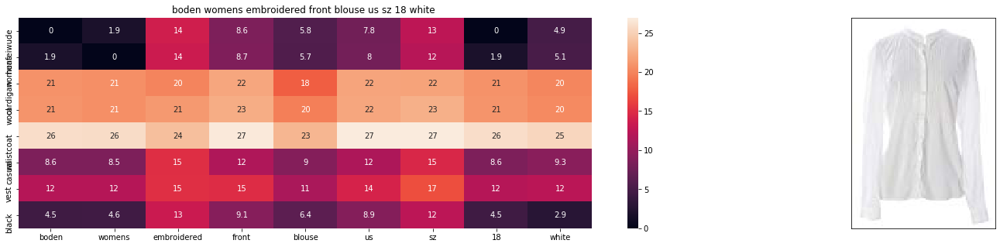

ASIN : B01H62UA4K
Brand : BODEN
euclidean distance from input : 3.1136522943046816


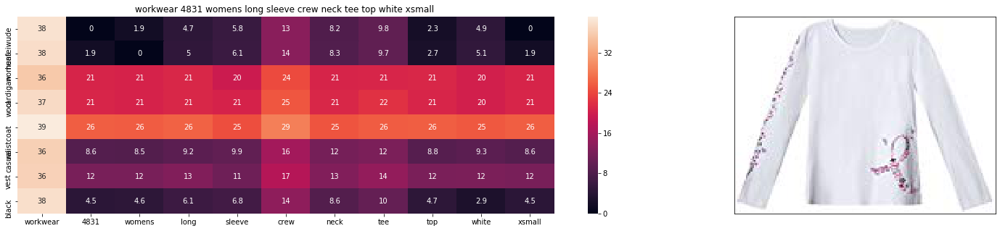

ASIN : B00BPDFA8S
Brand : WorkWear
euclidean distance from input : 3.1184858210484645


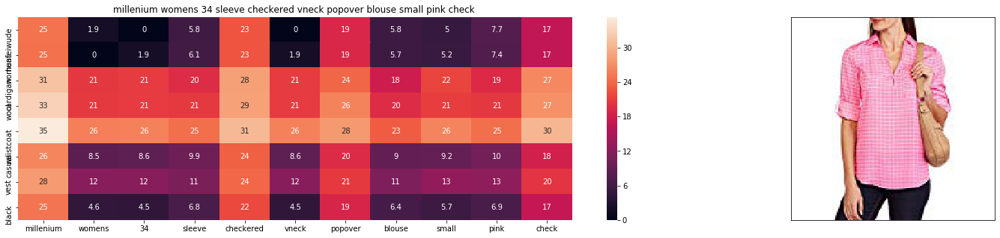

ASIN : B01N56V2HS
Brand : Millenium
euclidean distance from input : 3.1185506185297363


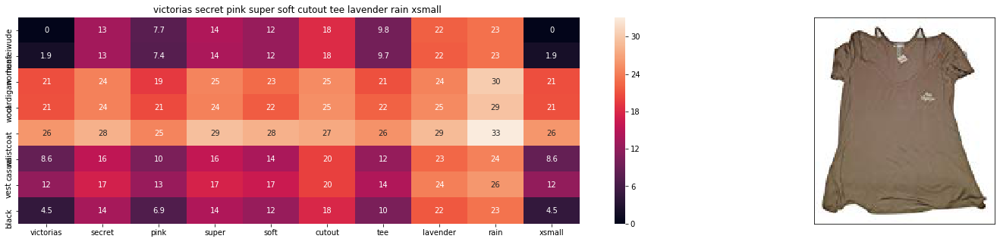

ASIN : B071HD2LDB
Brand : V.Secret
euclidean distance from input : 3.118612840440538


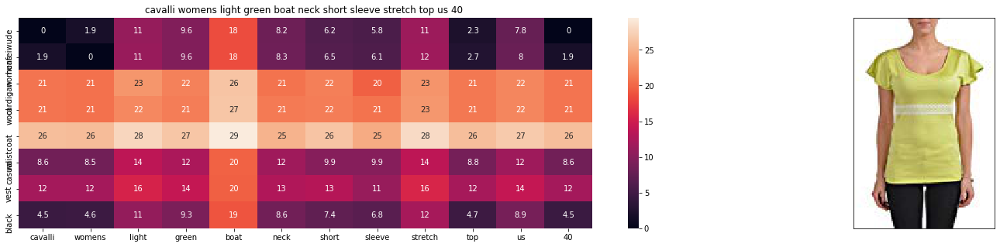

ASIN : B01A7SLV7U
Brand : Just Cavalli
euclidean distance from input : 3.1189567738510693


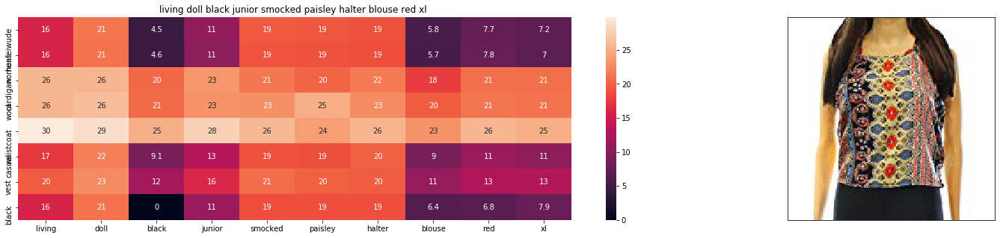

ASIN : B06Y5BJ1X5
Brand : Living Doll
euclidean distance from input : 3.1206749394509434


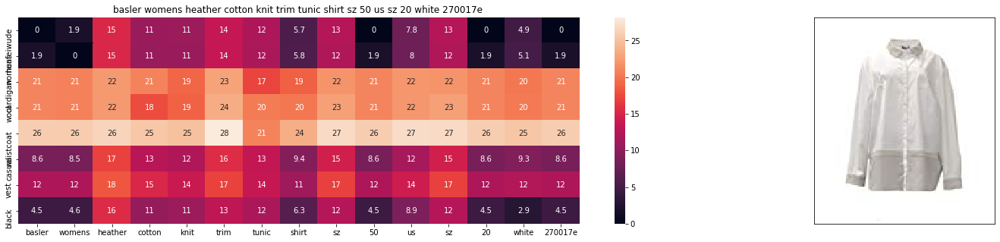

ASIN : B0741PLMD8
Brand : Basler
euclidean distance from input : 3.124002166681865


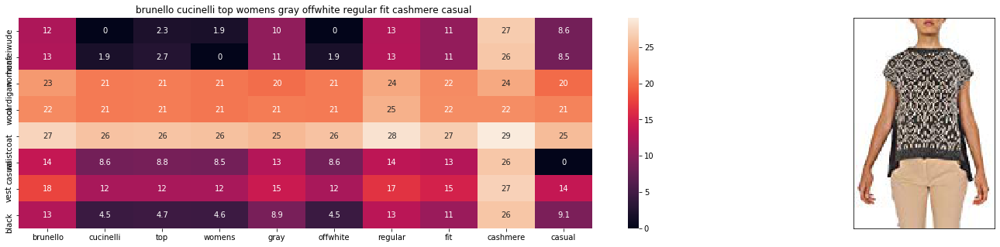

ASIN : B074Z714C3
Brand : Brunello Cucinelli
euclidean distance from input : 3.1242184109559514


In [65]:
idf_w2v_brand_img(12566, 20, 80, 5,5)

### Given more weightage to extra feature  
### W(extra) > W(idfw2v) = W(Image)

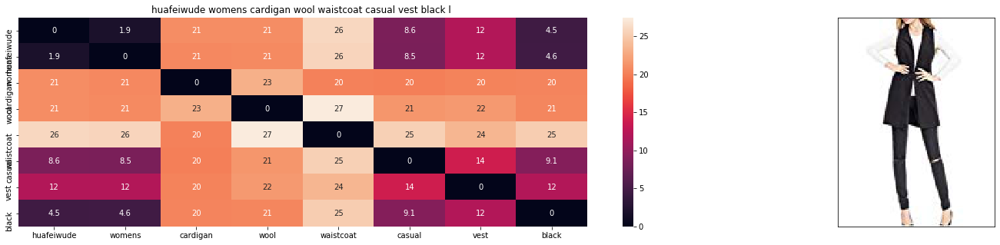

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 2.999178832396865e-07


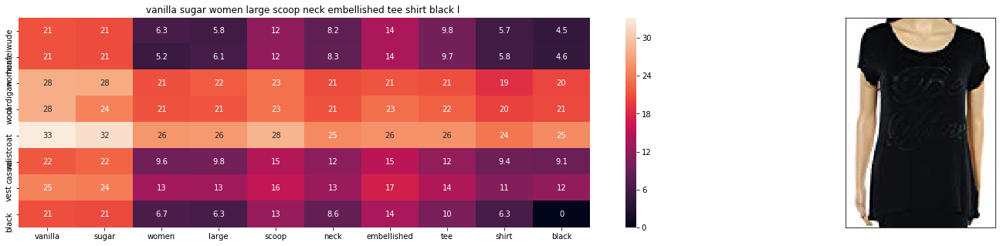

ASIN : B074MJVH4S
Brand : Vanilla Sugar
euclidean distance from input : 2.2015529267688363


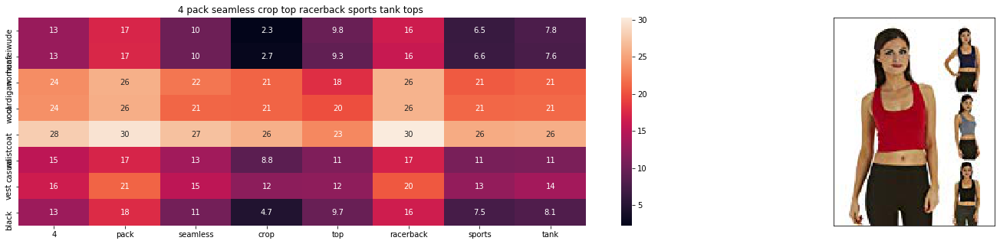

ASIN : B01N4O14R8
Brand : Free to Live
euclidean distance from input : 3.28606997595893


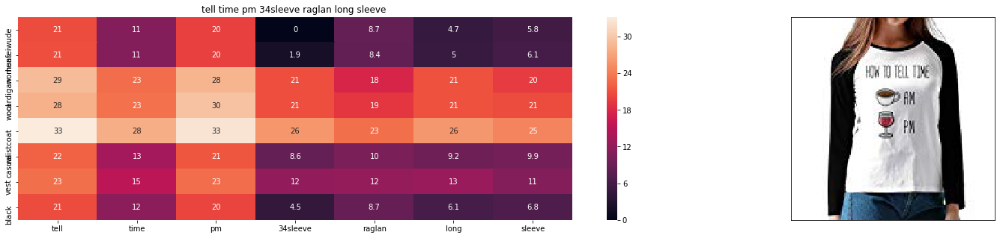

ASIN : B01MFBI9GM
Brand : PERI
euclidean distance from input : 3.2914553112453886


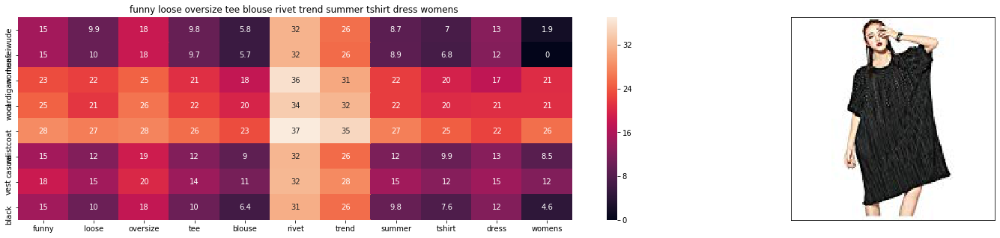

ASIN : B073S4F411
Brand : LTFT
euclidean distance from input : 3.344559507899814


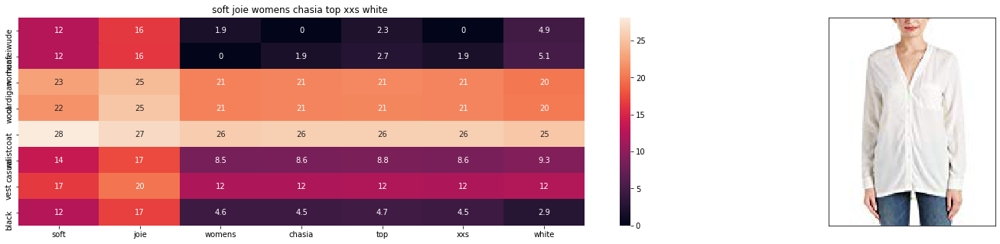

ASIN : B06XJ7K92W
Brand : Soft Joie
euclidean distance from input : 3.504111819797092


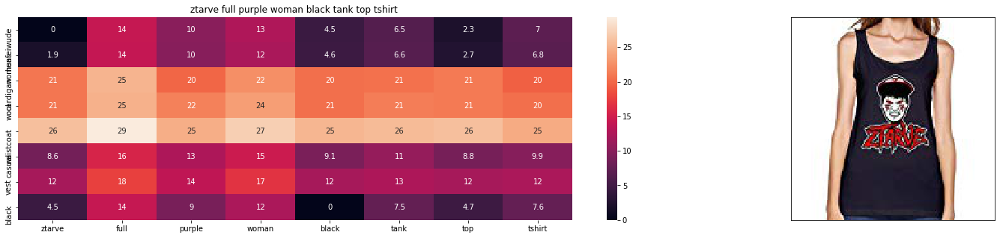

ASIN : B01JW85Z32
Brand : Boxinger
euclidean distance from input : 3.7571406682332356


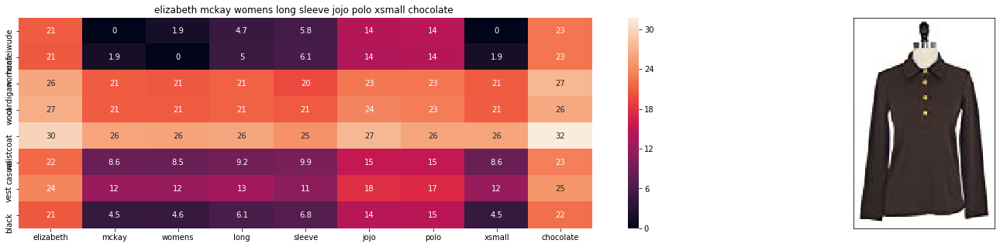

ASIN : B0184ROIQ2
Brand : Elizabeth McKay
euclidean distance from input : 4.353809323393371


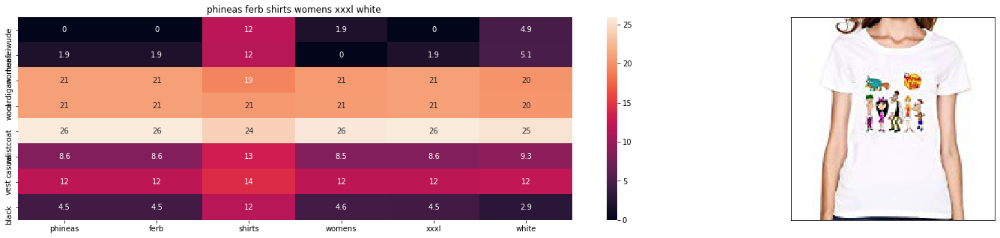

ASIN : B01KFGSUVE
Brand : MajinaHerrera
euclidean distance from input : 4.373575831601752


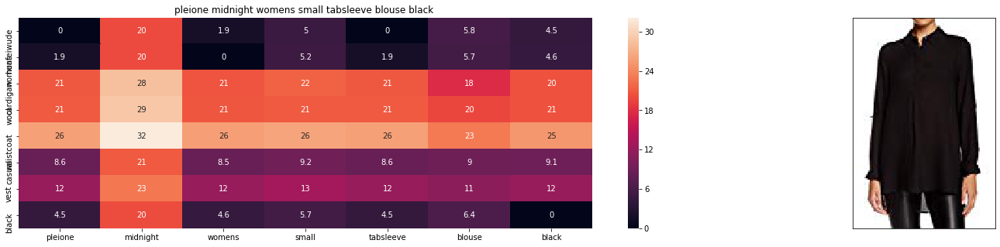

ASIN : B01KTKKB1S
Brand : Pleione
euclidean distance from input : 4.387831402146174


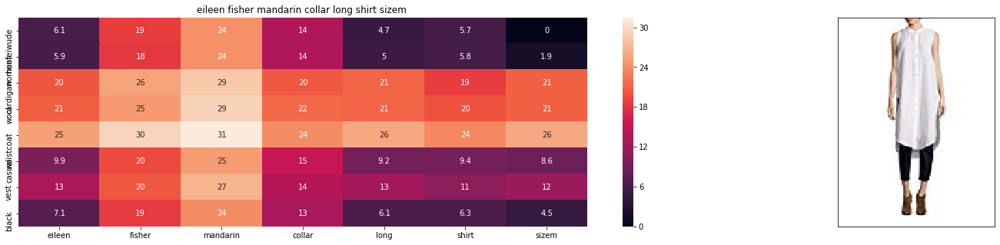

ASIN : B0746RVF6K
Brand : Eileen Fisher
euclidean distance from input : 4.512823810659911


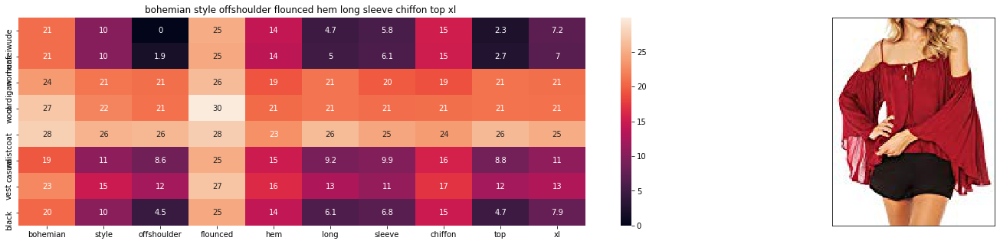

ASIN : B00N9RFYXE
Brand : HP-LEISURE
euclidean distance from input : 4.547029855837446


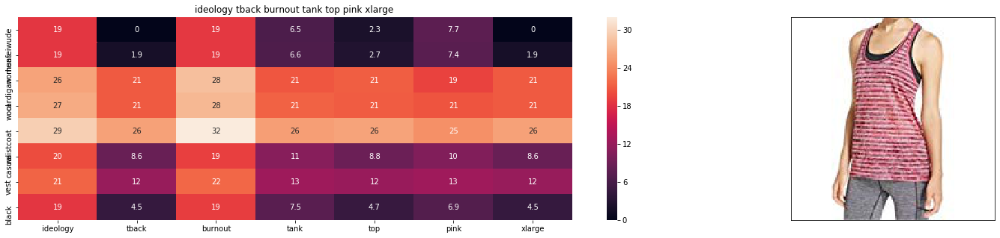

ASIN : B01HFGAFTW
Brand : Ideology
euclidean distance from input : 4.57622204470939


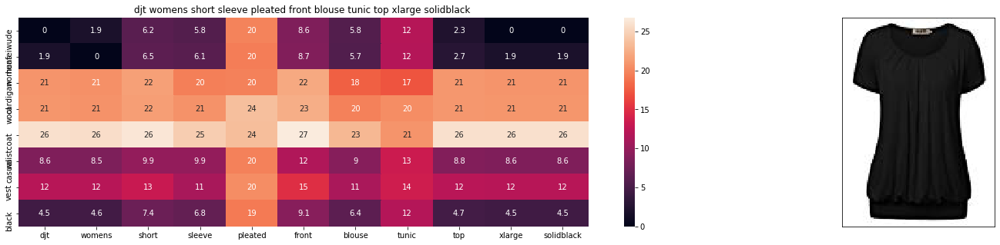

ASIN : B01FADAD0I
Brand : DJT
euclidean distance from input : 4.599940526303052


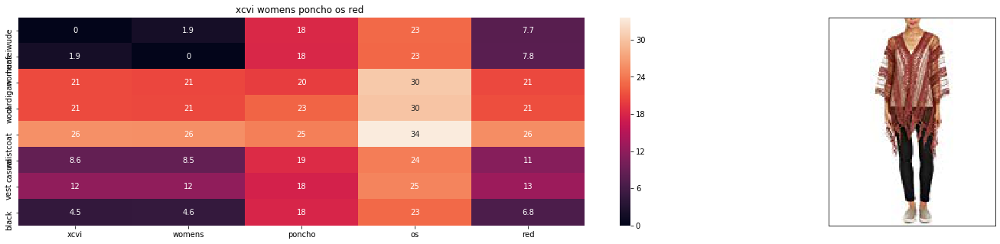

ASIN : B01M7U5BHH
Brand : XCVI
euclidean distance from input : 4.63425189768248


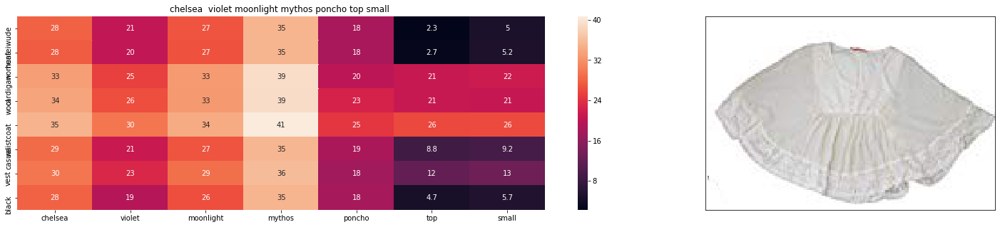

ASIN : B01EGAUECS
Brand : Chelsea & Violet
euclidean distance from input : 4.644892020837863


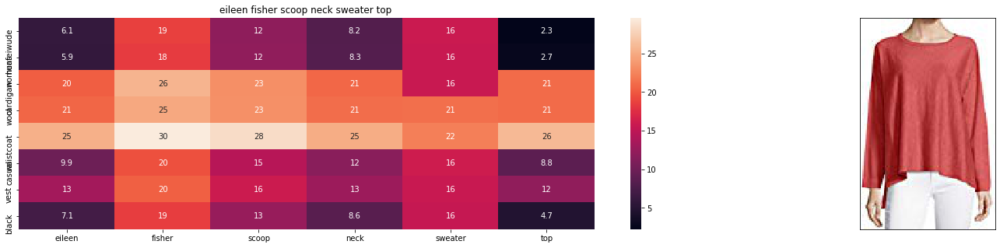

ASIN : B071PBRD93
Brand : Eileen Fisher
euclidean distance from input : 4.650729016280571


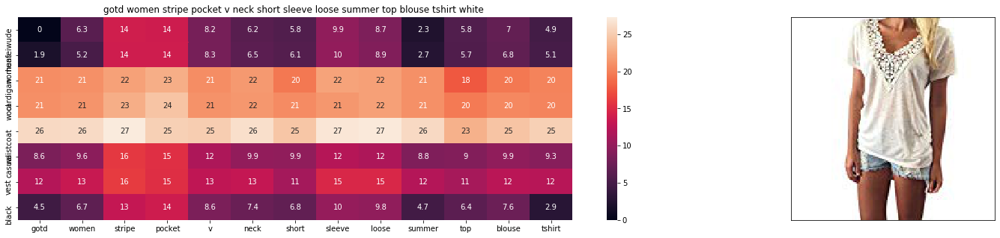

ASIN : B01J9BF3K2
Brand : Goodtrade8
euclidean distance from input : 4.651912552598184


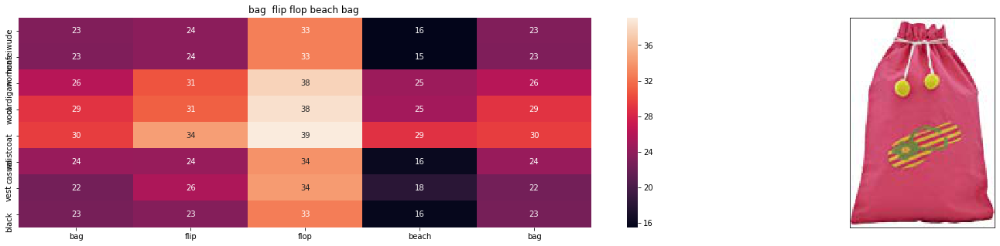

ASIN : B000OUE95S
Brand : Zazendi
euclidean distance from input : 4.675359414501057


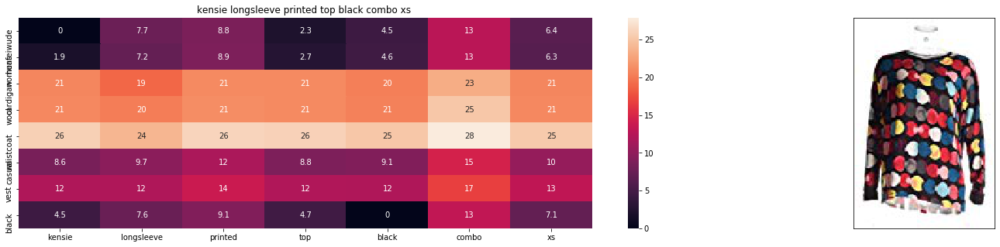

ASIN : B01M66PZKQ
Brand : kensie
euclidean distance from input : 4.6865341110262815


In [66]:
idf_w2v_brand_img(12566, 20, 5, 80,5)

### Given more weightage to Image feature  
###  W(Image) > W(idfw2v) = W(extra) 


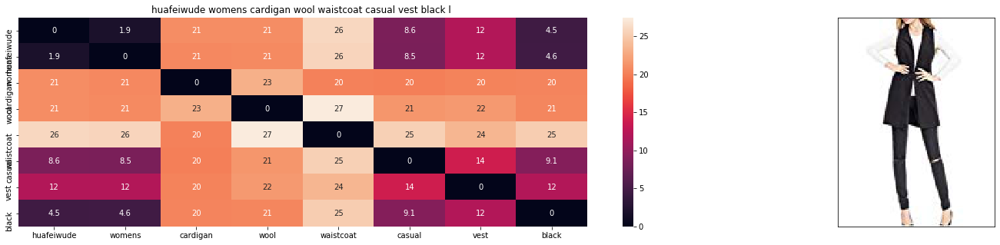

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 4.795581723252932e-06


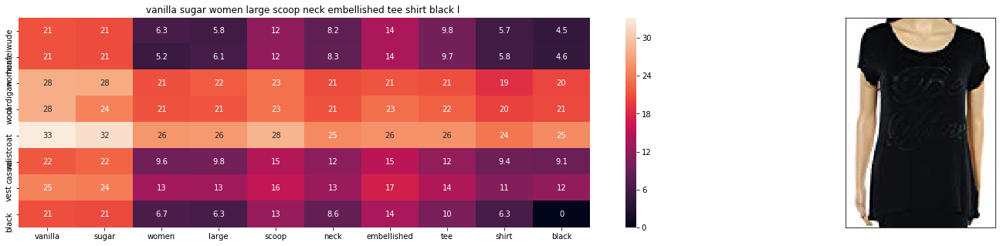

ASIN : B074MJVH4S
Brand : Vanilla Sugar
euclidean distance from input : 0.16031597011336127


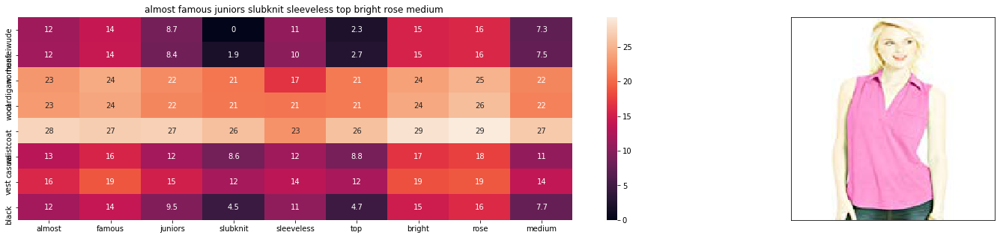

ASIN : B01CO4GLPM
Brand : Almost Famous
euclidean distance from input : 42.12631622737189


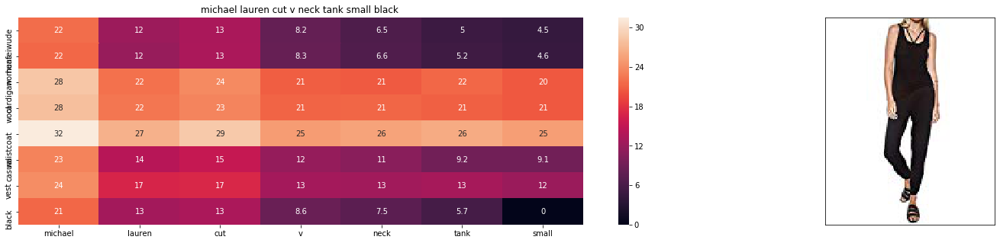

ASIN : B074W37H4P
Brand : Michael Lauren
euclidean distance from input : 42.36671413319682


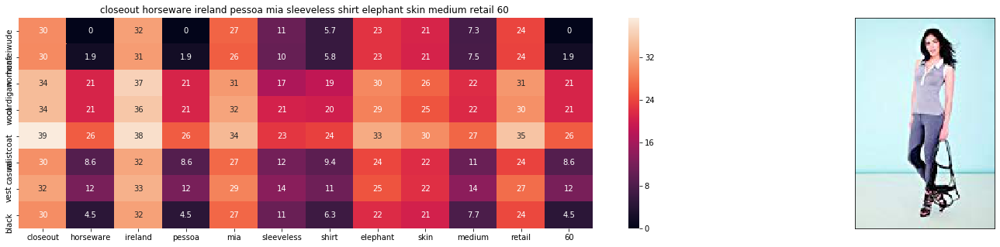

ASIN : B00D46ZH50
Brand : Pessoa by Horseware
euclidean distance from input : 42.78275640947293


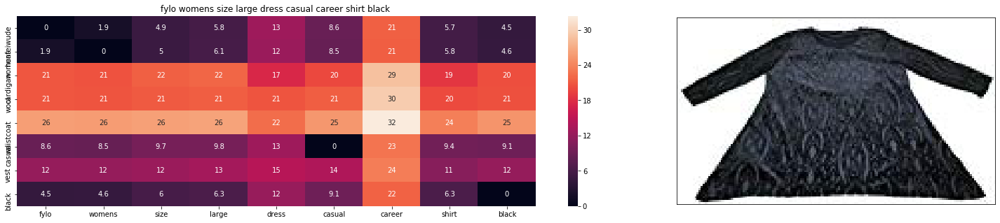

ASIN : B06XQ89MB3
Brand : Fylo
euclidean distance from input : 43.22729810956186


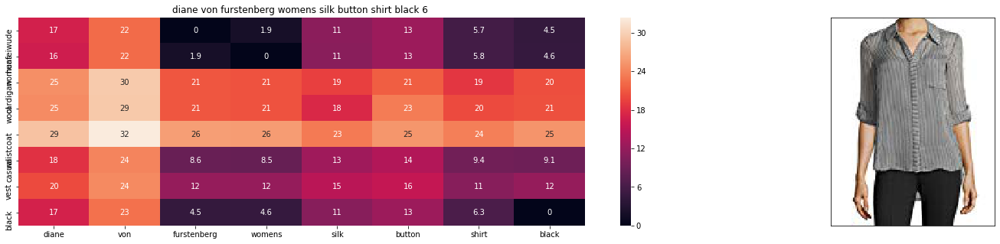

ASIN : B074NBGLK7
Brand : Diane von Furstenberg
euclidean distance from input : 43.24182542169136


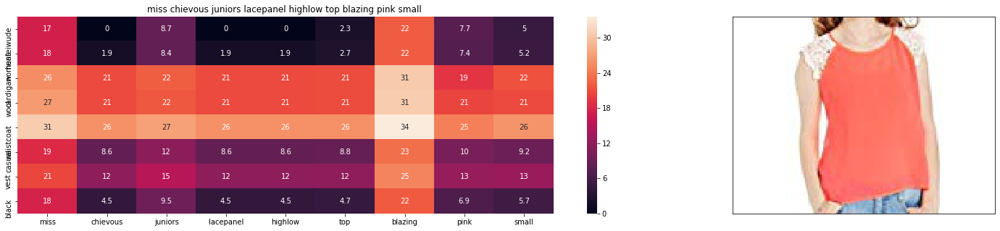

ASIN : B01JKT0QQO
Brand : Miss Chievous
euclidean distance from input : 43.307833576242544


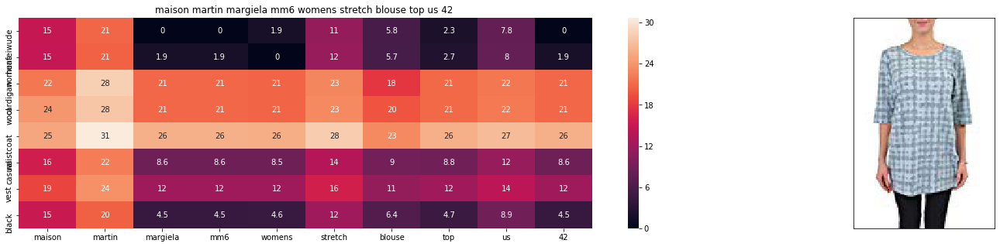

ASIN : B0175E4K2C
Brand : Maison Martin Margiela
euclidean distance from input : 43.83699086776086


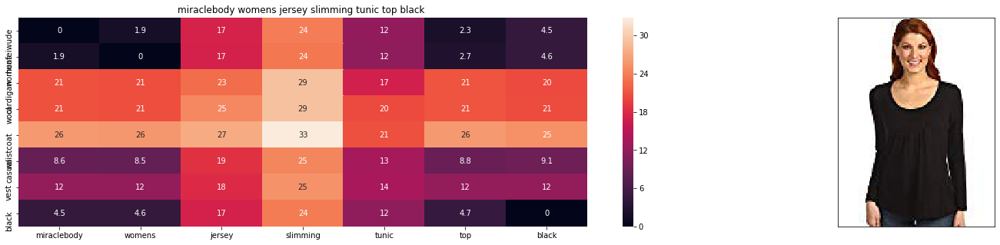

ASIN : B0059GPDDE
Brand : Miraclebody by Miraclesuit
euclidean distance from input : 43.842209217323614


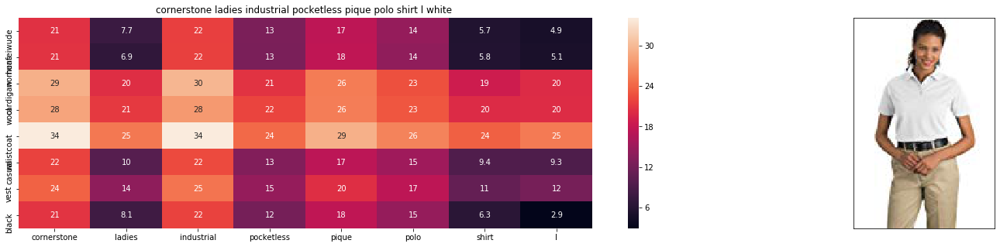

ASIN : B016WMNL0K
Brand : Cornerstone
euclidean distance from input : 44.12130892683405


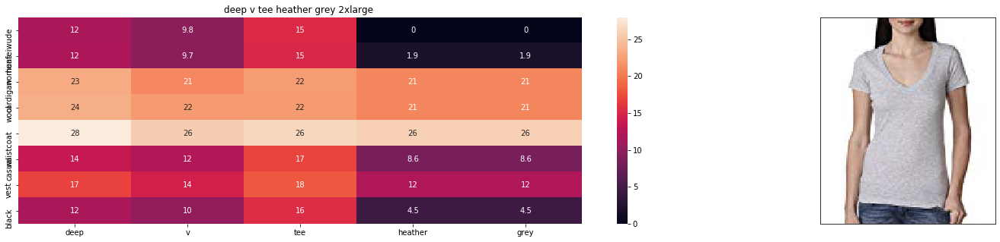

ASIN : B0085EX12M
Brand : Next Level Apparel
euclidean distance from input : 44.18462598592747


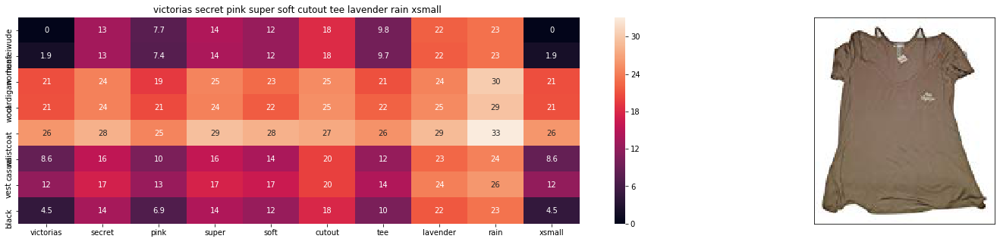

ASIN : B071HD2LDB
Brand : V.Secret
euclidean distance from input : 44.329742664761014


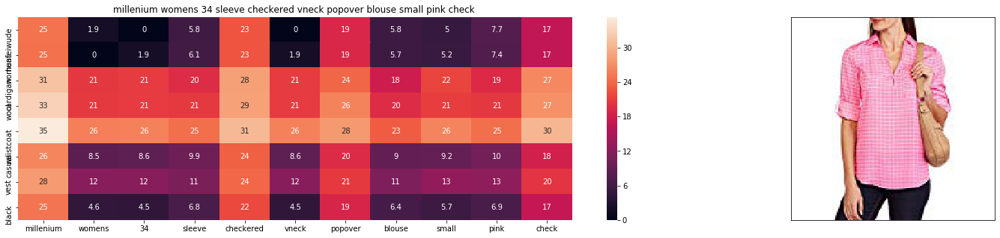

ASIN : B01N56V2HS
Brand : Millenium
euclidean distance from input : 44.471724510233024


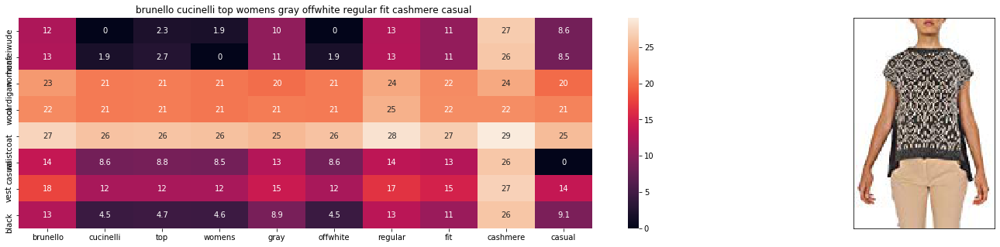

ASIN : B074Z714C3
Brand : Brunello Cucinelli
euclidean distance from input : 44.56240918905247


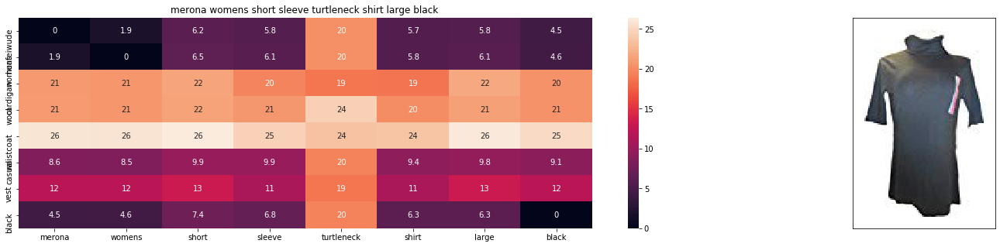

ASIN : B07114YG2N
Brand : Merona
euclidean distance from input : 44.627598377161604


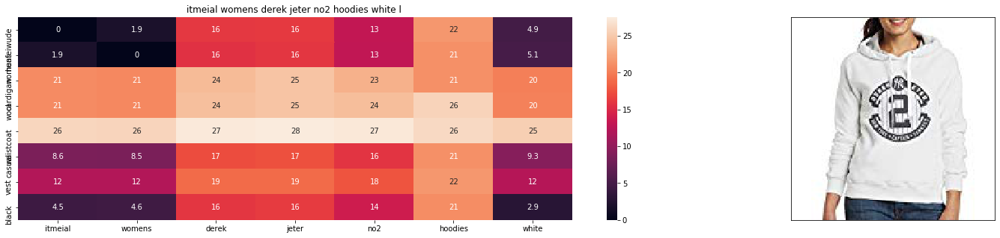

ASIN : B01MF4OF2B
Brand : ITMEIAL
euclidean distance from input : 44.78913665347629


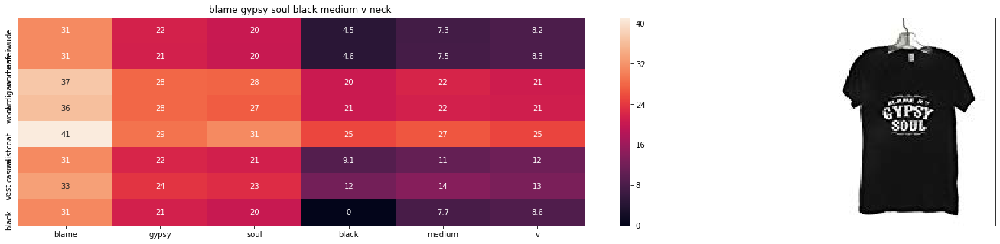

ASIN : B01BLQ50E2
Brand : Camp Ojai
euclidean distance from input : 44.79472476111518


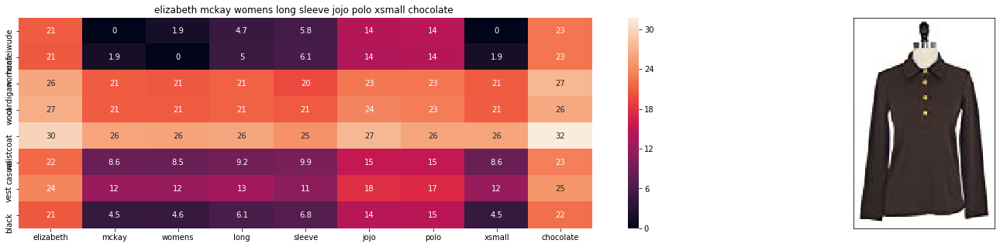

ASIN : B0184ROIQ2
Brand : Elizabeth McKay
euclidean distance from input : 44.81794504364847


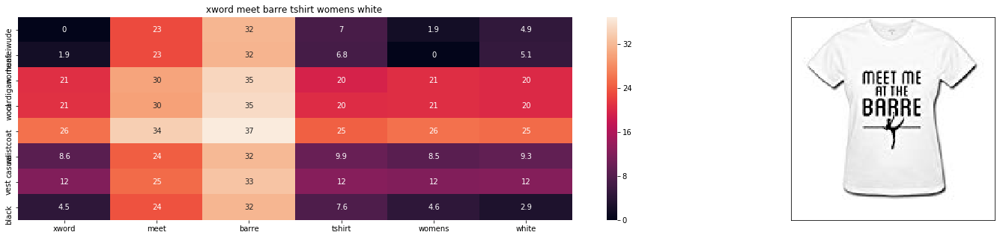

ASIN : B01HGDMS1W
Brand : Xword
euclidean distance from input : 44.89511505374648


In [67]:
idf_w2v_brand_img(12566, 20, 5, 5,80)

###  W(Image) >  W(extra) > W(idfw2v) 

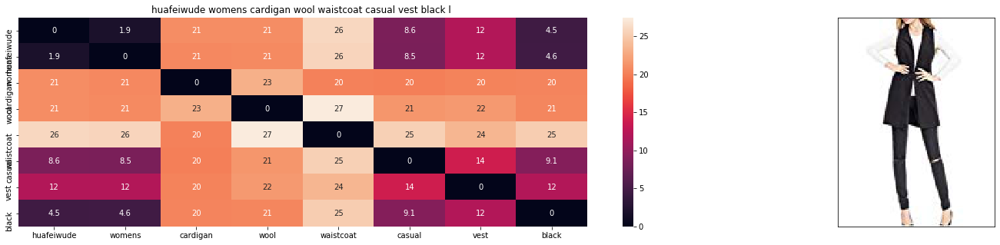

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 2.698019185724358e-06


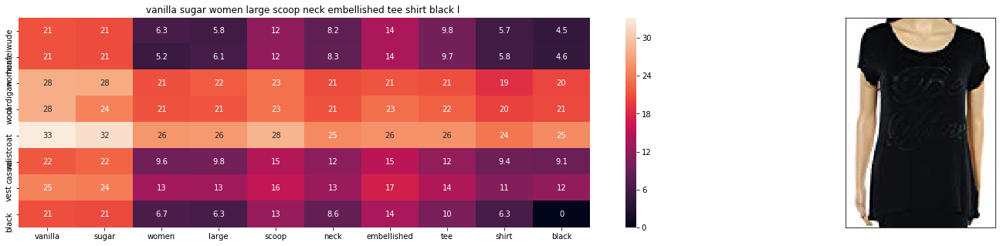

ASIN : B074MJVH4S
Brand : Vanilla Sugar
euclidean distance from input : 0.8891845120779628


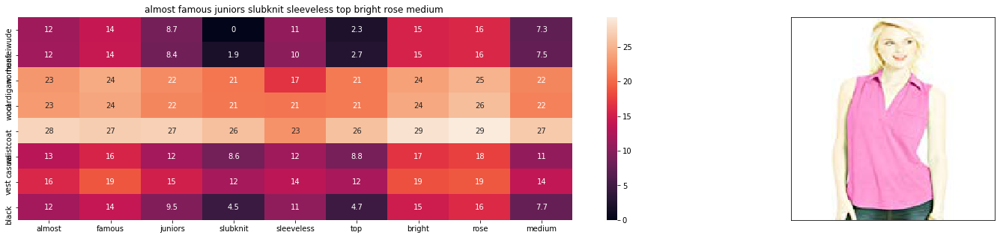

ASIN : B01CO4GLPM
Brand : Almost Famous
euclidean distance from input : 24.68710661245623


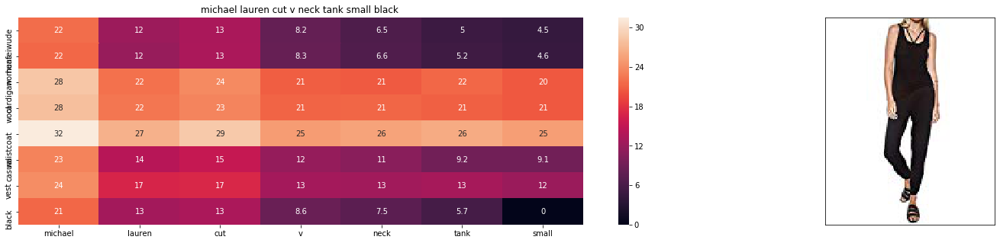

ASIN : B074W37H4P
Brand : Michael Lauren
euclidean distance from input : 24.824421676240878


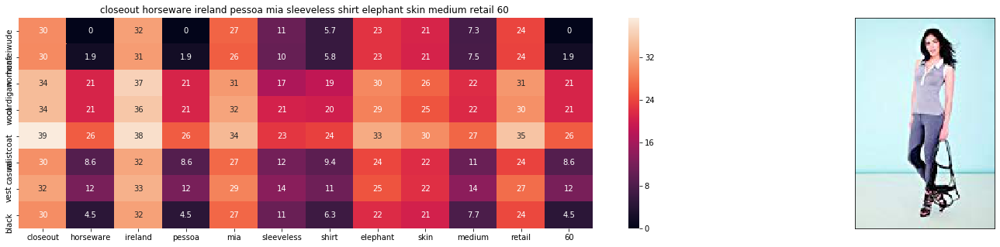

ASIN : B00D46ZH50
Brand : Pessoa by Horseware
euclidean distance from input : 24.893864417632695


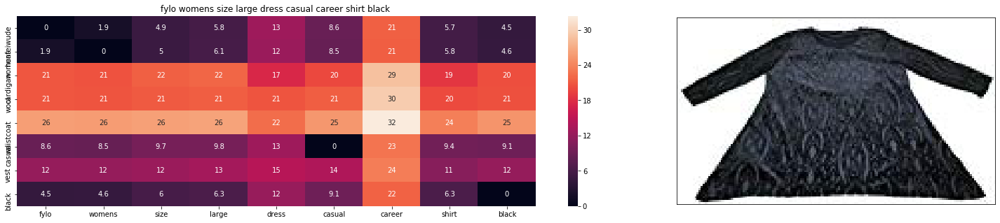

ASIN : B06XQ89MB3
Brand : Fylo
euclidean distance from input : 25.064966612044916


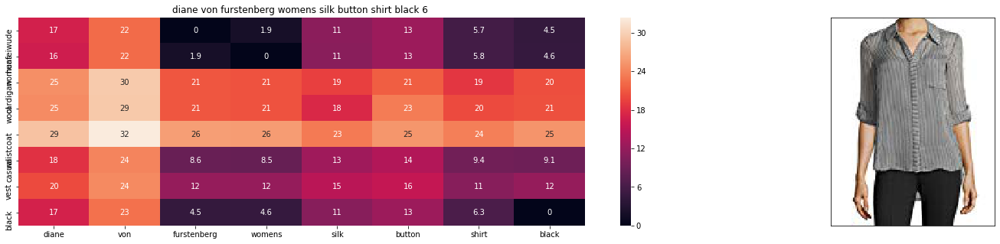

ASIN : B074NBGLK7
Brand : Diane von Furstenberg
euclidean distance from input : 25.20727507297448


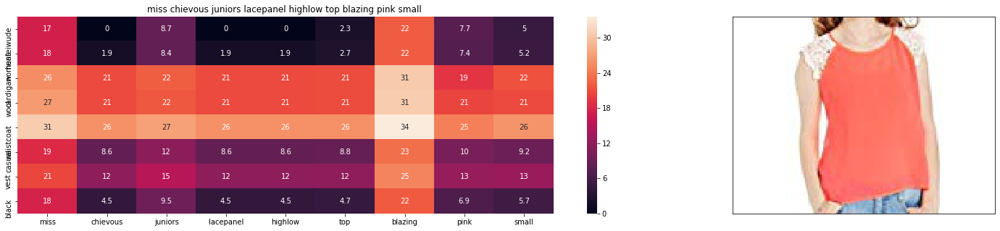

ASIN : B01JKT0QQO
Brand : Miss Chievous
euclidean distance from input : 25.269809627773878


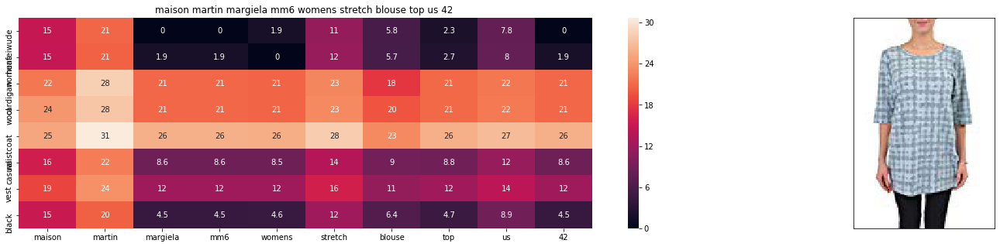

ASIN : B0175E4K2C
Brand : Maison Martin Margiela
euclidean distance from input : 25.55837810063612


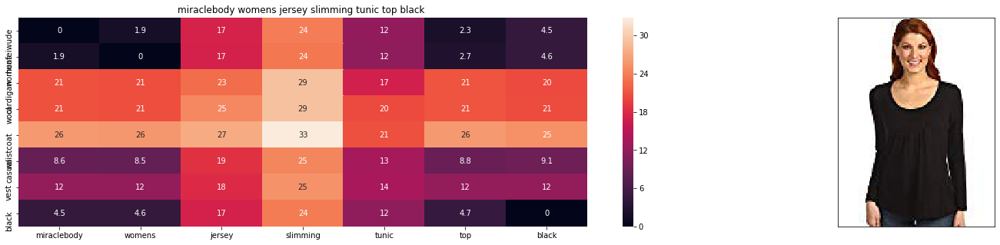

ASIN : B0059GPDDE
Brand : Miraclebody by Miraclesuit
euclidean distance from input : 25.57403314932437


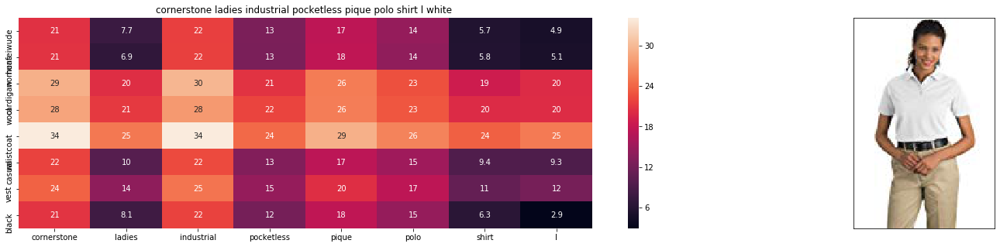

ASIN : B016WMNL0K
Brand : Cornerstone
euclidean distance from input : 25.64680020864832


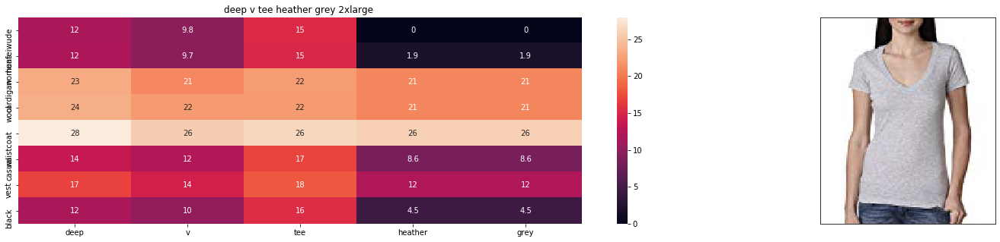

ASIN : B0085EX12M
Brand : Next Level Apparel
euclidean distance from input : 25.737599373104686


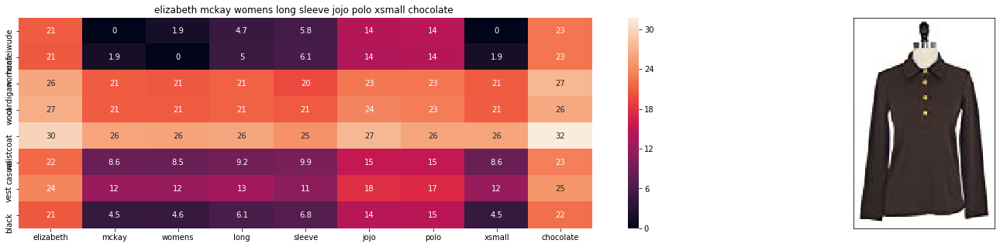

ASIN : B0184ROIQ2
Brand : Elizabeth McKay
euclidean distance from input : 25.7829806431444


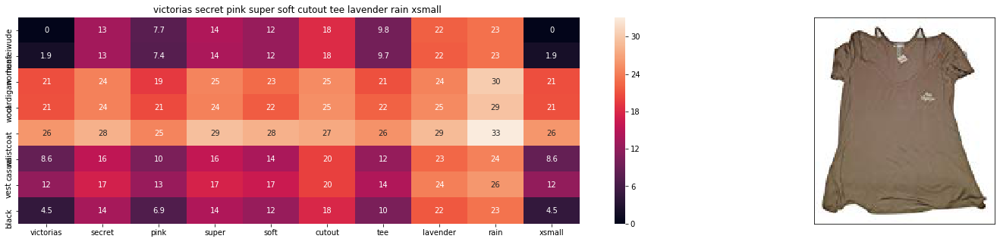

ASIN : B071HD2LDB
Brand : V.Secret
euclidean distance from input : 25.871057828267414


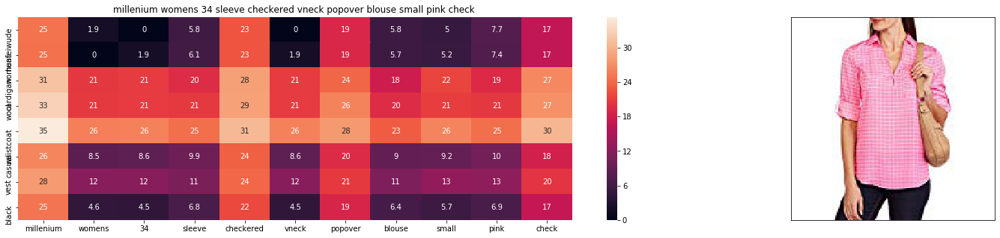

ASIN : B01N56V2HS
Brand : Millenium
euclidean distance from input : 25.899092293026563


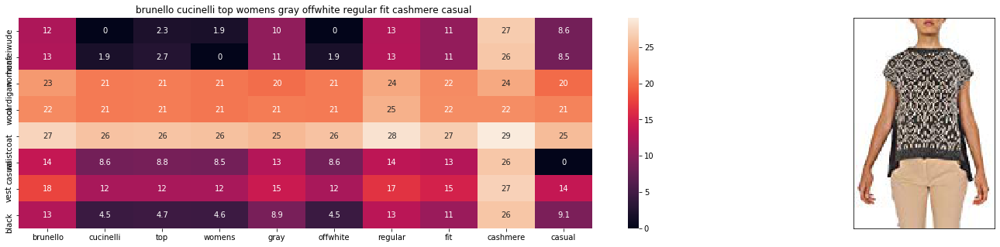

ASIN : B074Z714C3
Brand : Brunello Cucinelli
euclidean distance from input : 25.950103442115104


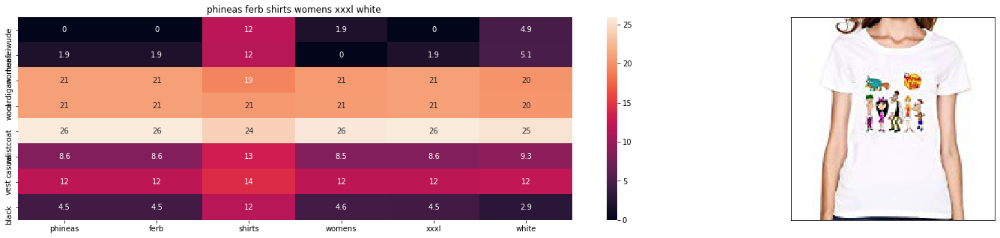

ASIN : B01KFGSUVE
Brand : MajinaHerrera
euclidean distance from input : 26.010936580529957


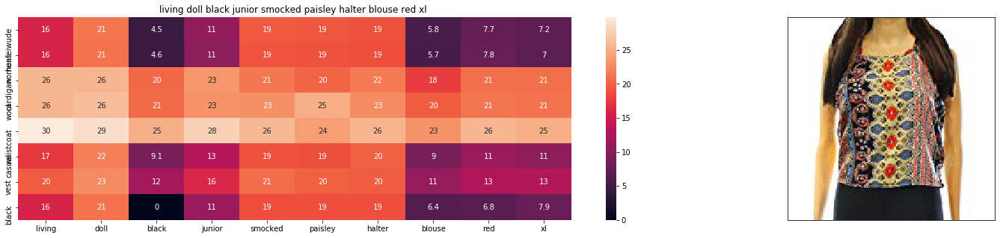

ASIN : B06Y5BJ1X5
Brand : Living Doll
euclidean distance from input : 26.016938723111096


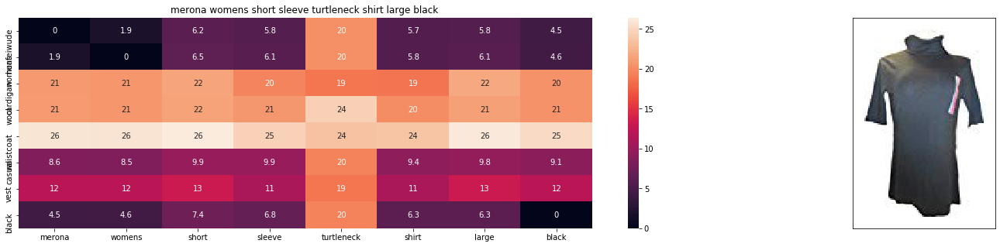

ASIN : B07114YG2N
Brand : Merona
euclidean distance from input : 26.017391785542443


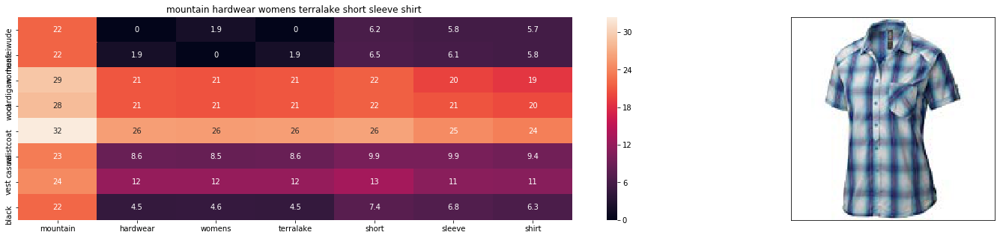

ASIN : B00L1R7D06
Brand : Mountain Hardwear
euclidean distance from input : 26.070113177905753


In [68]:
idf_w2v_brand_img(12566, 20, 20, 40,60)

###  W(Image) >  W(idfw2v) >  W(extra)

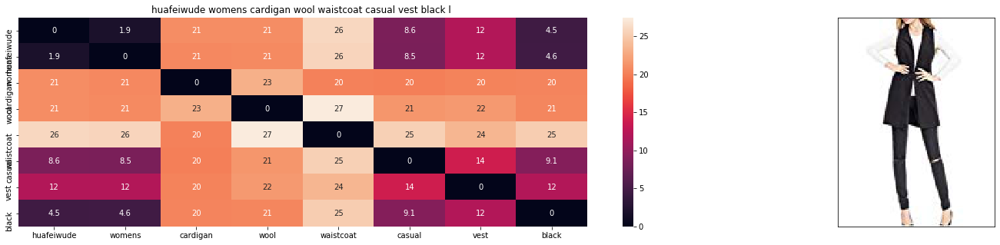

ASIN : B01MT96PXZ
Brand : Huafeiwude
euclidean distance from input : 2.698640067440768e-06


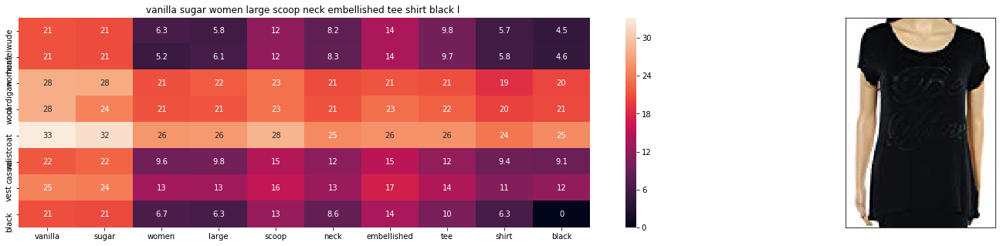

ASIN : B074MJVH4S
Brand : Vanilla Sugar
euclidean distance from input : 0.5536214553660326


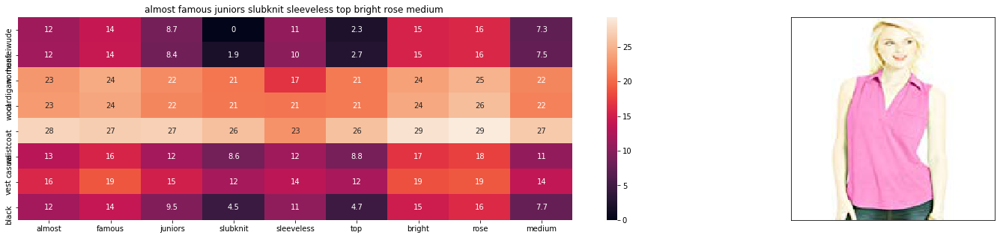

ASIN : B01CO4GLPM
Brand : Almost Famous
euclidean distance from input : 24.204101413057444


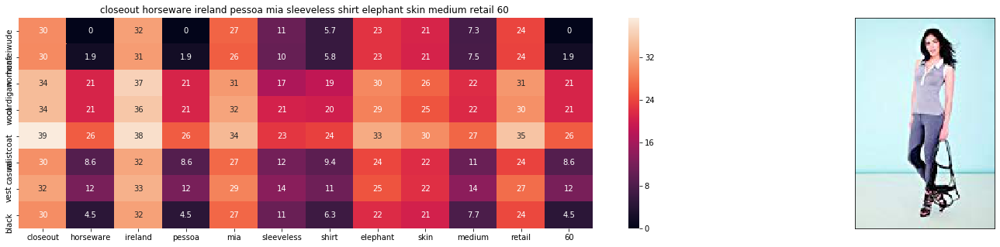

ASIN : B00D46ZH50
Brand : Pessoa by Horseware
euclidean distance from input : 24.489000722050807


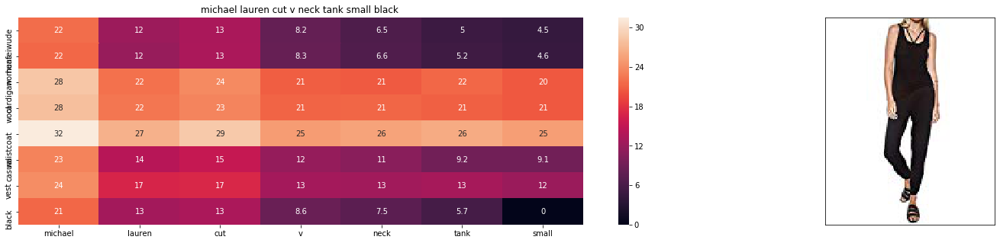

ASIN : B074W37H4P
Brand : Michael Lauren
euclidean distance from input : 24.523755359770117


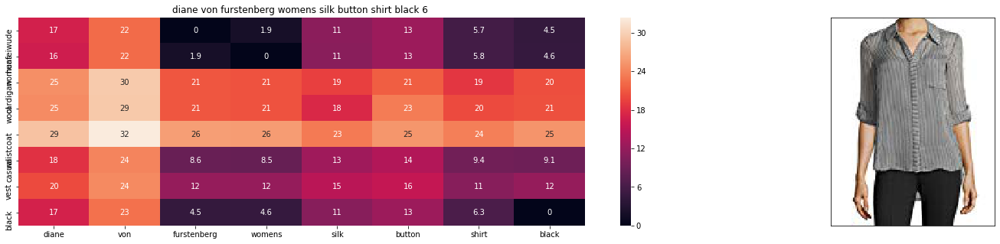

ASIN : B074NBGLK7
Brand : Diane von Furstenberg
euclidean distance from input : 24.771965408445656


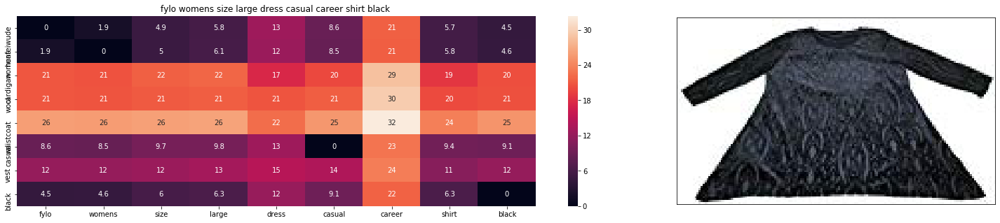

ASIN : B06XQ89MB3
Brand : Fylo
euclidean distance from input : 24.783528060209722


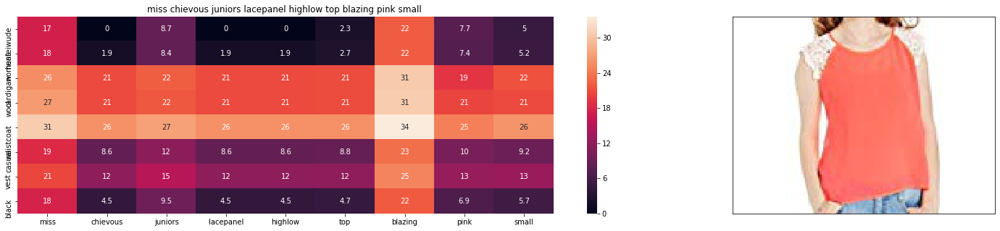

ASIN : B01JKT0QQO
Brand : Miss Chievous
euclidean distance from input : 24.865768242002783


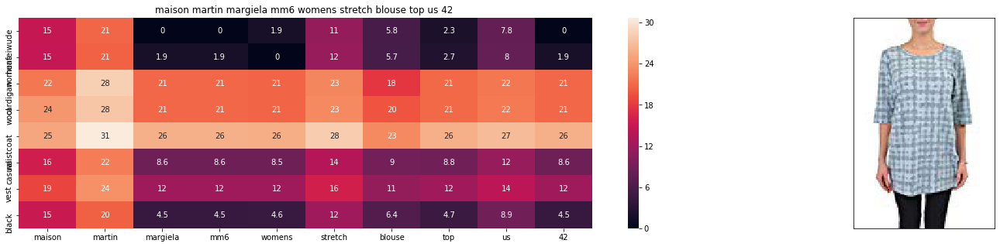

ASIN : B0175E4K2C
Brand : Maison Martin Margiela
euclidean distance from input : 25.143159500878312


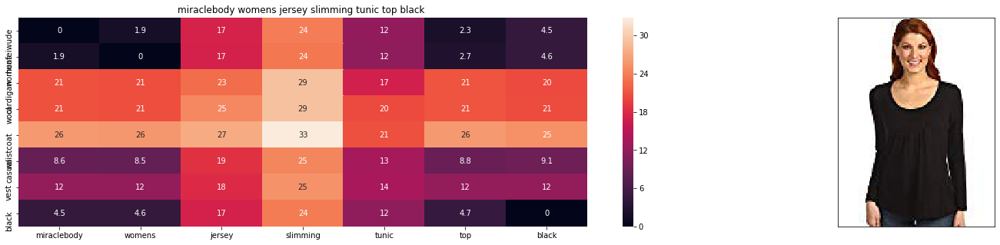

ASIN : B0059GPDDE
Brand : Miraclebody by Miraclesuit
euclidean distance from input : 25.174469598254817


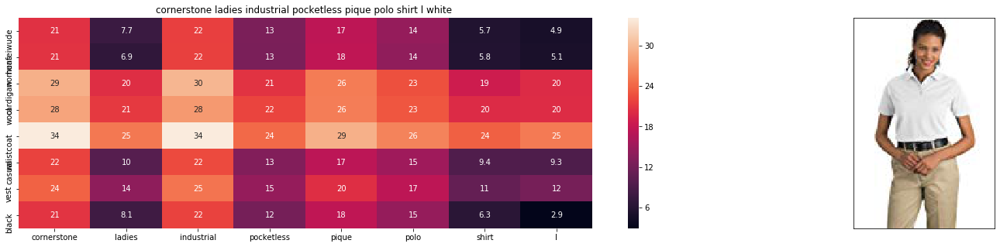

ASIN : B016WMNL0K
Brand : Cornerstone
euclidean distance from input : 25.24193651306643


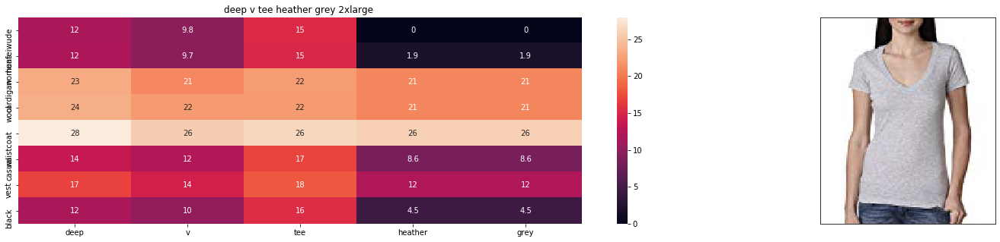

ASIN : B0085EX12M
Brand : Next Level Apparel
euclidean distance from input : 25.302289708575863


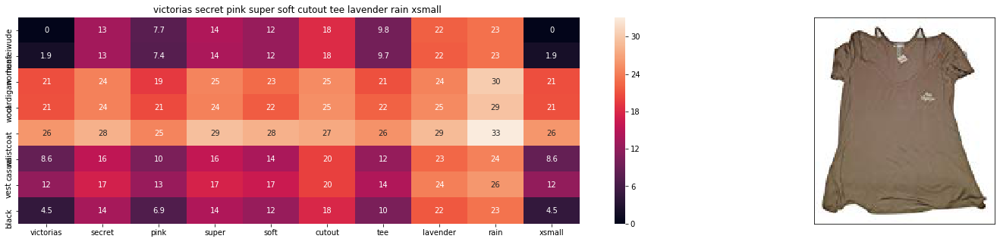

ASIN : B071HD2LDB
Brand : V.Secret
euclidean distance from input : 25.407152684529624


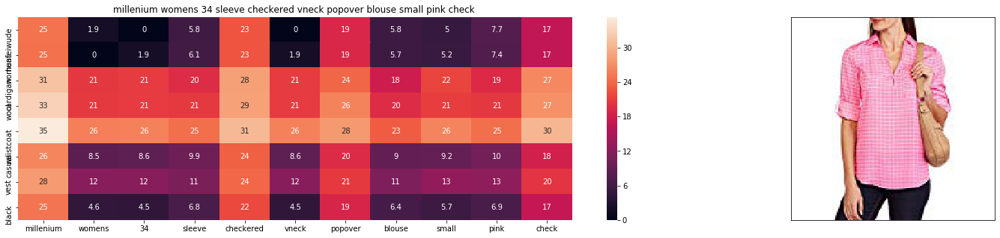

ASIN : B01N56V2HS
Brand : Millenium
euclidean distance from input : 25.463782628497736


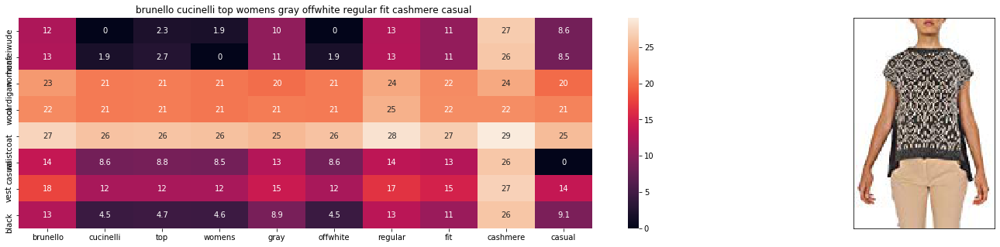

ASIN : B074Z714C3
Brand : Brunello Cucinelli
euclidean distance from input : 25.51479377758628


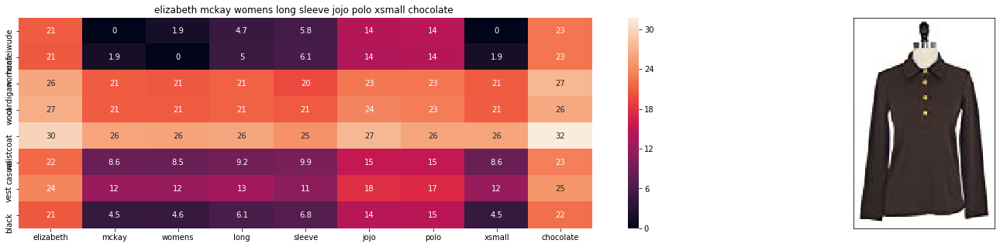

ASIN : B0184ROIQ2
Brand : Elizabeth McKay
euclidean distance from input : 25.55542904656686


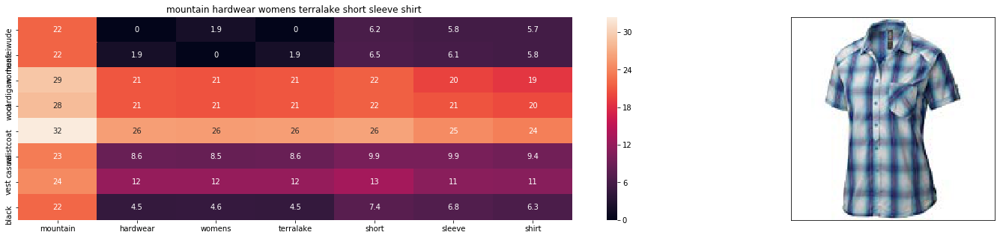

ASIN : B00L1R7D06
Brand : Mountain Hardwear
euclidean distance from input : 25.63276411173755


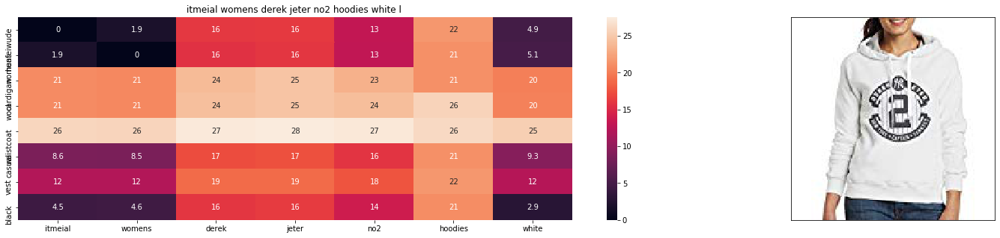

ASIN : B01MF4OF2B
Brand : ITMEIAL
euclidean distance from input : 25.665561294555665


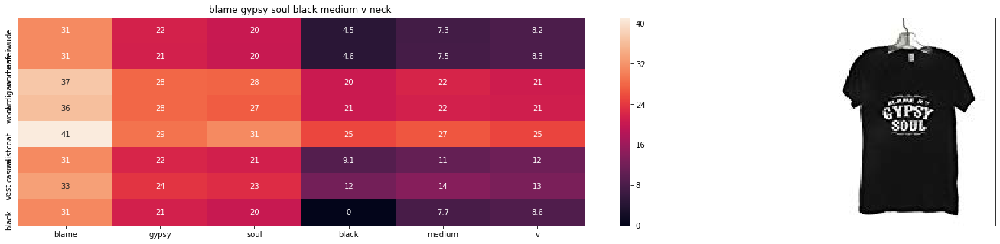

ASIN : B01BLQ50E2
Brand : Camp Ojai
euclidean distance from input : 25.66870460510254


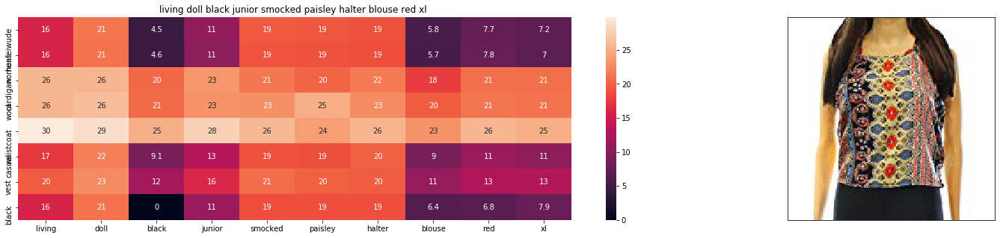

ASIN : B06Y5BJ1X5
Brand : Living Doll
euclidean distance from input : 25.680355583123337


In [69]:
idf_w2v_brand_img(12566, 20, 40, 20,60)